In [1]:
import pandas as pd
import numpy as np
import os


path = "/Users/irtg/同步空间/Pricing_Kernel/EPK/matlab_code_for_BTC/SVI/"
os.chdir(path)

data_path = os.path.join(path, "data", "processed","20172022_processed_1_3_4.csv")

# Load the dataset
df = pd.read_csv(data_path)

# Convert 'date' to datetime type for easy grouping
df['date'] = pd.to_datetime(df['date'])

# Data cleaning: Drop rows with IV <= 0 or tau < 3
df = df[(df['IV'] > 0) & (df['tau'] >= 3)]

# Filter out rows where 'quantity' is zero before applying aggregation
df = df[df['quantity'] > 0]

# Calculate the moneyness: moneyness = K/S - 1
df['moneyness'] = df['K'] / df['BTC_price'] - 1


print("The size of df is:", df.shape)   
print("The first 5 rows of df are:")
print(df.head())

The size of df is: (5384537, 13)
The first 5 rows of df are:
        date  BTC_price  option_price  tau     K     IV  quantity putcall  \
0 2017-07-01    2485.09        771.12   90  1800  75.99      1.00       C   
1 2017-07-01    2497.86        625.46   90  2000  71.64      1.00       C   
2 2017-07-01    2436.94        326.55   27  2300  98.15      0.01       C   
3 2017-07-01    2464.55        330.25   27  2300  92.33      1.00       C   
4 2017-07-01    2433.63        326.11   27  2300  98.67      0.20       C   

      volume  moneyness  volume_optionprice tau_range moneyness_range  
0  2485.0900  -0.275680            771.1200       >33            <0d9  
1  2497.8600  -0.199315            625.4600       >33            <0d9  
2    24.3694  -0.056193              3.2655     27_33        0d9_0d97  
3  2464.5500  -0.066767            330.2500     27_33        0d9_0d97  
4   486.7260  -0.054910             65.2220     27_33        0d9_0d97  


/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/2006560800.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV/100 # Convert IV to percentage


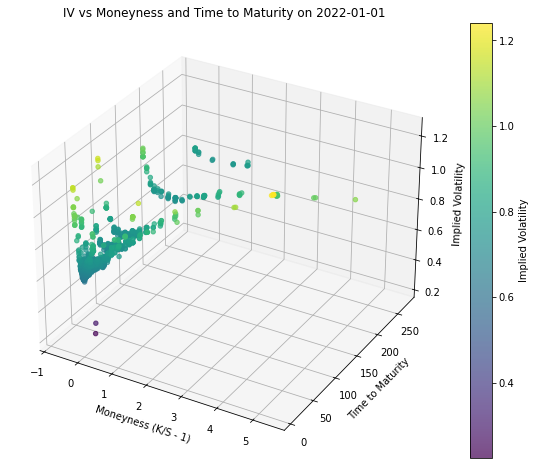

In [3]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def plot_iv_3d(df, date):
    # Filter data for the specified date
    df_filtered = df[df['date'] == pd.to_datetime(date)]
    df_filtered.IV = df_filtered.IV/100 # Convert IV to percentage
    
    # Check if there is data for the given date
    if df_filtered.empty:
        print(f"No data available for {date}.")
        return
    
    # Plot 3D plot
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(df_filtered['moneyness'], df_filtered['tau'], df_filtered['IV'], c=df_filtered['IV'], cmap='viridis', alpha=0.7)
    
    ax.set_xlabel('Moneyness (K/S - 1)')
    ax.set_ylabel('Time to Maturity')
    ax.set_zlabel('Implied Volatility')
    ax.set_title(f'IV vs Moneyness and Time to Maturity on {date}')
    
    fig.colorbar(scatter, ax=ax, label='Implied Volatility')
    plt.show()

plot_iv_3d(df, "2022-01-01")

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4248696012.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV/100 # Convert IV to percentage


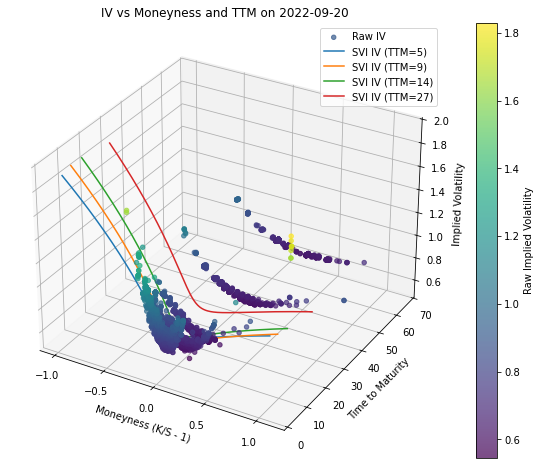

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import numpy as np


def load_svi_iv(file_path, date):
    df_svi = pd.read_csv(file_path)
    df_svi['Date'] = pd.to_datetime(df_svi['Date'])
    svi_row = df_svi[df_svi['Date'] == pd.to_datetime(date)]
    if svi_row.empty:
        return None
    svi_row = svi_row.drop(columns=['Date']).values.flatten()
    return svi_row


def plot_iv_3d_with_svi(df, date, svi_files):
    # Filter data for the specified date
    df_filtered = df[df['date'] == pd.to_datetime(date)]
    df_filtered.IV = df_filtered.IV/100 # Convert IV to percentage

    if df_filtered.empty:
        print(f"No data available for {date}.")
        return

    # Plot 3D scatter plot
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(df_filtered['moneyness'], df_filtered['tau'], df_filtered['IV'], c=df_filtered['IV'], cmap='viridis', alpha=0.7, label='Raw IV')
    
    # Load and plot SVI model IVs
    for tau, file in svi_files.items():
        svi_iv = load_svi_iv(file, date)
        if svi_iv is not None:
            moneyness = np.arange(-1, 1.01, 0.01)
            ax.plot(moneyness, [tau] * len(moneyness), svi_iv, label=f'SVI IV (TTM={tau})')
        else:
            print(f"No SVI data for {date} at tau={tau}.")
    
    ax.set_xlabel('Moneyness (K/S - 1)')
    ax.set_ylabel('Time to Maturity')
    ax.set_zlabel('Implied Volatility')
    ax.set_title(f'IV vs Moneyness and TTM on {date}')
    ax.legend()
    fig.colorbar(scatter, ax=ax, label='Raw Implied Volatility')
    plt.show()

# Example usage:
svi_files = {
    5: "/Users/irtg/同步空间/Pricing_Kernel/EPK/matlab_code_for_BTC/SVI/IR0/moneyness/Interpolated_IV5_060.csv",
    9: "/Users/irtg/同步空间/Pricing_Kernel/EPK/matlab_code_for_BTC/SVI/IR0/moneyness/Interpolated_IV9_060.csv",
    14: "/Users/irtg/同步空间/Pricing_Kernel/EPK/matlab_code_for_BTC/SVI/IR0/moneyness/Interpolated_IV14_060.csv",
    27: "/Users/irtg/同步空间/Pricing_Kernel/EPK/matlab_code_for_BTC/SVI/IR0/moneyness/Interpolated_IV27_060.csv"
}

plot_iv_3d_with_svi(df, "2022-09-20", svi_files)

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/452742031.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV/100 # Convert IV to percentage


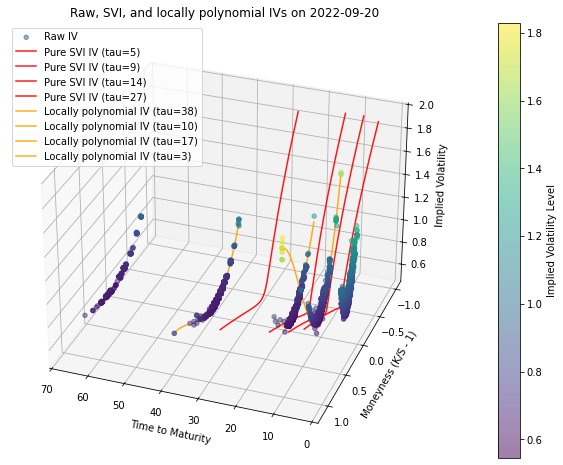

In [5]:
def load_rookley_iv(base_path, date):
    rookley_ivs = []
    for folder in os.listdir(base_path):
        if folder.startswith('Rookley_Q_CB_'):
            file_path = os.path.join(base_path, folder, f'btc_pk_{date}_bw_0.3.csv')
            if os.path.exists(file_path):
                tau = int(folder.split('_ttm')[-1])
                df_rookley = pd.read_csv(file_path)
                df_rookley['moneyness'] = df_rookley['m']-1
                df_rookley['IV'] = df_rookley['volatility']
                df_rookley['tau'] = tau
                df_rookley = df_rookley[['moneyness', 'IV', 'tau']]
                rookley_ivs.append((folder, df_rookley))
    return rookley_ivs

def plot_iv_3d_with_svi_and_rookley(df, date, svi_files, rookley_base_path):
    # Filter data for the specified date
    df_filtered = df[df['date'] == pd.to_datetime(date)]
    df_filtered.IV = df_filtered.IV/100 # Convert IV to percentage

    if df_filtered.empty:
        print(f"No data available for {date}.")
        return

    # Plot 3D scatter plot
    fig = plt.figure(figsize=(20, 8))
    ax = fig.add_subplot(111, projection='3d')
    ax.view_init(elev=30, azim=110)  # Adjust view to rotate and see tau from the opposite side
    scatter = ax.scatter(df_filtered['tau'], df_filtered['moneyness'], df_filtered['IV'], c=df_filtered['IV'], cmap='viridis', alpha=0.5, label='Raw IV')

    # Load and plot SVI model IVs
    for tau, file in svi_files.items():
        svi_iv = load_svi_iv(file, date)
        if svi_iv is not None:
            moneyness = np.arange(-1, 1.01, 0.01)
            ax.plot([tau] * len(moneyness), moneyness, svi_iv, color='red', label=f'Pure SVI IV (tau={tau})', alpha=0.9)
        else:
            print(f"No SVI data for {date} at tau={tau}.")

    # Load and plot Rookley IVs
    rookley_ivs = load_rookley_iv(rookley_base_path, date)
    for folder, df_rookley in rookley_ivs:
        tau_rookley = df_rookley['tau'][0]
        ax.plot(df_rookley['tau'], df_rookley['moneyness'], df_rookley['IV'], color='orange', 
                label=f'Locally polynomial IV (tau={tau_rookley})', alpha=0.9)

    ax.set_ylabel('Moneyness (K/S - 1)')
    ax.set_xlabel('Time to Maturity')
    ax.set_zlabel('Implied Volatility')
    ax.set_title(f'Raw, SVI, and locally polynomial IVs on {date}')
    ax.legend()
    fig.colorbar(scatter, ax=ax, label='Implied Volatility Level')

    ## Save and show plot
    if not os.path.exists('IV_comparison/moneyness/IV_raw_svi_rookley'):
        os.makedirs('IV_comparison/moneyness/IV_raw_svi_rookley')
    path_to_save = os.path.join(os.getcwd(), 'IV_comparison', 'moneyness', 'IV_raw_svi_rookley', f'IV_surface_{date}.png')
    plt.savefig(path_to_save)
    plt.show()

plot_iv_3d_with_svi_and_rookley(df, "2022-09-20", svi_files, rookley_base_path="IV_Rookley")

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


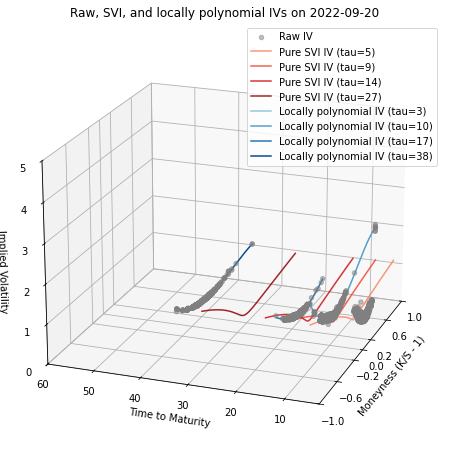

In [61]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import numpy as np
import os
import matplotlib.colors as mcolors
import datetime


def load_svi_iv(file_path, date):
    df_svi = pd.read_csv(file_path)
    df_svi['Date'] = pd.to_datetime(df_svi['Date'])
    svi_row = df_svi[df_svi['Date'] == pd.to_datetime(date)]
    if svi_row.empty:
        return None
    svi_row = svi_row.drop(columns=['Date']).values.flatten()
    return svi_row


def load_rookley_iv(base_path, date):
    rookley_ivs = []
    for tau in range(3, 61):
        folder = f'Rookley_Q_CB_1722_1_2_5_1_ttm{tau}'
        file_path = os.path.join(base_path, folder, f'btc_pk_{date}_bw_0.3.csv')
        if os.path.exists(file_path):
            df_rookley = pd.read_csv(file_path)
            df_rookley['moneyness'] = df_rookley['m'] - 1
            df_rookley['IV'] = df_rookley['volatility']
            df_rookley['tau'] = tau
            df_rookley['date'] = pd.to_datetime(date)
            df_rookley = df_rookley[['moneyness', 'IV', 'tau', 'date']]
            rookley_ivs.append((folder, df_rookley))
    return rookley_ivs


def plot_iv_3d_with_svi_and_rookley(df, date, svi_files, rookley_base_path):
    # Filter data for the specified date
    df_filtered = df[(df['date'] == pd.to_datetime(date)) & (df['tau'] >= 3) & (df['tau'] <= 60)]
    df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage

    if df_filtered.empty:
        print(f"No data available for {date}.")
        return

    # Plot 3D scatter plot
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    ax.view_init(elev=20, azim=200)  # Adjust view to rotate and see tau from the opposite side
    scatter = ax.scatter(df_filtered['moneyness'], df_filtered['tau'], df_filtered['IV'], color='gray', alpha=0.5, label='Raw IV')

    # Generate different shades for SVI IVs
    svi_colors = plt.cm.Reds(np.linspace(0.4, 0.9, len(svi_files)))

    # Load and plot SVI model IVs
    for i, (tau, file) in enumerate(svi_files.items()):
        svi_iv = load_svi_iv(file, date)
        if svi_iv is not None:
            moneyness = np.arange(-1, 1.01, 0.01)
            ax.plot(moneyness, [tau] * len(moneyness), svi_iv, color=svi_colors[i % len(svi_colors)], label=f'Pure SVI IV (tau={tau})', alpha=0.9)
        else:
            print(f"No SVI data for {date} at tau={tau}.")

    # Load and plot Rookley IVs
    rookley_ivs = load_rookley_iv(rookley_base_path, date)
    rookley_colors = plt.cm.Blues(np.linspace(0.4, 0.9, len(rookley_ivs))) # Generate different shades for Rookley IVs
    for i, (folder, df_rookley) in enumerate(rookley_ivs):
        tau_rookley = df_rookley['tau'][0]
        ax.plot(df_rookley['moneyness'], df_rookley['tau'], df_rookley['IV'], color=rookley_colors[i % len(rookley_colors)], label=f'Locally polynomial IV (tau={tau_rookley})')

    ax.set_xlabel('Moneyness (K/S - 1)')
    ax.set_ylabel('Time to Maturity')
    ax.set_zlabel('Implied Volatility')
    ax.set_title(f'Raw, SVI, and locally polynomial IVs on {date}')
    ax.legend()
    ax.set_xlim(-1, 1)
    ax.set_ylim(3, 60)
    ax.set_zlim(0, 5)
    ax.set_xticks([-1, -0.6, -0.2, 0, 0.2, 0.6, 1])

    # Save and show plot
    if not os.path.exists('IV_comparison/moneyness/IV_raw_svi_rookley/IV_curves'):
        os.makedirs('IV_comparison/moneyness/IV_raw_svi_rookley/IV_curves')
    path_to_save = os.path.join(os.getcwd(), 'IV_comparison', 'moneyness', 'IV_raw_svi_rookley', 'IV_curves', f'IV_curves_{date}.png')
    plt.savefig(path_to_save)
    plt.show()

plot_iv_3d_with_svi_and_rookley(df, "2022-09-20", svi_files, rookley_base_path="IV_Rookley")


/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


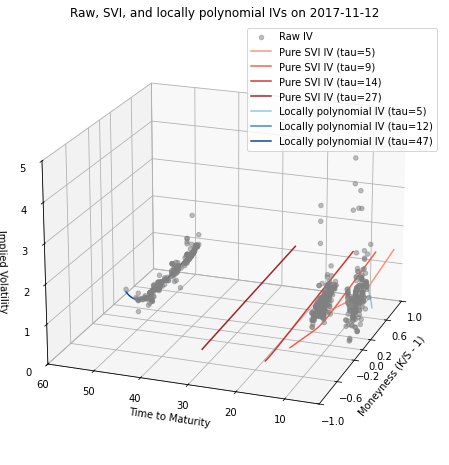

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


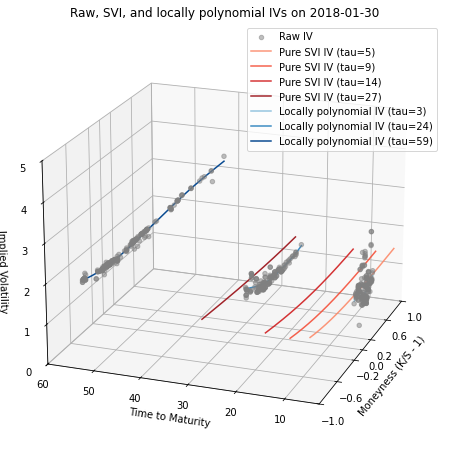

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


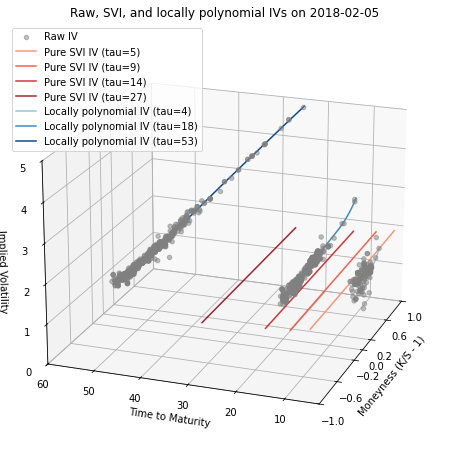

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


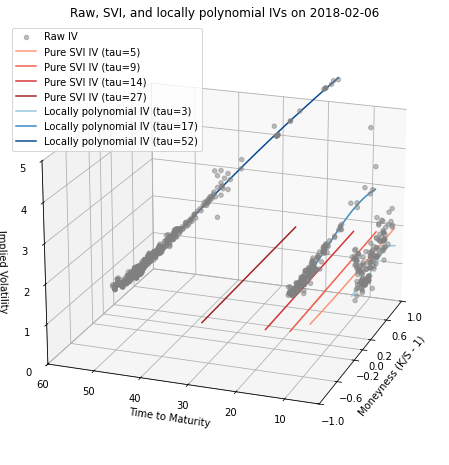

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


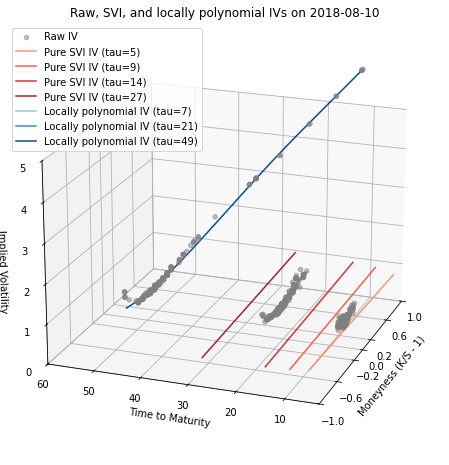

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


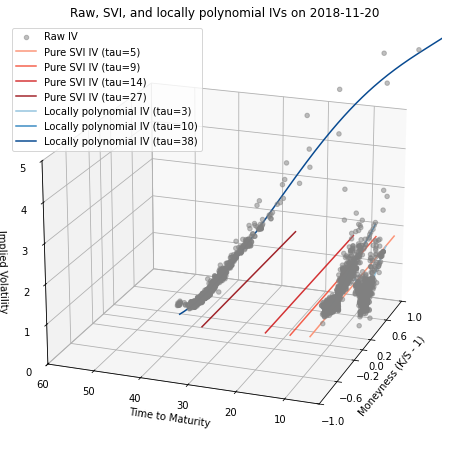

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


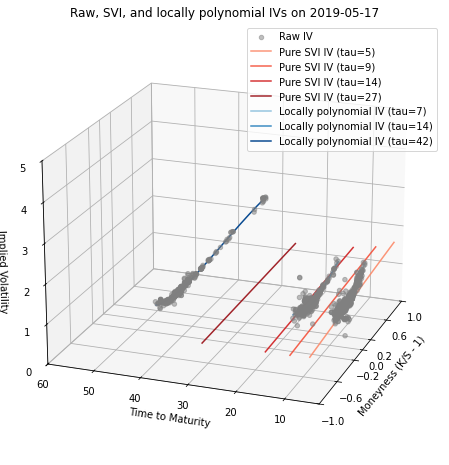

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


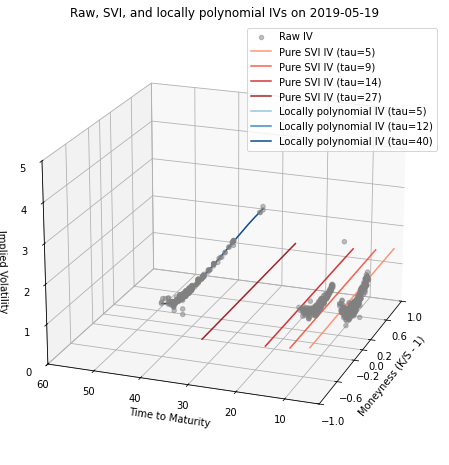

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


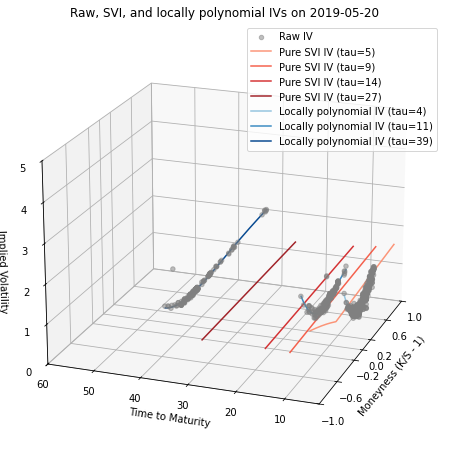

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


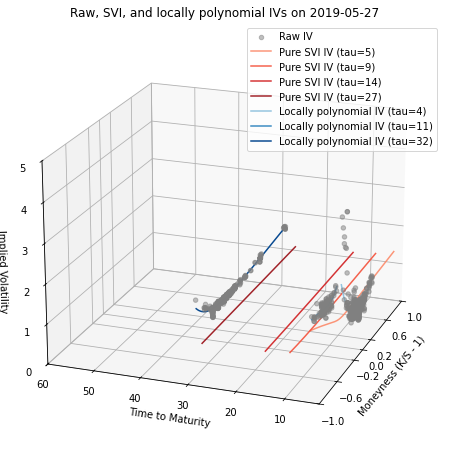

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


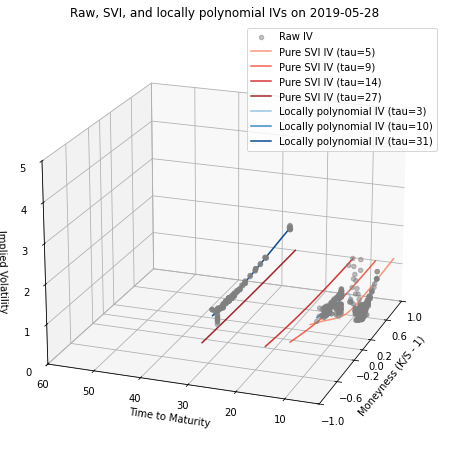

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


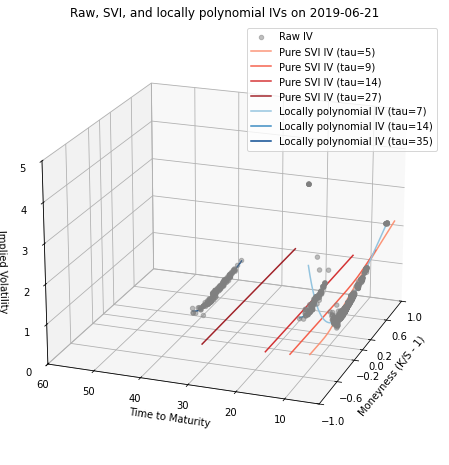

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


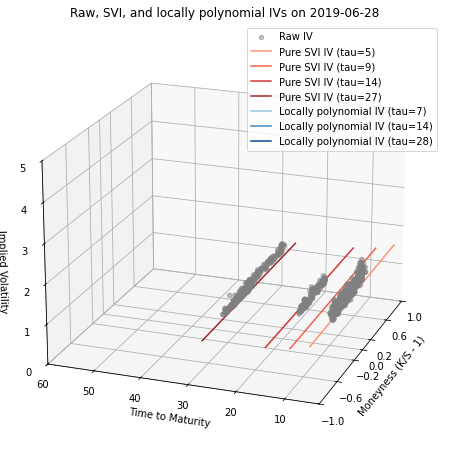

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


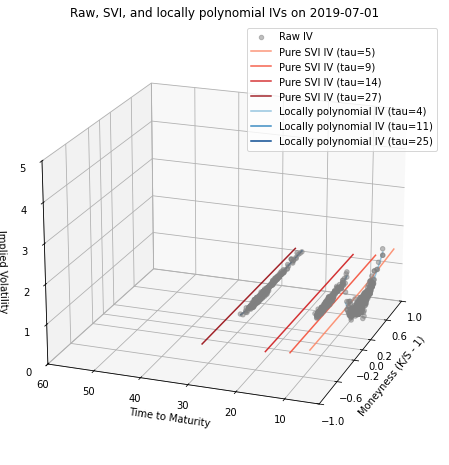

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


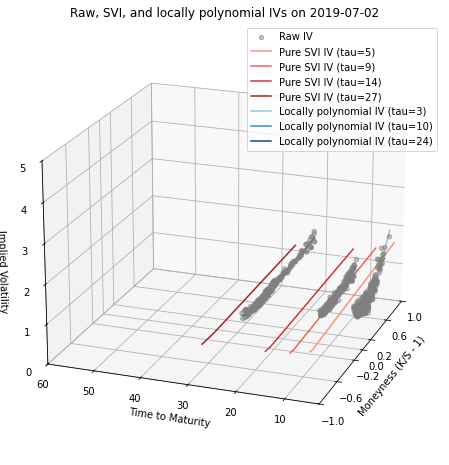

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


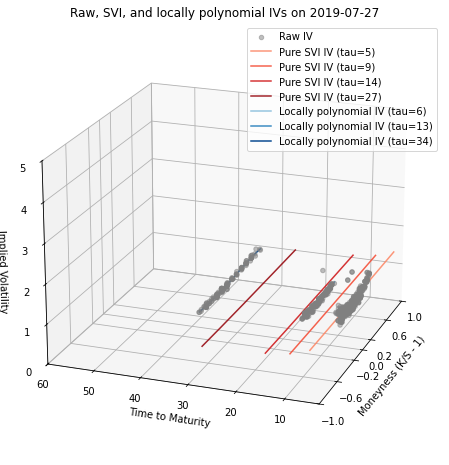

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


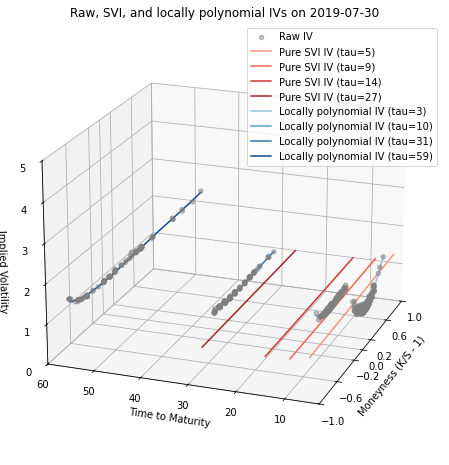

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


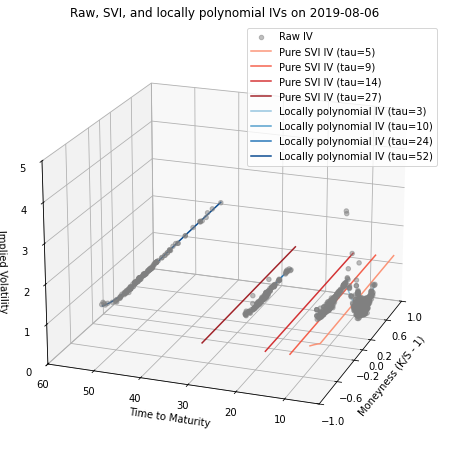

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


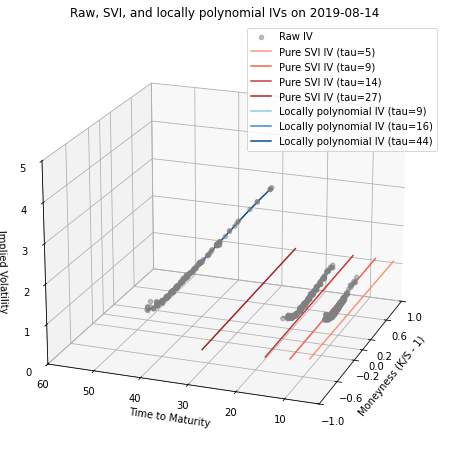

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


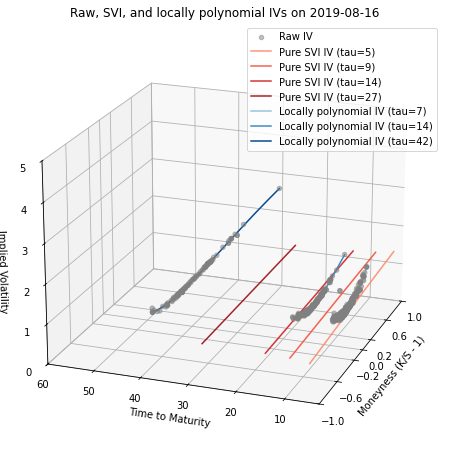

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


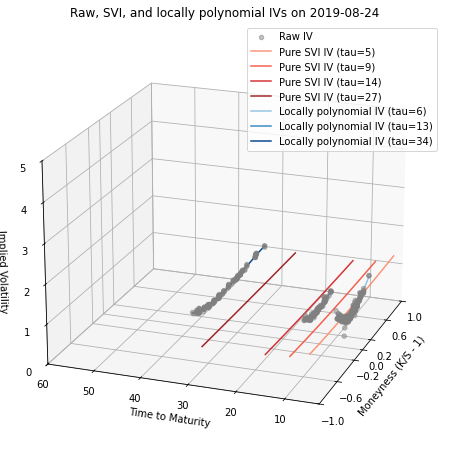

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


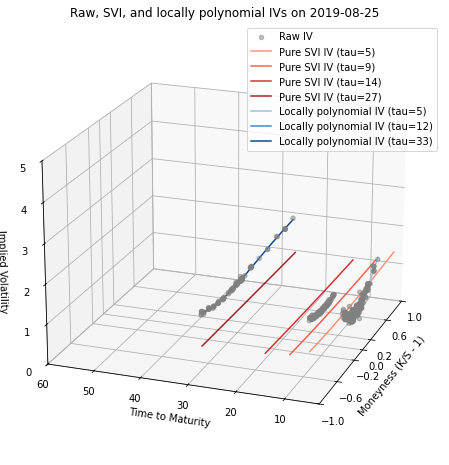

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


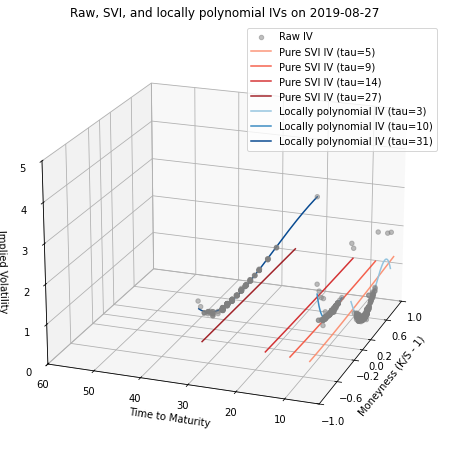

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


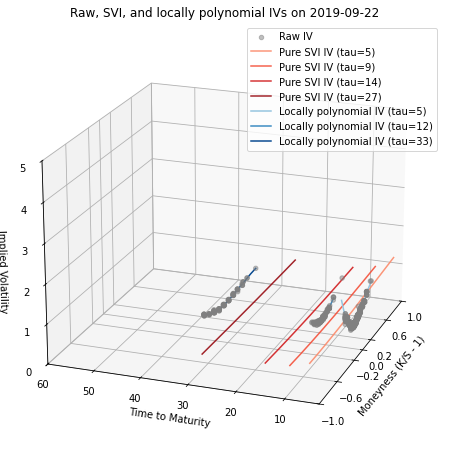

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


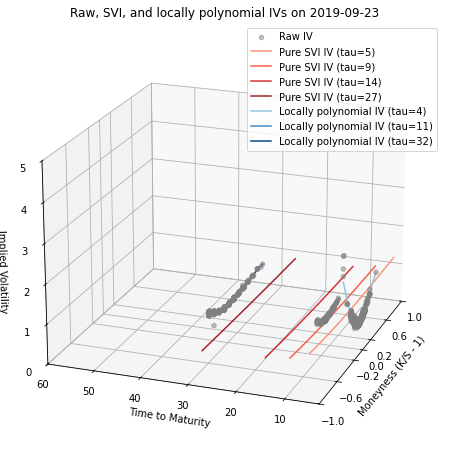

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


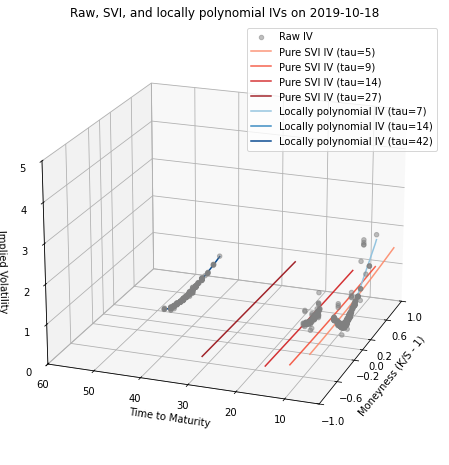

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


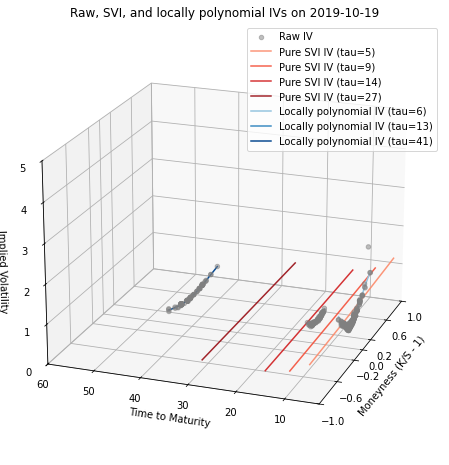

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


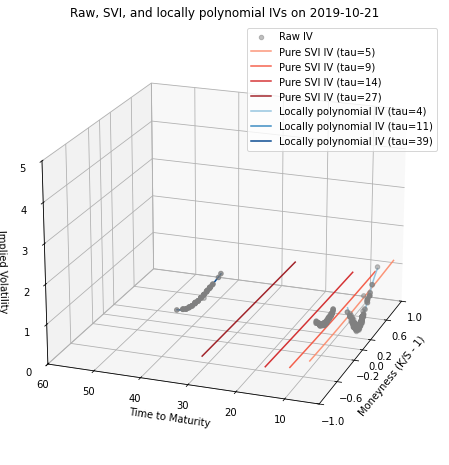

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


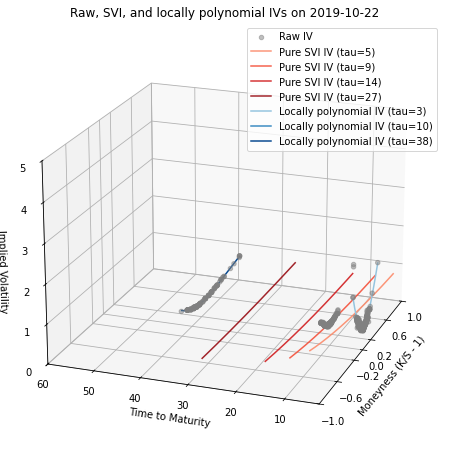

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


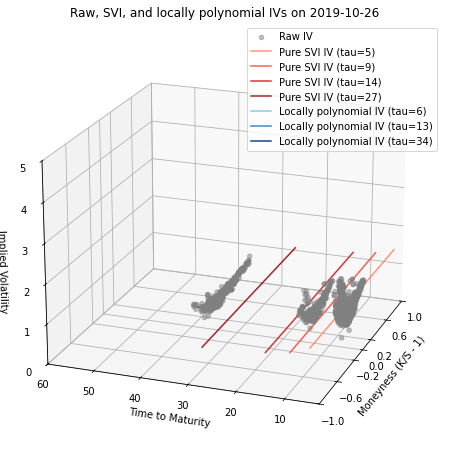

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


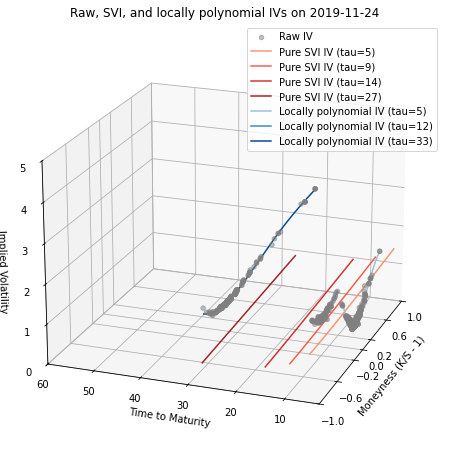

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


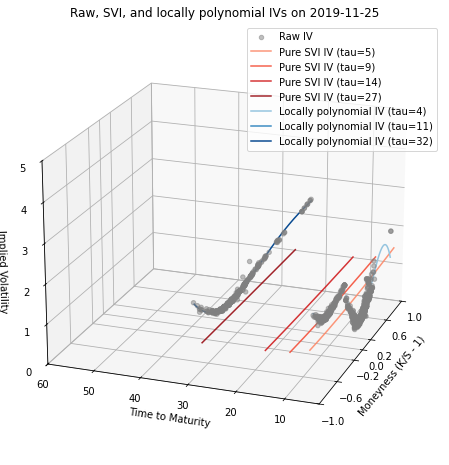

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


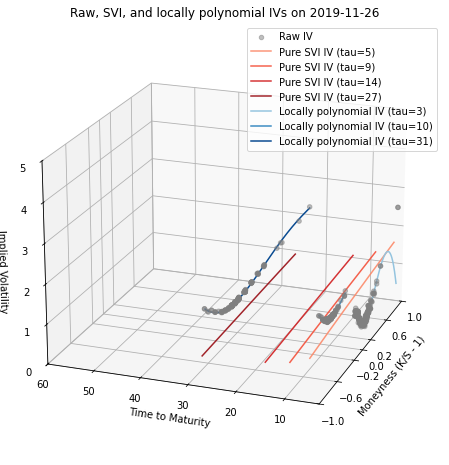

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


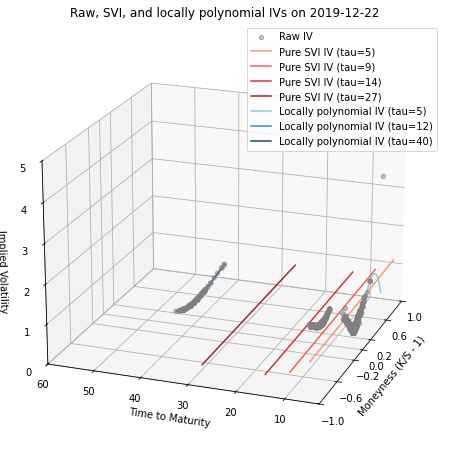

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


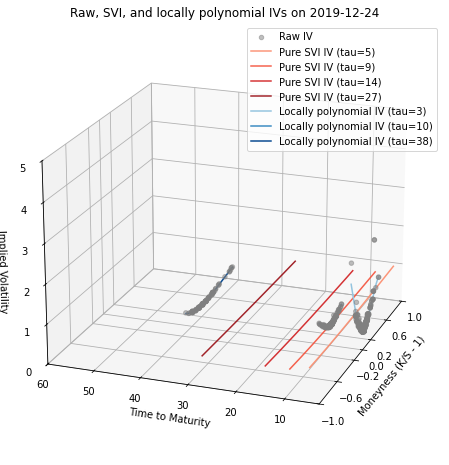

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


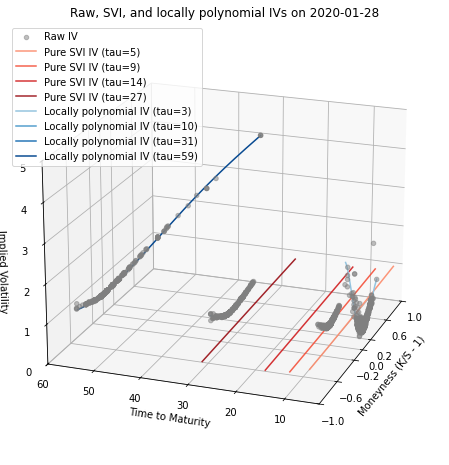

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


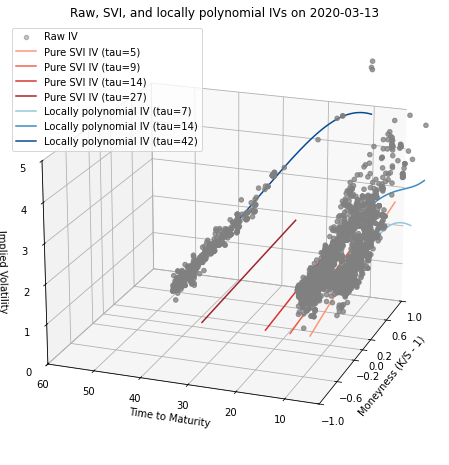

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


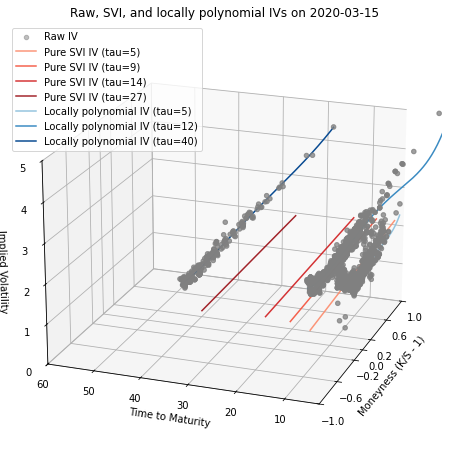

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


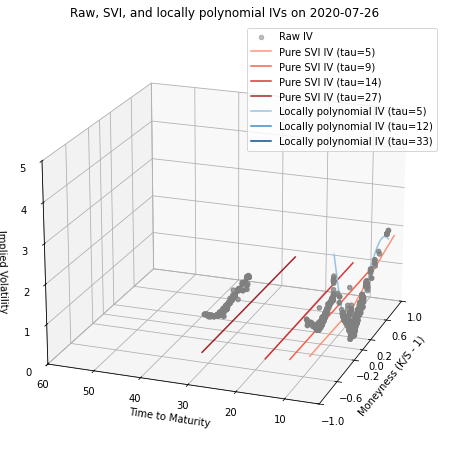

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


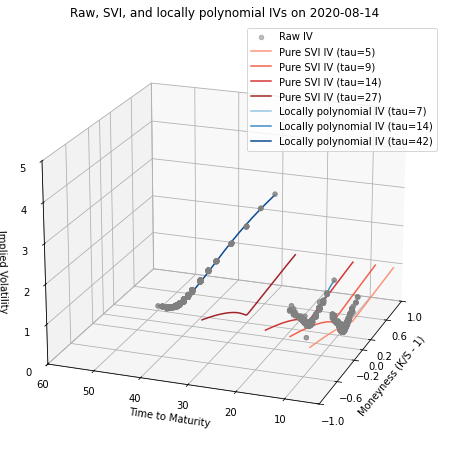

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


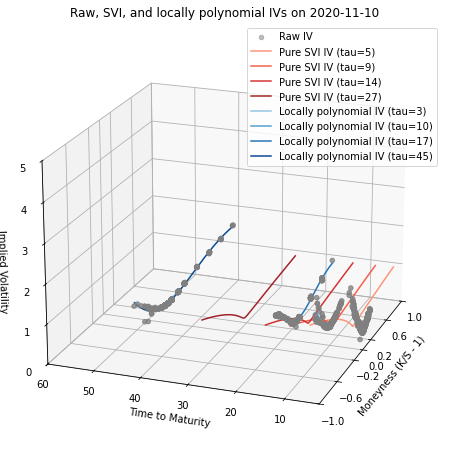

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


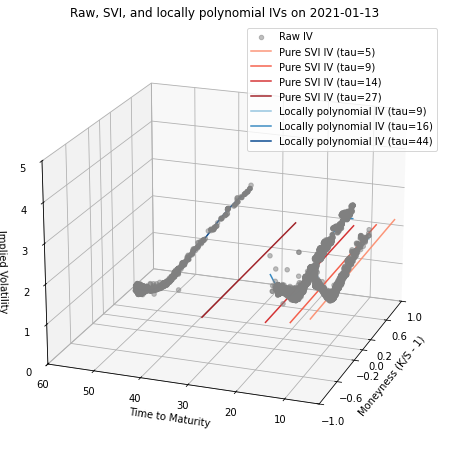

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


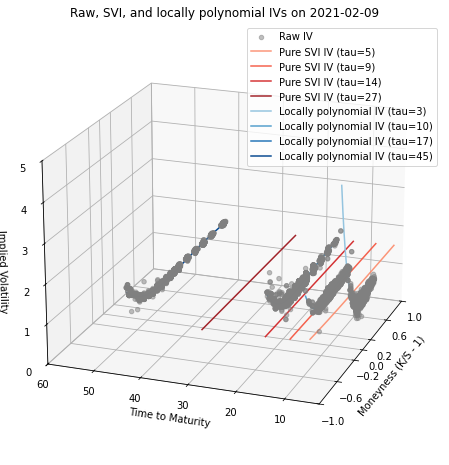

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


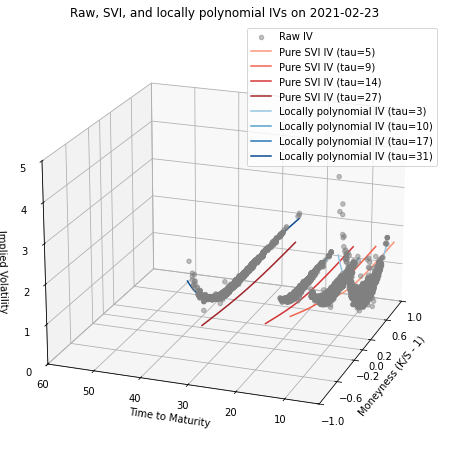

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


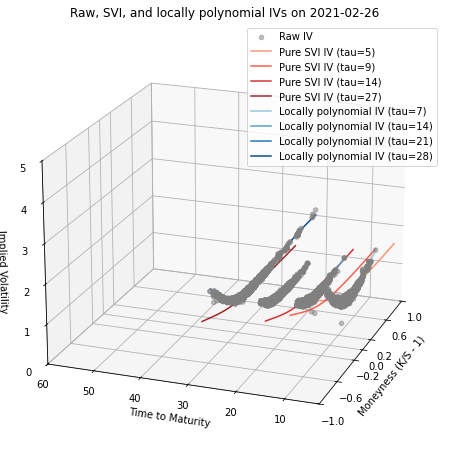

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


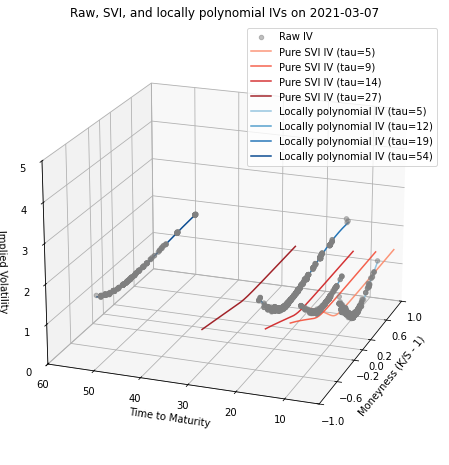

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


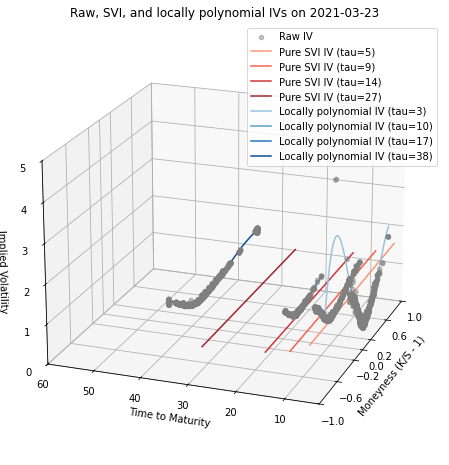

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


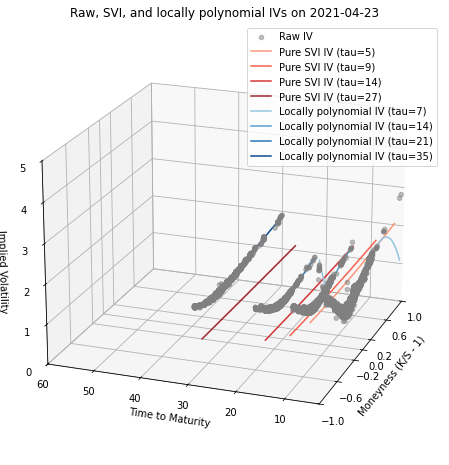

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


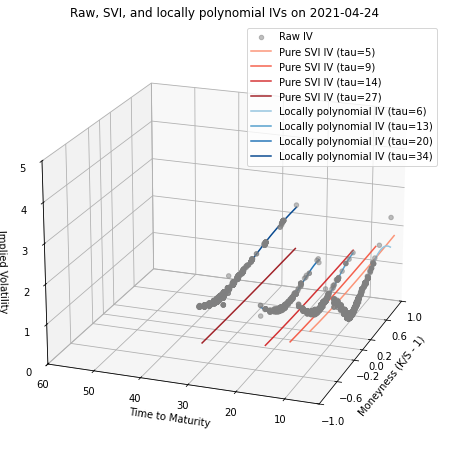

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


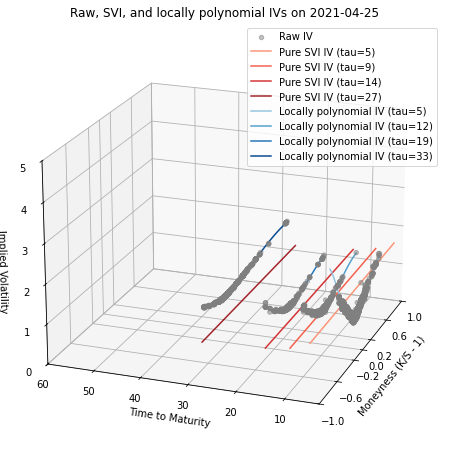

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


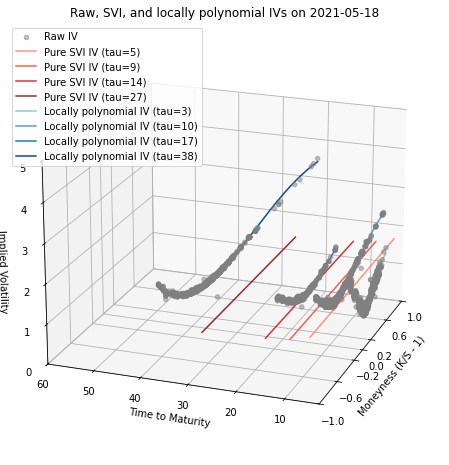

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


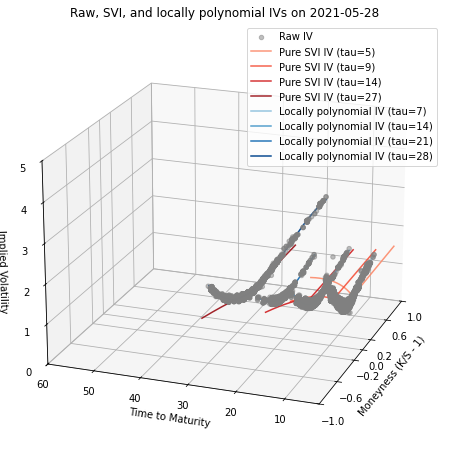

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


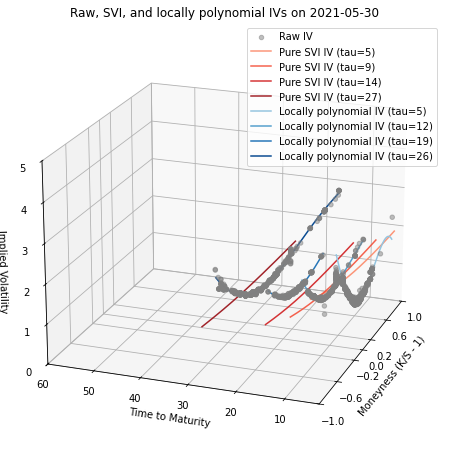

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


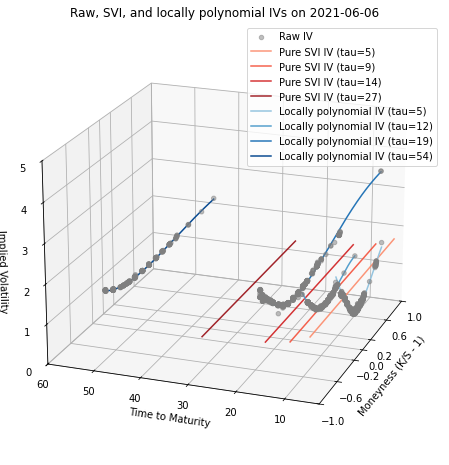

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


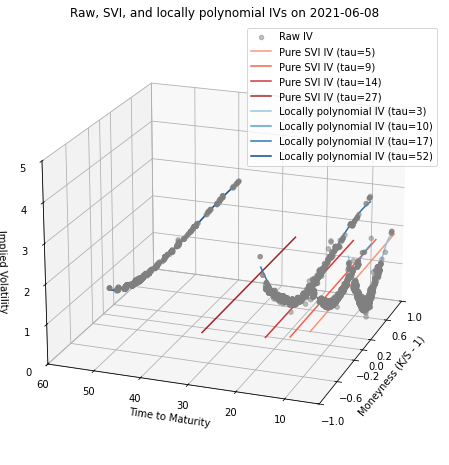

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


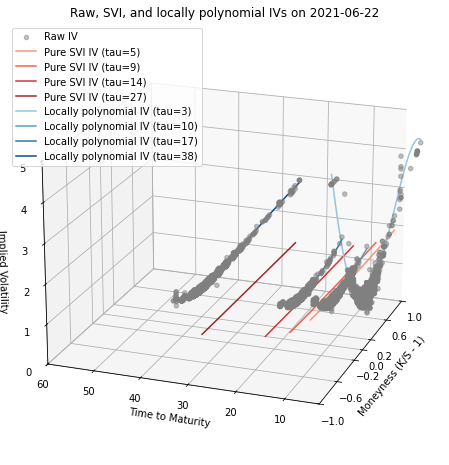

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


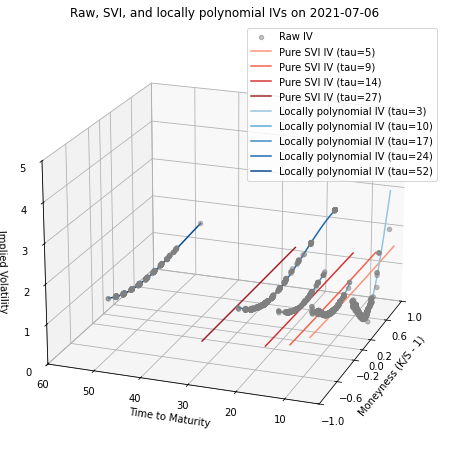

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


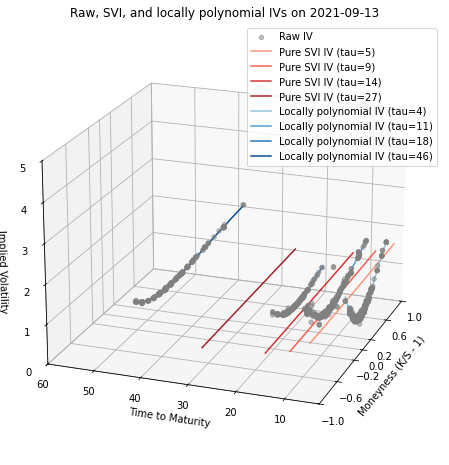

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


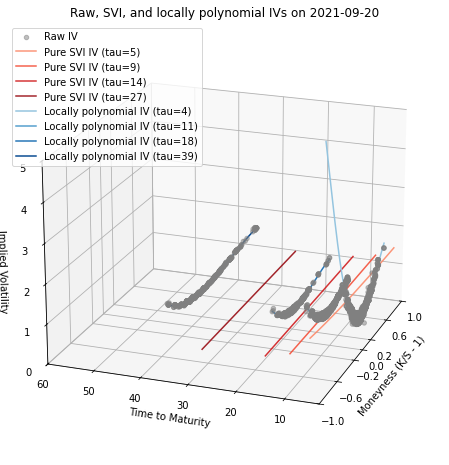

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


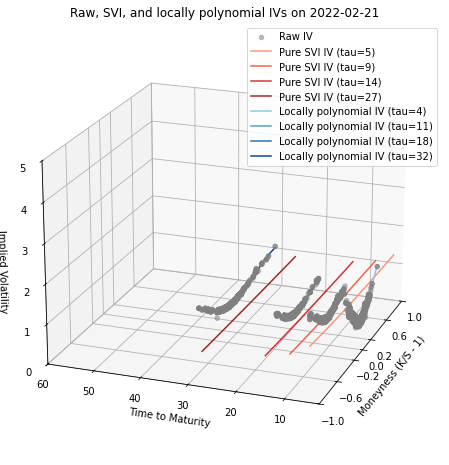

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


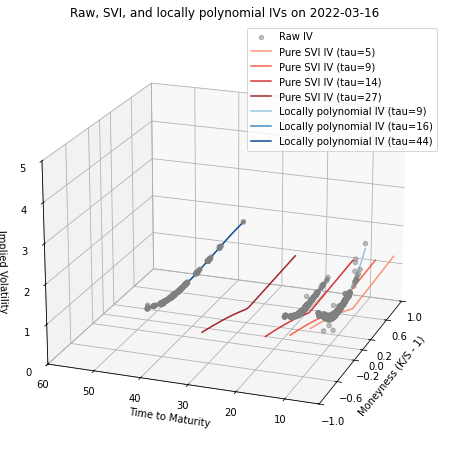

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


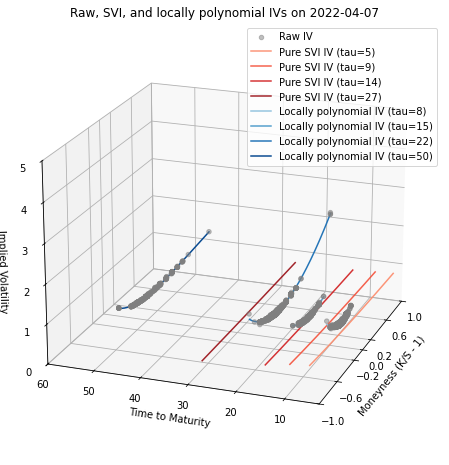

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


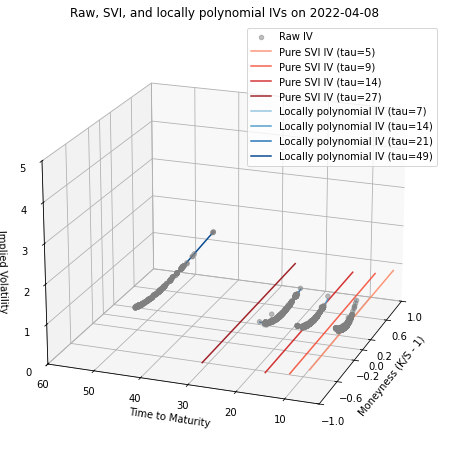

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


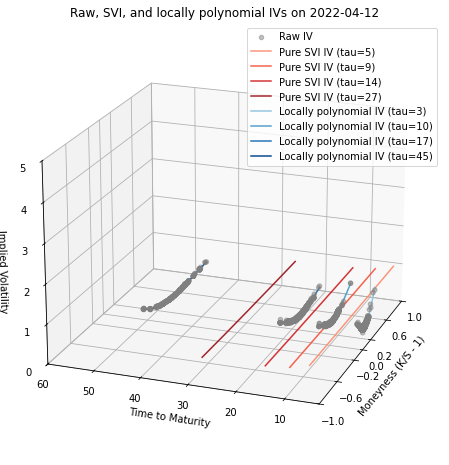

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


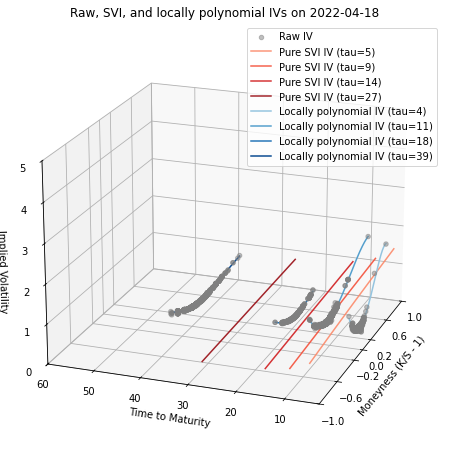

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


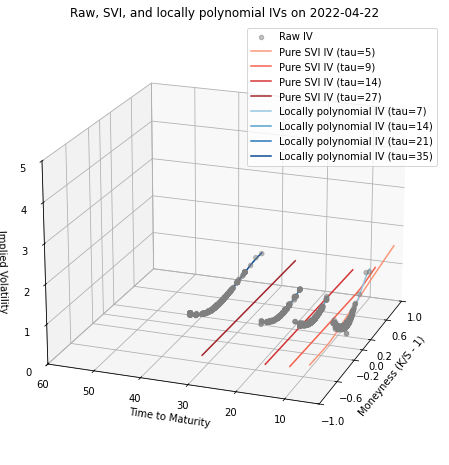

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


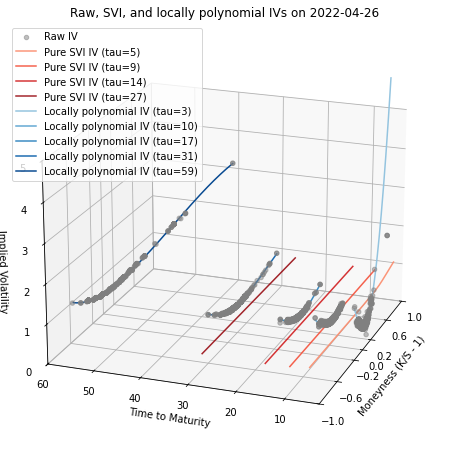

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


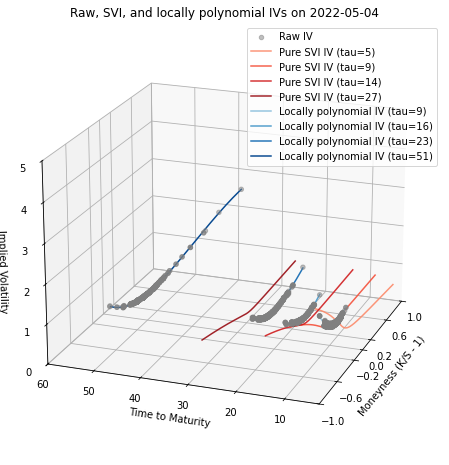

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


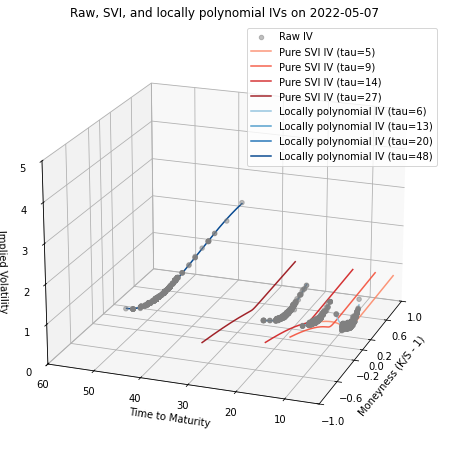

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


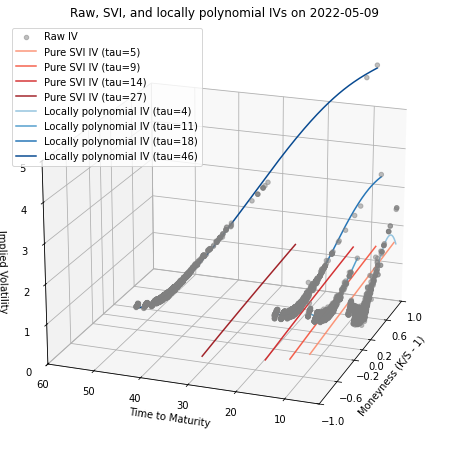

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


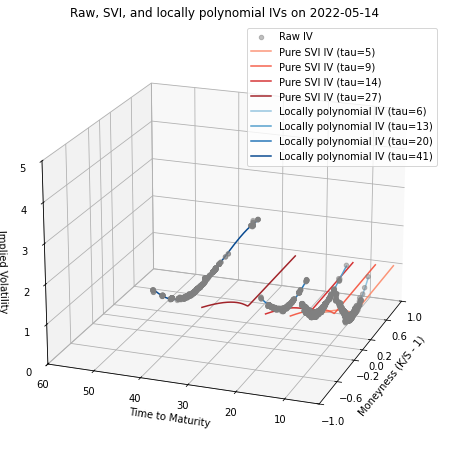

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


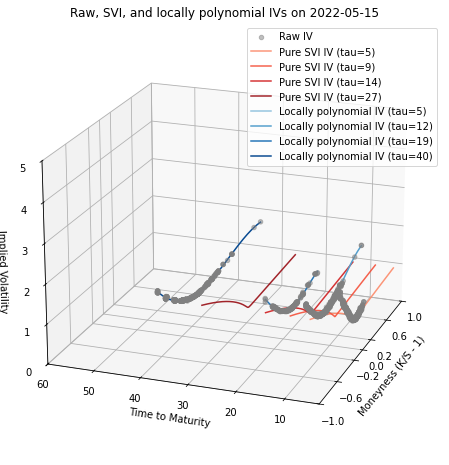

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


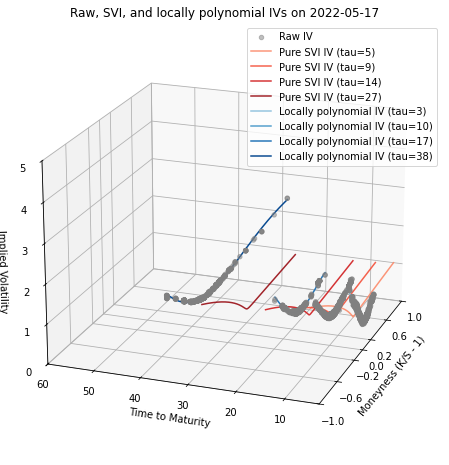

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


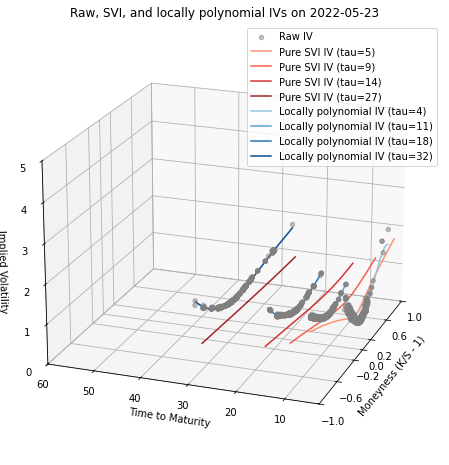

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


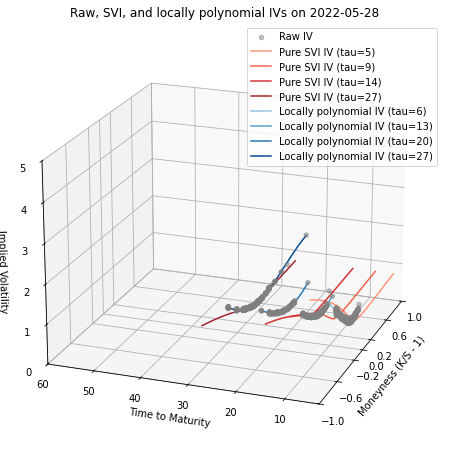

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


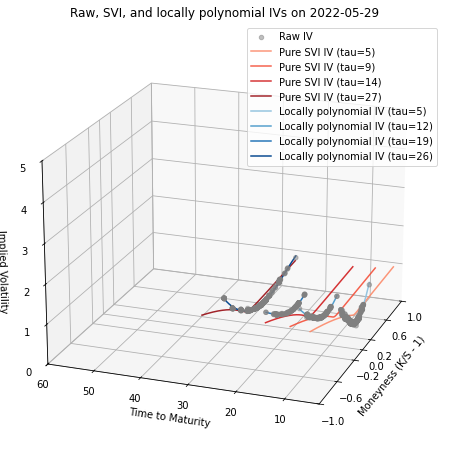

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


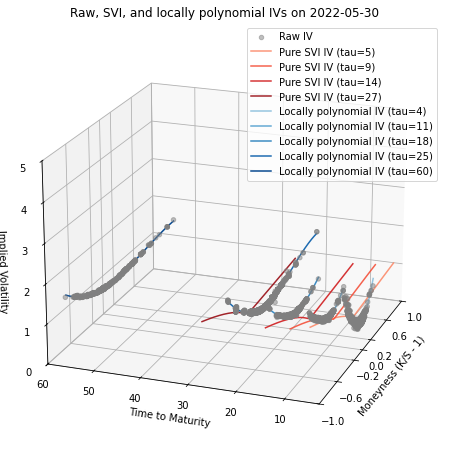

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


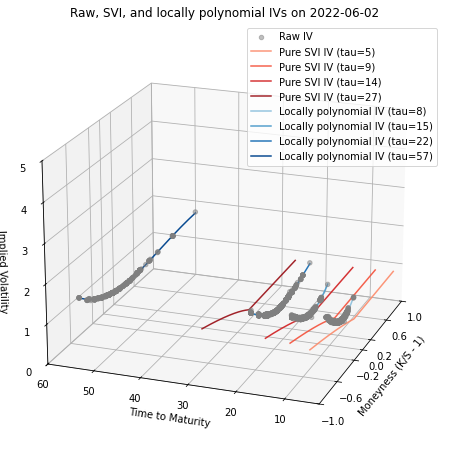

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


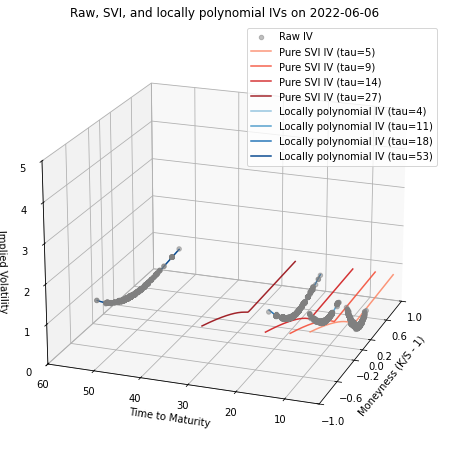

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


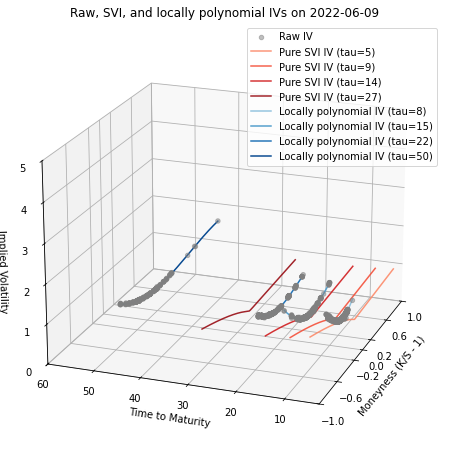

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


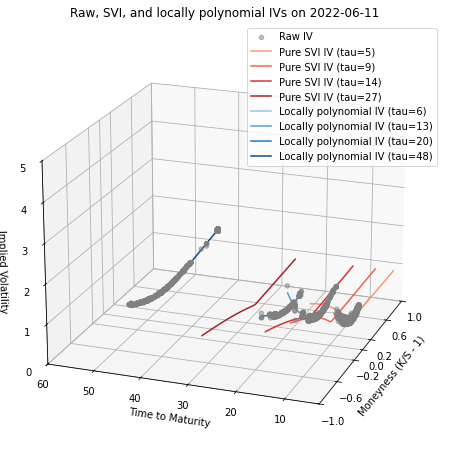

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


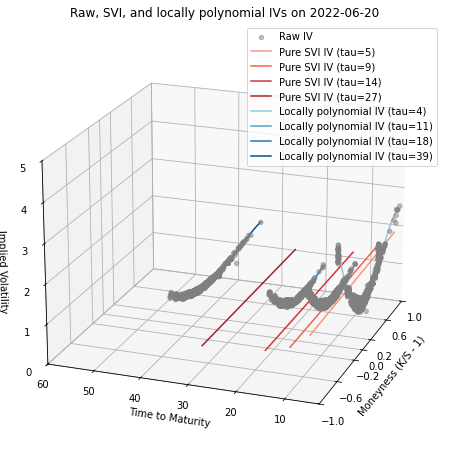

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


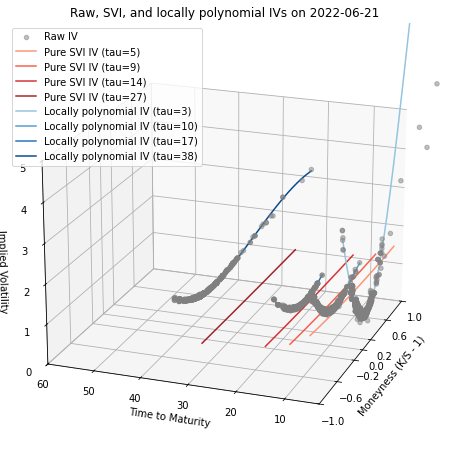

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


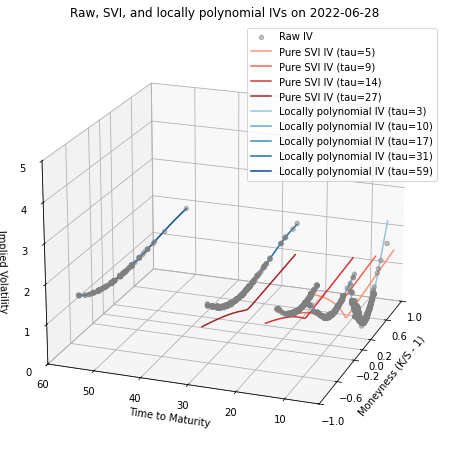

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


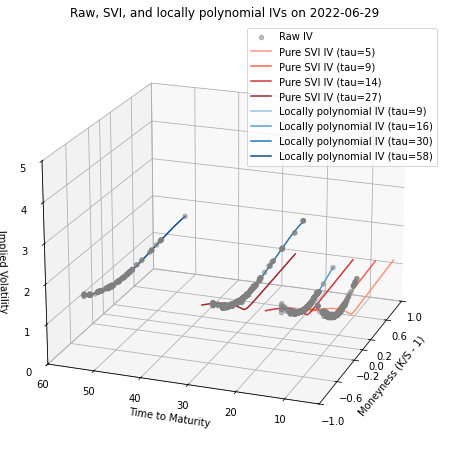

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


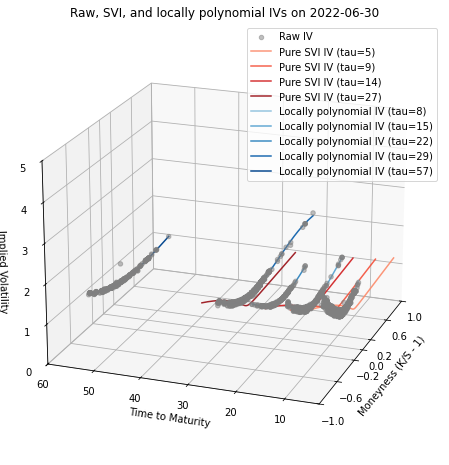

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


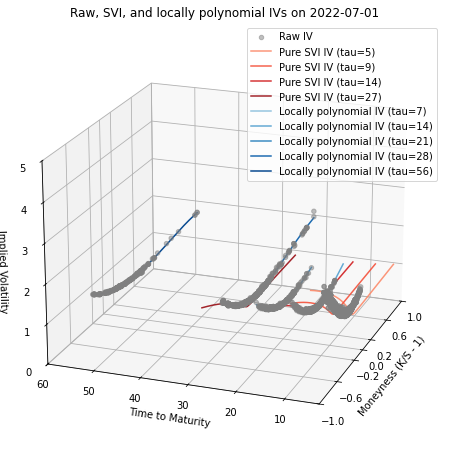

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


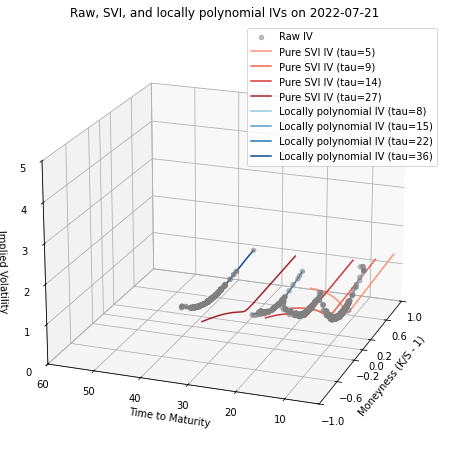

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


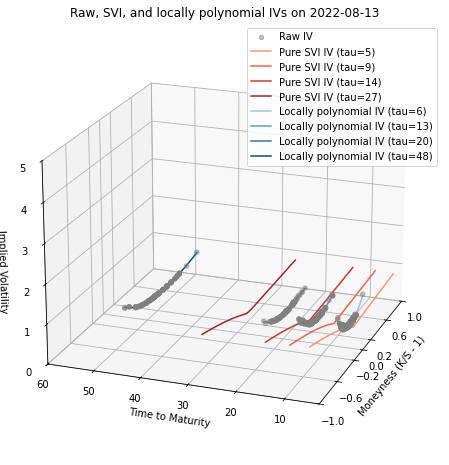

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


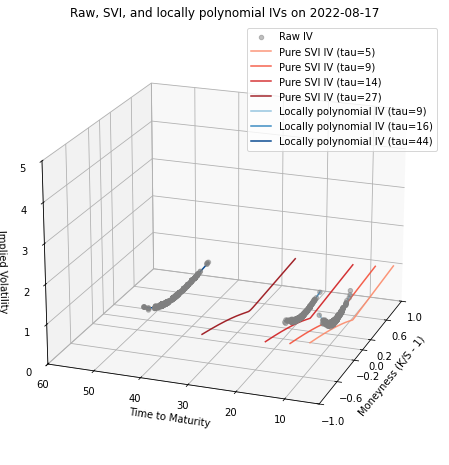

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


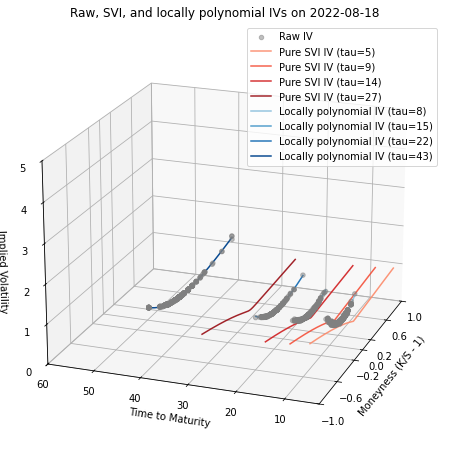

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


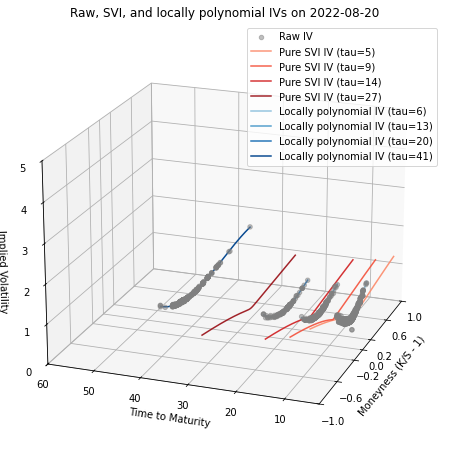

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


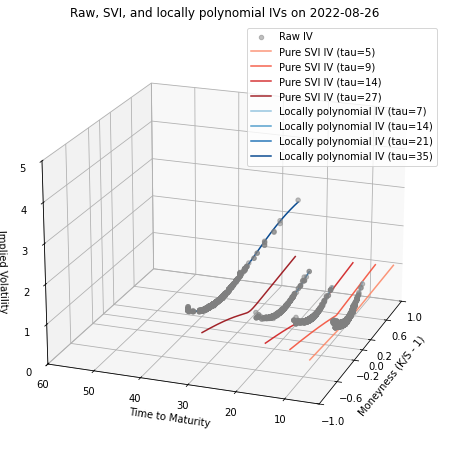

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


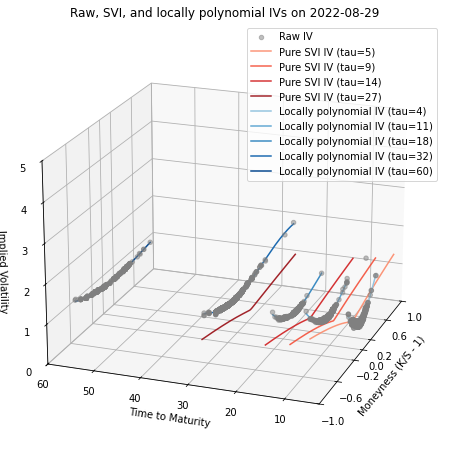

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


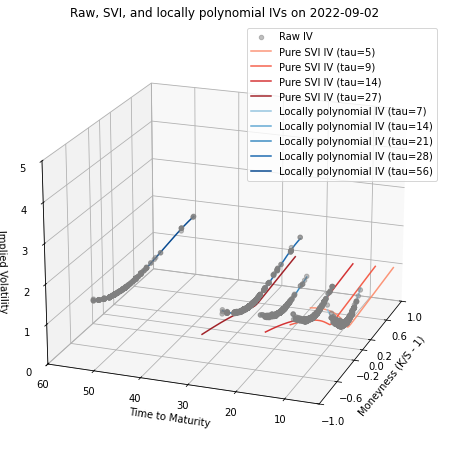

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


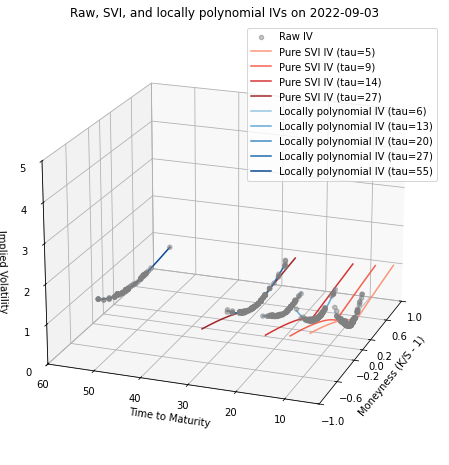

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


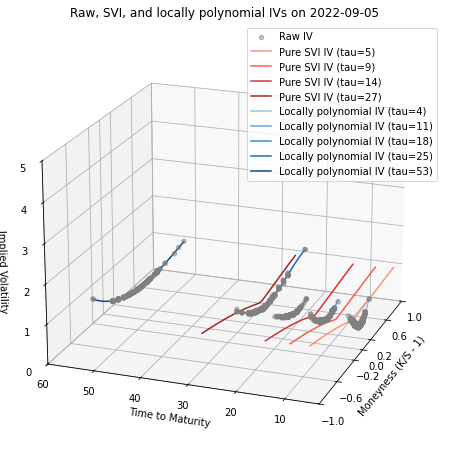

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


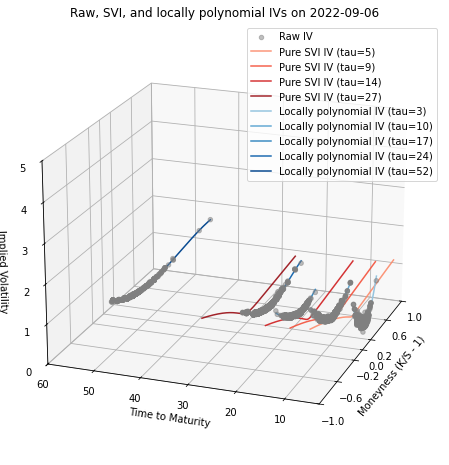

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


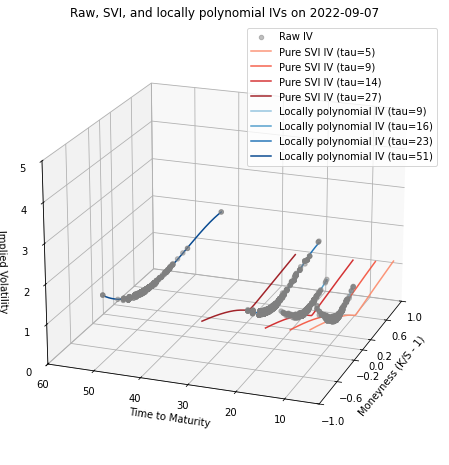

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


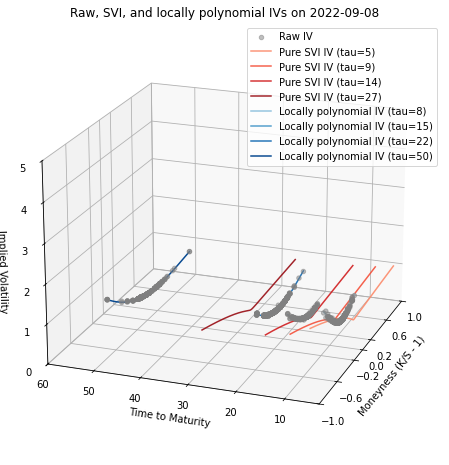

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


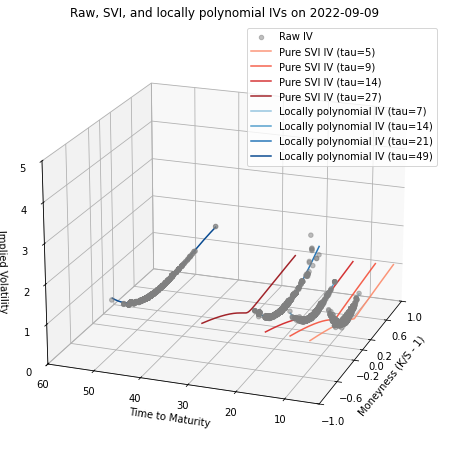

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


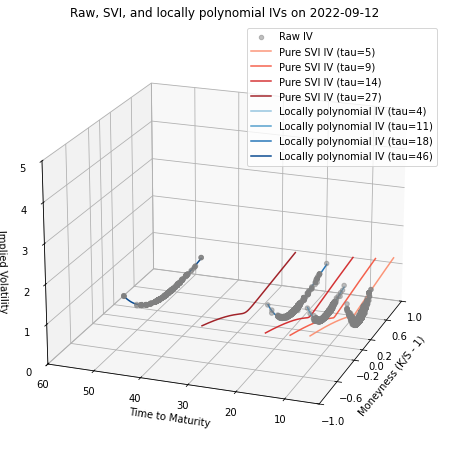

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


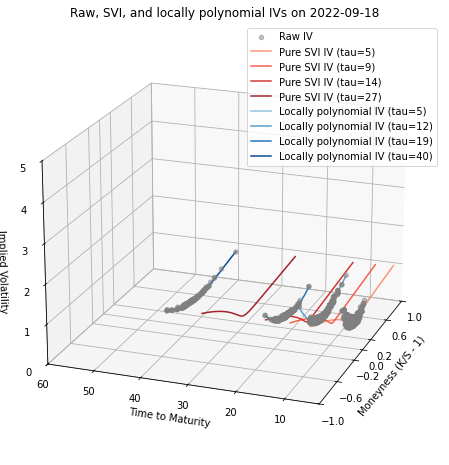

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


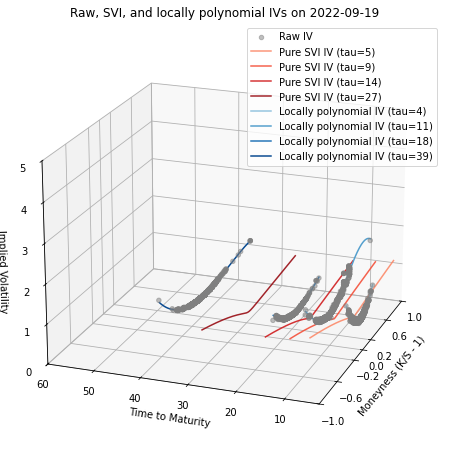

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


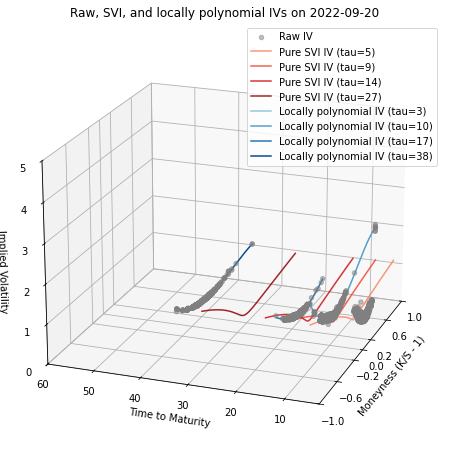

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


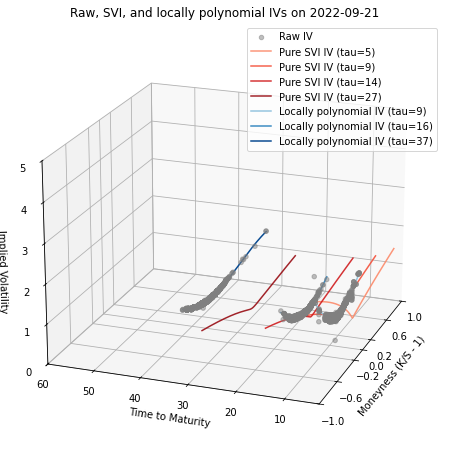

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


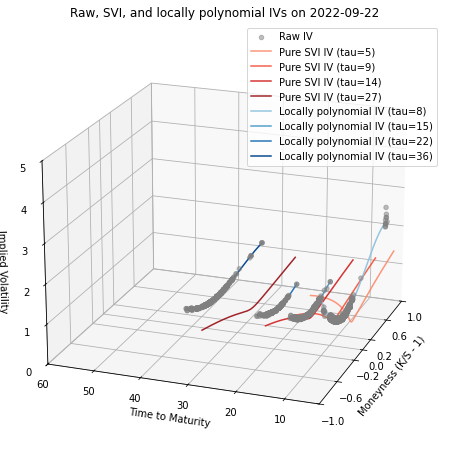

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


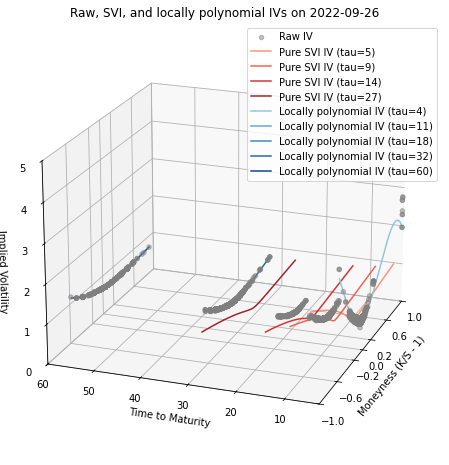

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


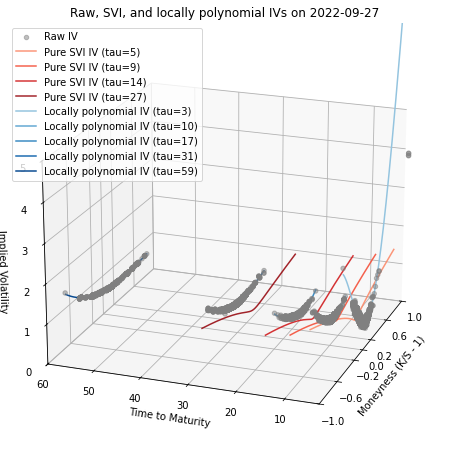

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


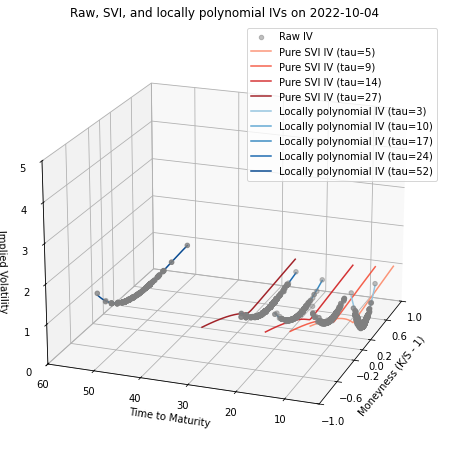

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


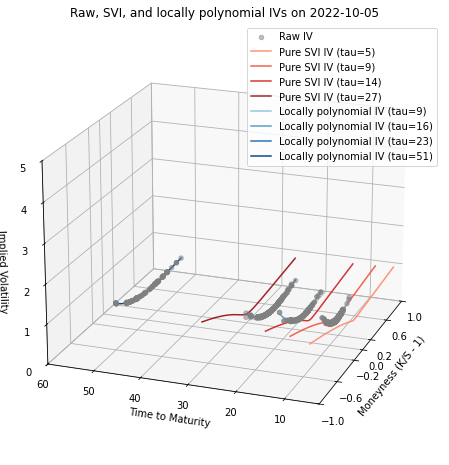

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


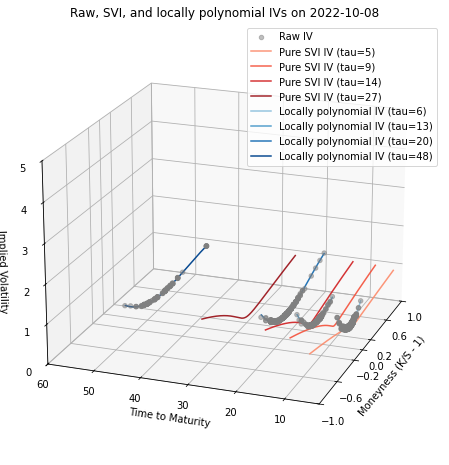

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


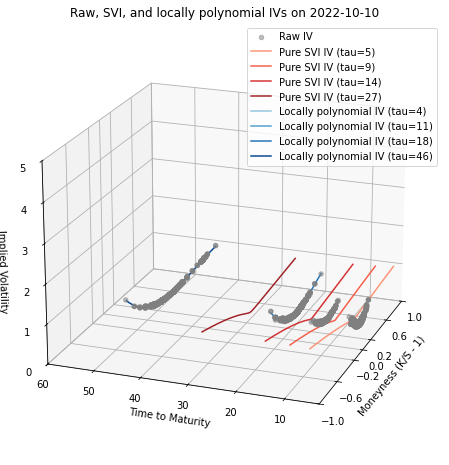

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


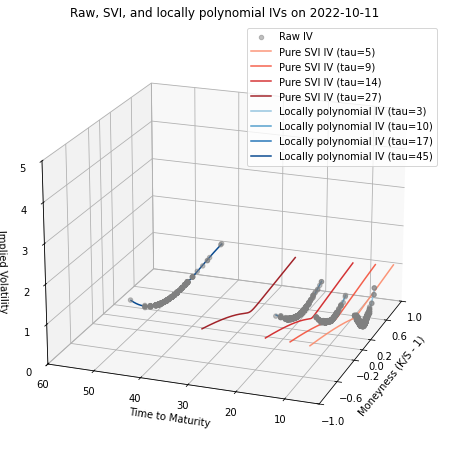

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


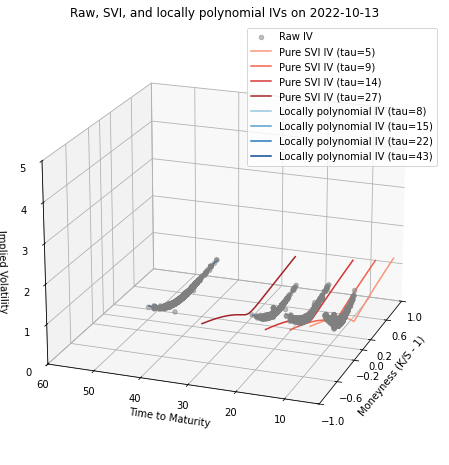

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


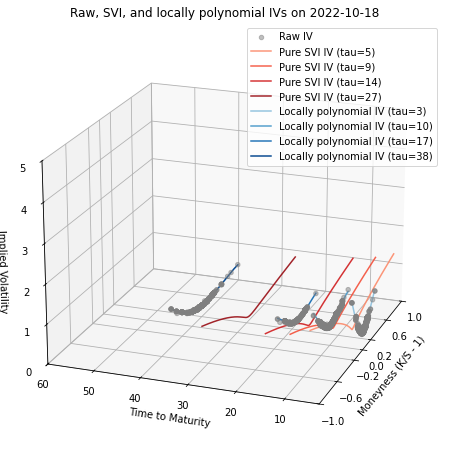

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


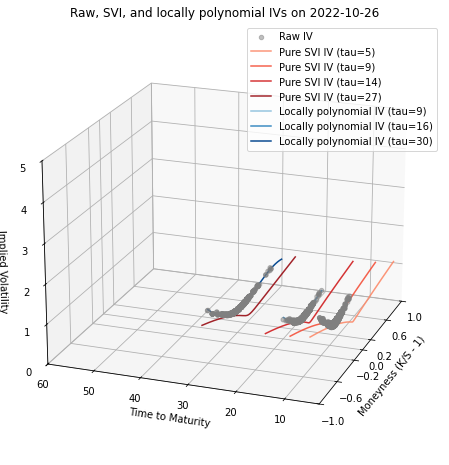

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/442362383.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


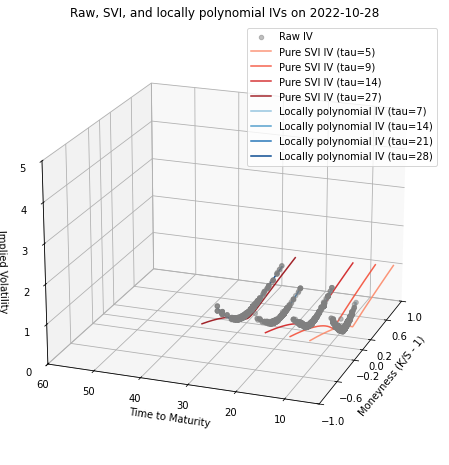

In [62]:
# Read the list of dates
common_dates = pd.read_csv('Clustering/common_dates_cluster_old_and_new.csv')['Date']

# Execute for each date
for date in common_dates:
    # Unify the date format
    date = datetime.datetime.strptime(str(date), '%Y%m%d').strftime('%Y-%m-%d')
    plot_iv_3d_with_svi_and_rookley(df, date, svi_files, rookley_base_path="IV_Rookley")


/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


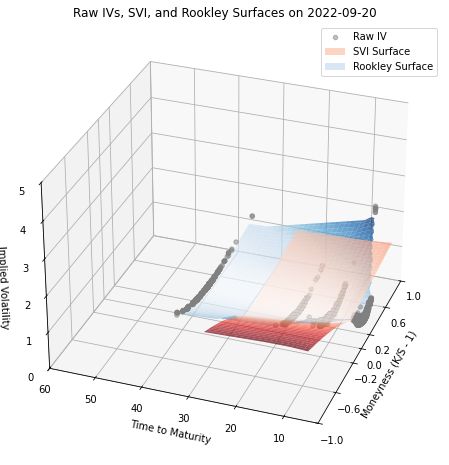

In [59]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import numpy as np
import os
import matplotlib.colors as mcolors
import datetime
from scipy.interpolate import griddata

def plot_iv_3d_with_surfaces(df, date, svi_files, rookley_base_path):
    # Filter data for the specified date
    df_filtered = df[(df['date'] == pd.to_datetime(date)) & (df['tau'] >= 3) & (df['tau'] <= 60)]
    df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage

    if df_filtered.empty:
        print(f"No data available for {date}.")
        return

    # Plot 3D scatter plot
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    ax.view_init(elev=30, azim=200)
    scatter = ax.scatter(df_filtered['moneyness'], df_filtered['tau'], df_filtered['IV'], color='gray', alpha=0.5, label='Raw IV')

    # Prepare data for SVI surface
    svi_data = []
    for tau, file in svi_files.items():
        svi_iv = load_svi_iv(file, date)
        if svi_iv is not None:
            moneyness = np.arange(-1, 1.01, 0.01)
            svi_data.append(np.array([moneyness, [tau] * len(moneyness), svi_iv]).T)
    svi_data = np.vstack(svi_data)

    # Interpolate SVI surface
    tau_grid, mon_grid = np.mgrid[3:60:100j, -1:1:100j]
    svi_grid = griddata(svi_data[:, [1, 0]], svi_data[:, 2], (tau_grid, mon_grid), method='linear')
    ax.plot_surface(mon_grid, tau_grid, svi_grid, cmap='Reds', alpha=0.7, label='SVI Surface')

    # Prepare data for Rookley surface
    rookley_ivs = load_rookley_iv(rookley_base_path, date)
    rookley_data = np.vstack([df.values for _, df in rookley_ivs])
    rookley_grid = griddata(rookley_data[:, [2, 0]], rookley_data[:, 1], (tau_grid, mon_grid), method='linear')
    ax.plot_surface(mon_grid, tau_grid, rookley_grid, cmap='Blues', alpha=0.7, label='Rookley Surface')

    ax.set_xlabel('Moneyness (K/S - 1)')
    ax.set_ylabel('Time to Maturity')
    ax.set_zlabel('Implied Volatility', rotation=270)
    ax.set_title(f'Raw IVs, SVI, and Rookley Surfaces on {date}')
    ax.legend()
    ax.set_xlim(-1, 1)
    ax.set_ylim(3, 60)
    ax.set_zlim(0, 5)
    ax.set_xticks([-1, -0.6, -0.2, 0, 0.2, 0.6, 1])

    # Save and show plot
    if not os.path.exists('IV_comparison/moneyness/IV_raw_svi_rookley/IV_surfaces'):
        os.makedirs('IV_comparison/moneyness/IV_raw_svi_rookley/IV_surfaces')
    path_to_save = os.path.join(os.getcwd(), 'IV_comparison', 'moneyness', 'IV_raw_svi_rookley', 'IV_surfaces', f'IV_surface_{date}.png')
    plt.savefig(path_to_save)
    plt.show()

plot_iv_3d_with_surfaces(df, "2022-09-20", svi_files, rookley_base_path="IV_Rookley")


/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


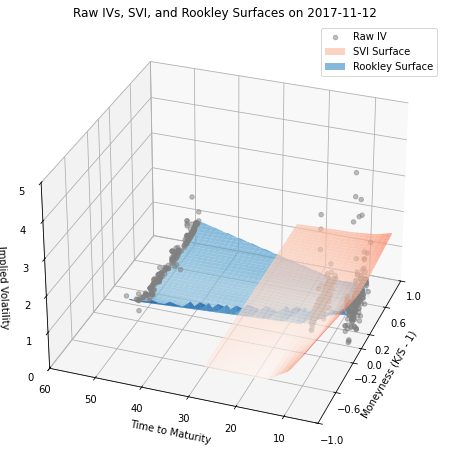

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


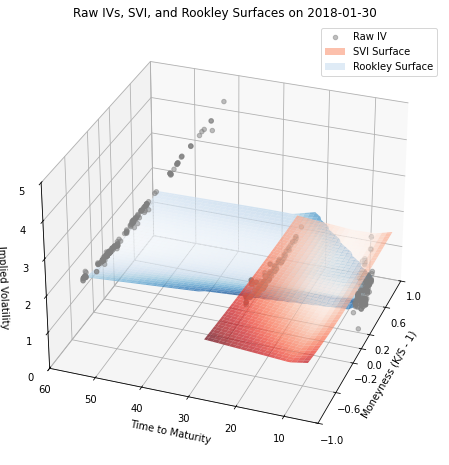

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


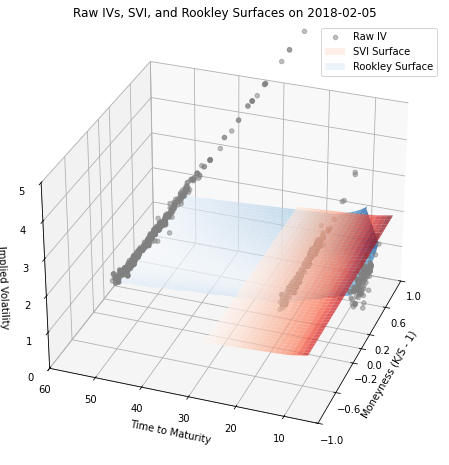

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


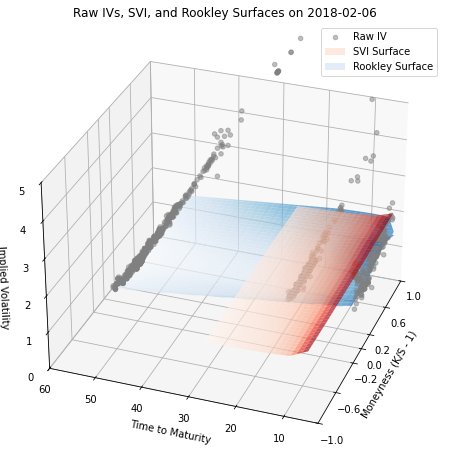

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


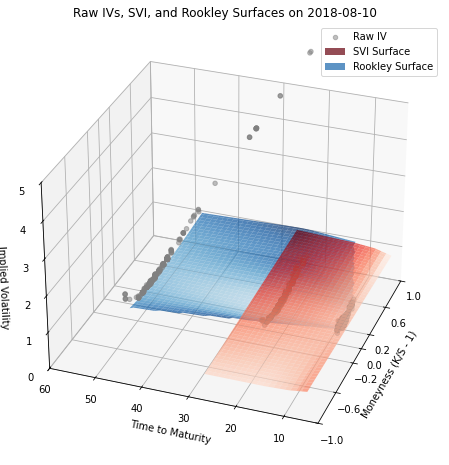

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


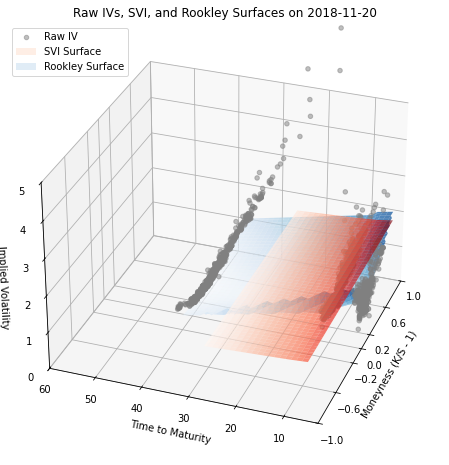

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


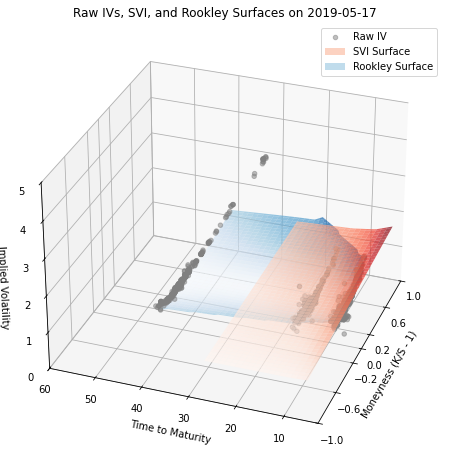

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


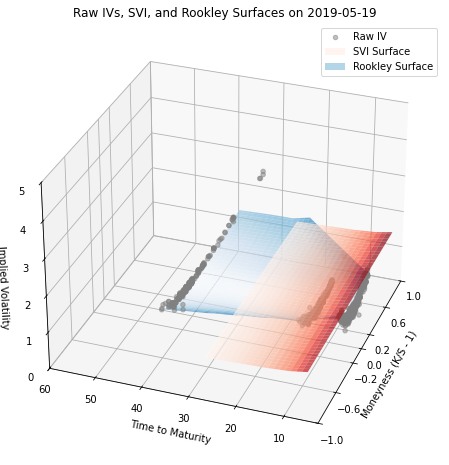

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


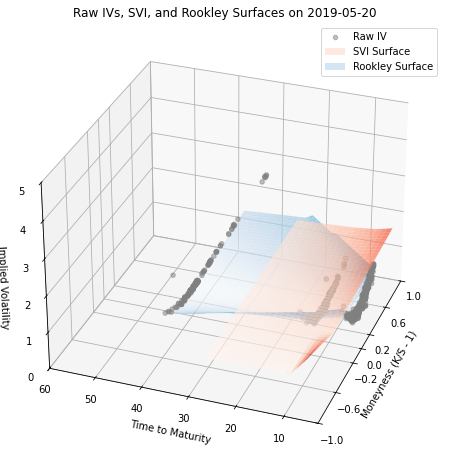

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


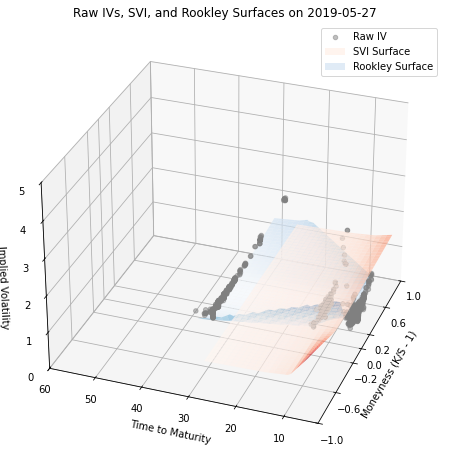

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


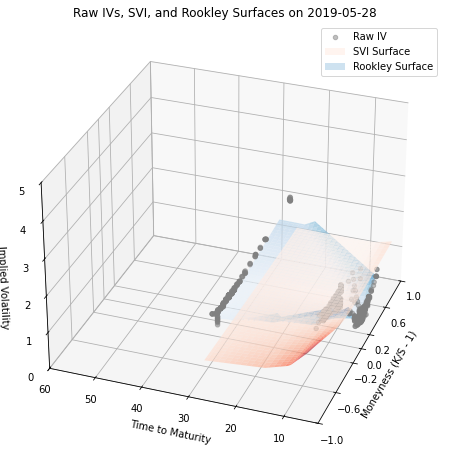

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


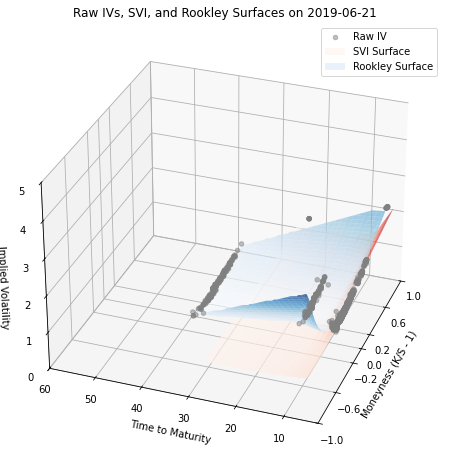

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


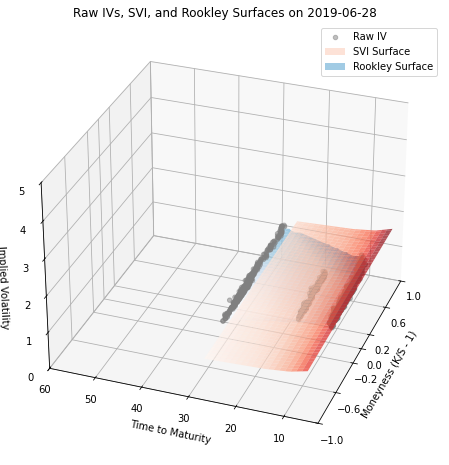

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


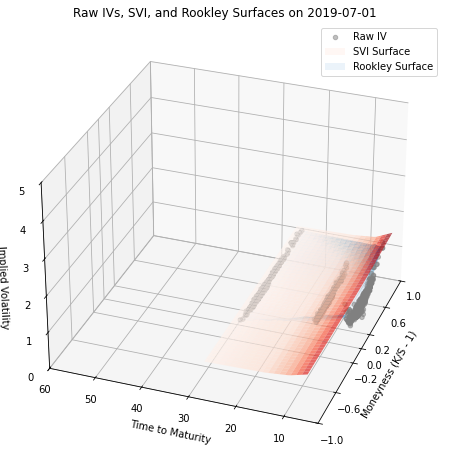

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


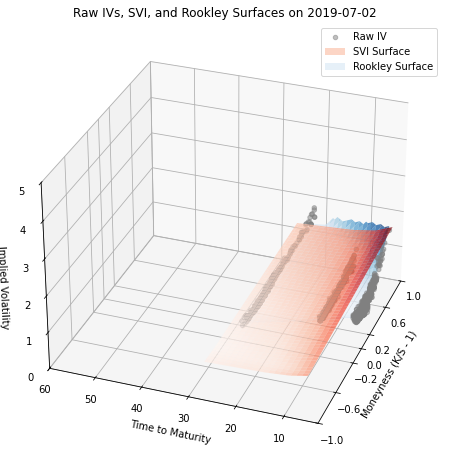

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


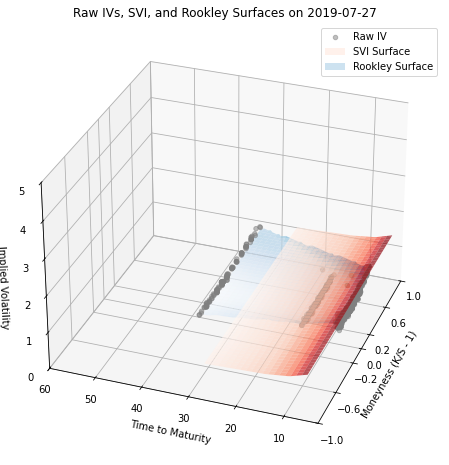

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


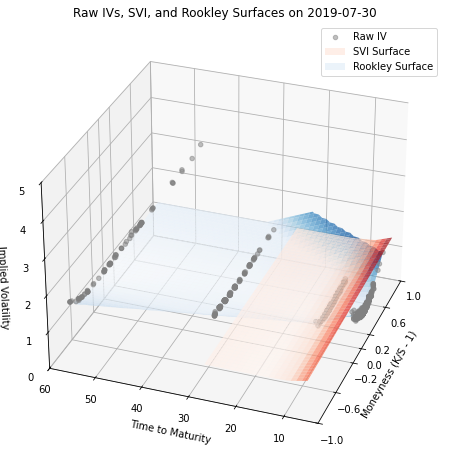

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


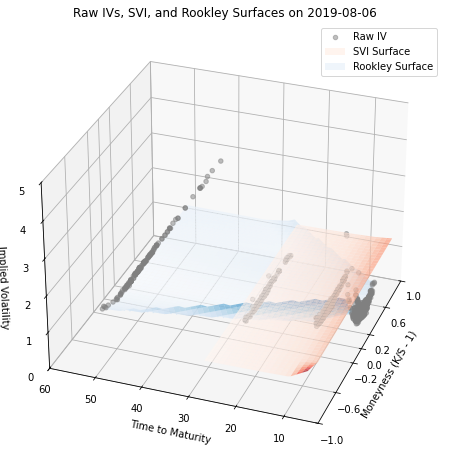

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


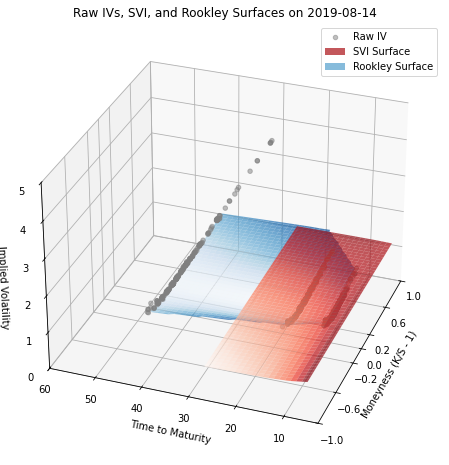

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


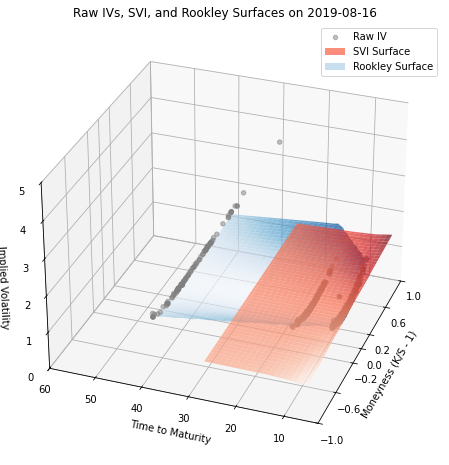

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


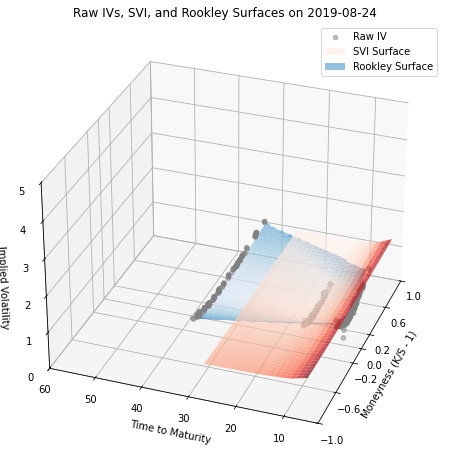

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


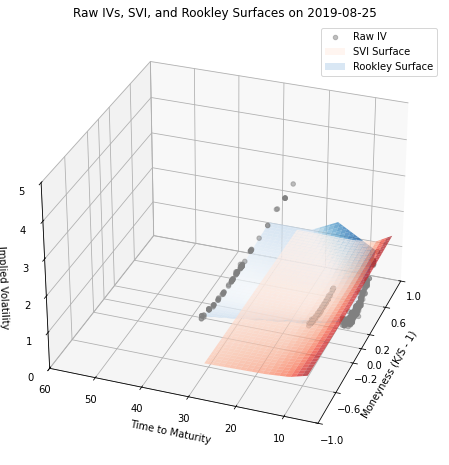

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


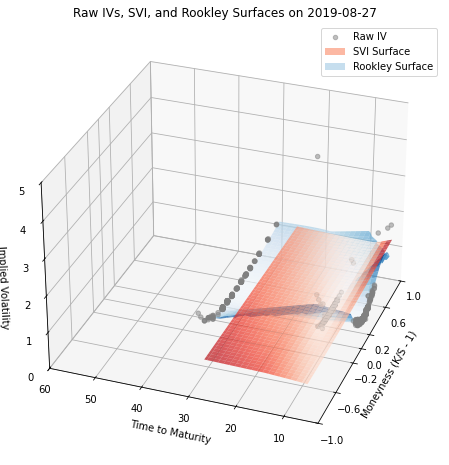

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


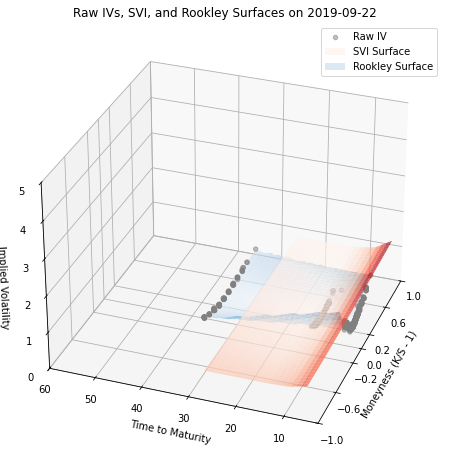

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


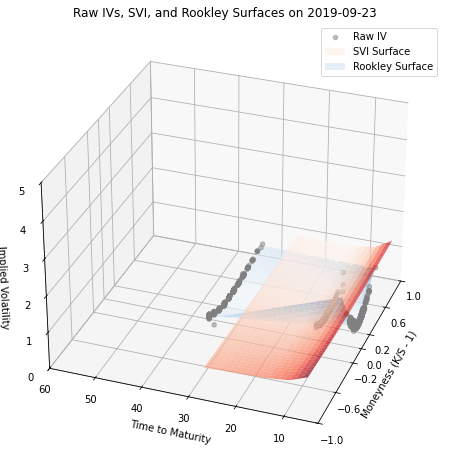

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


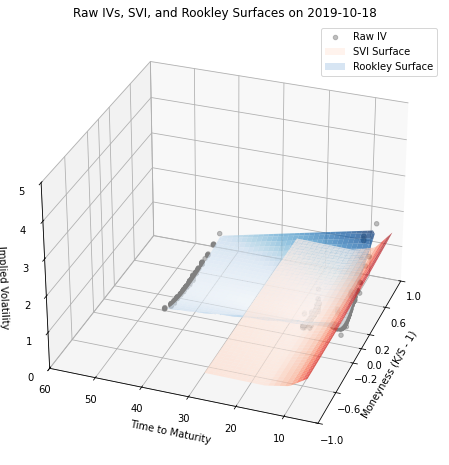

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


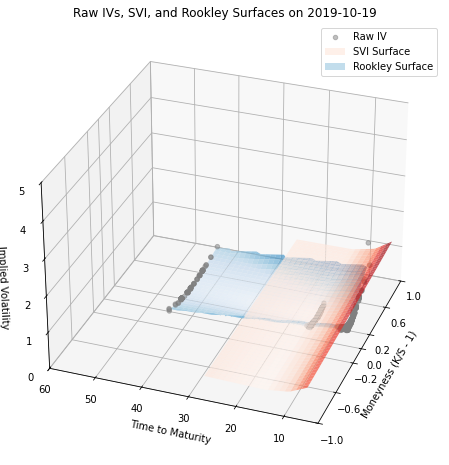

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


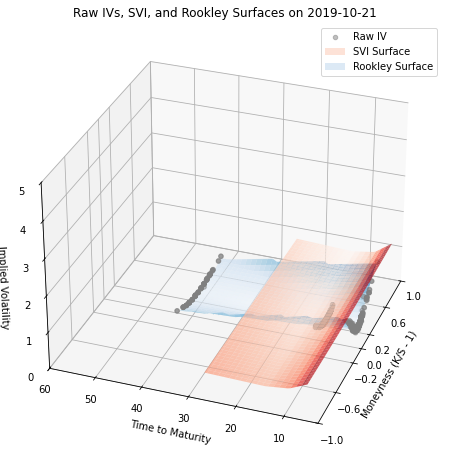

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


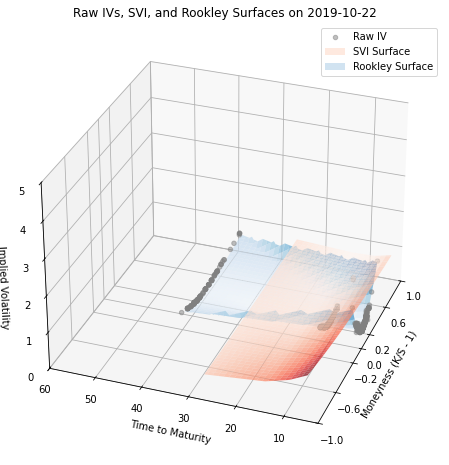

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


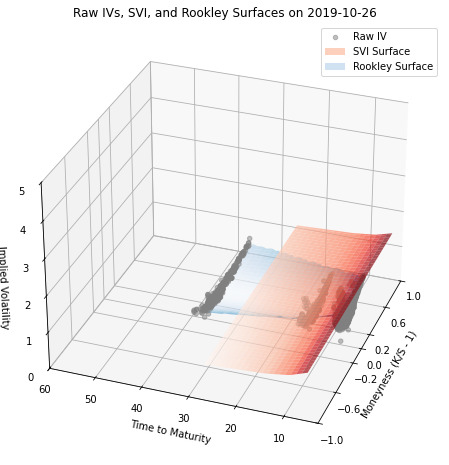

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


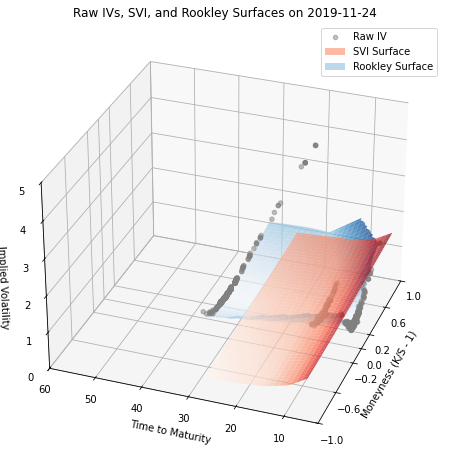

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


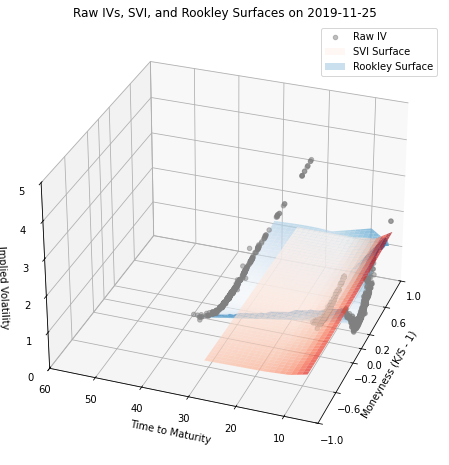

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


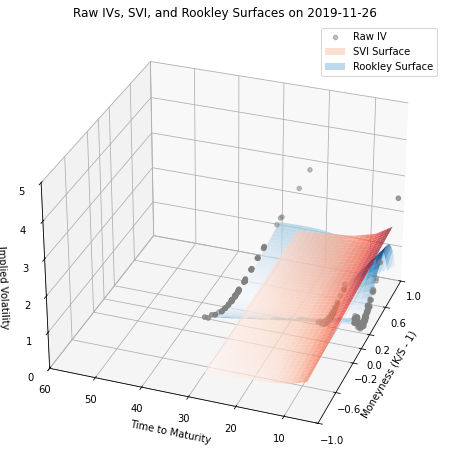

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


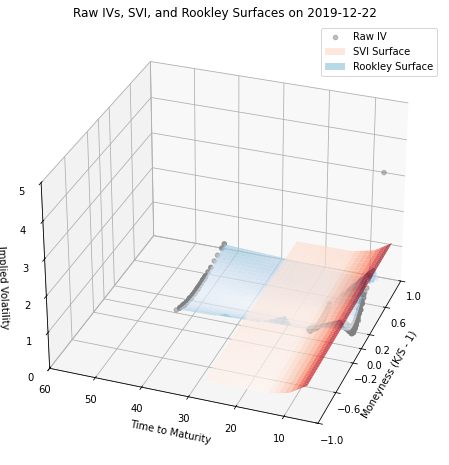

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


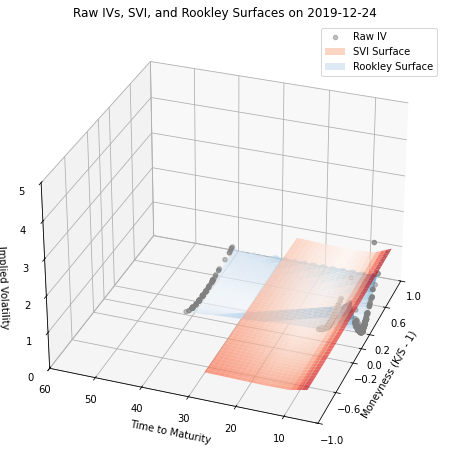

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


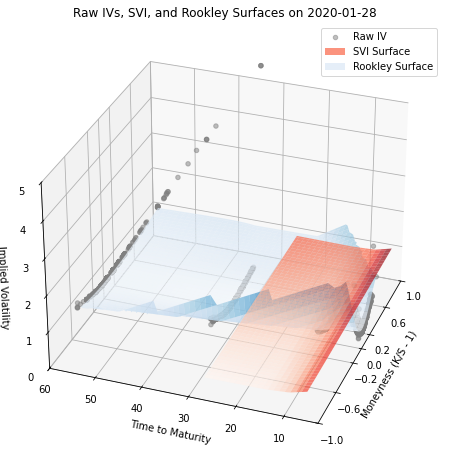

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


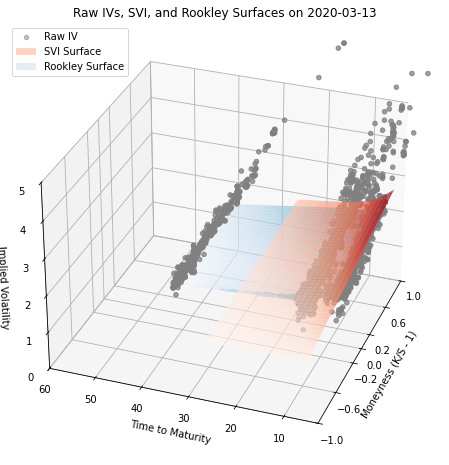

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


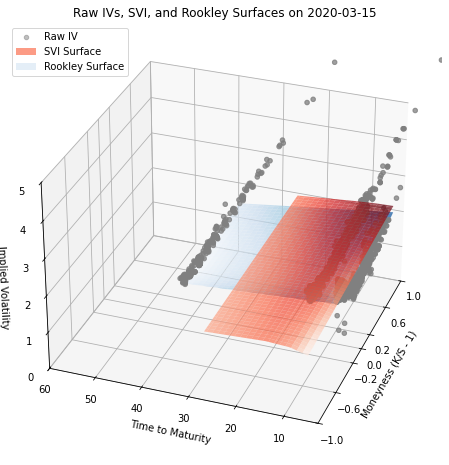

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


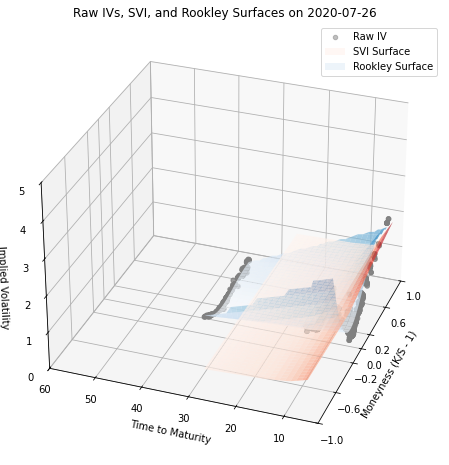

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


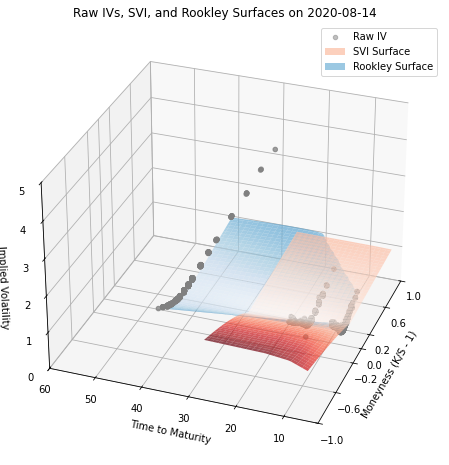

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:59: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig(path_to_save)
/opt/anaconda3/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


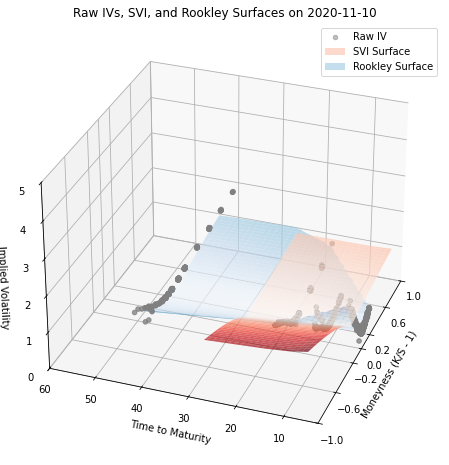

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


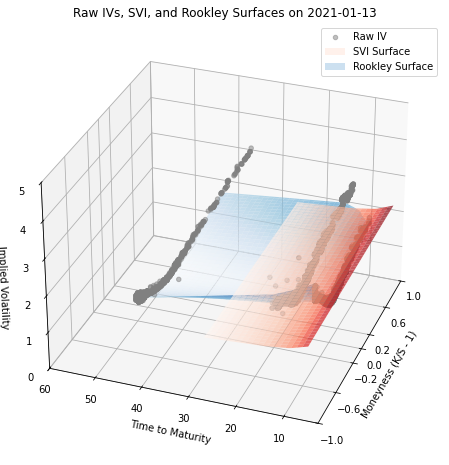

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


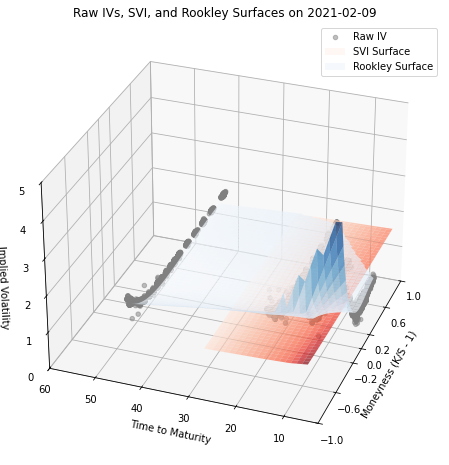

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


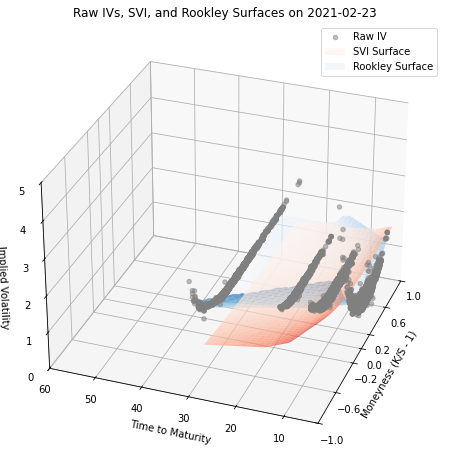

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


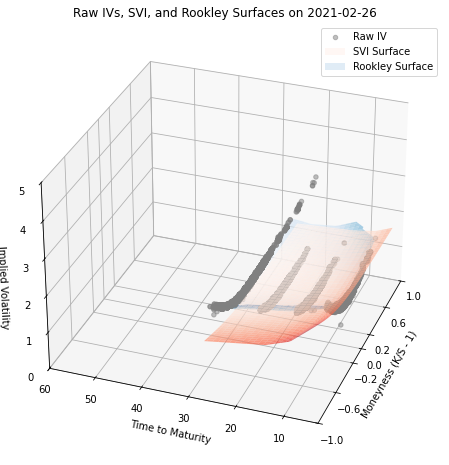

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


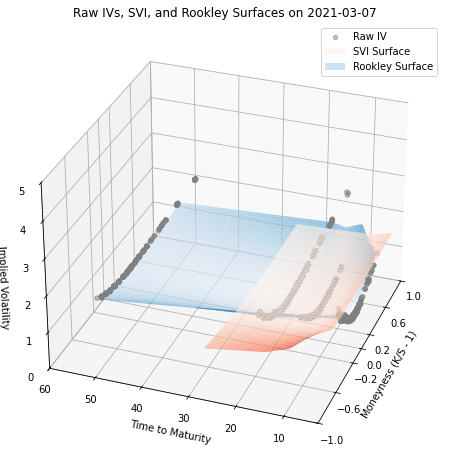

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


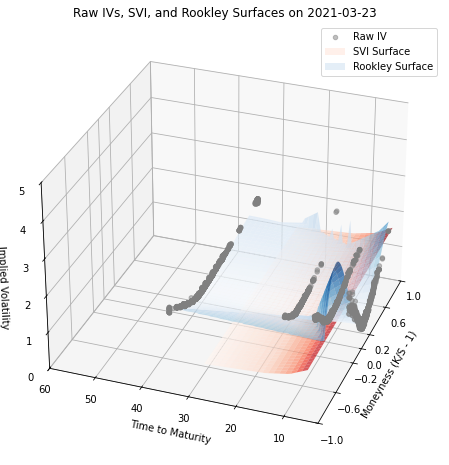

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


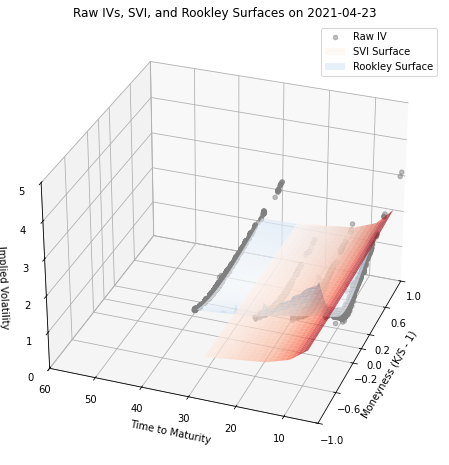

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


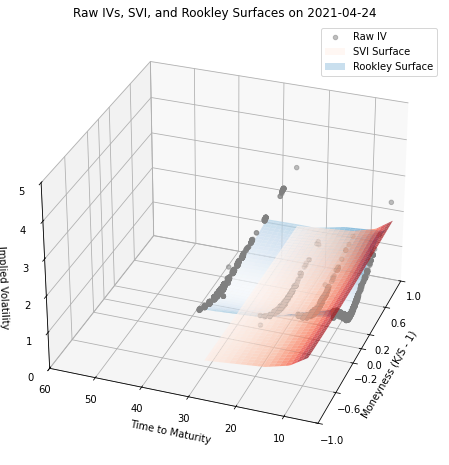

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


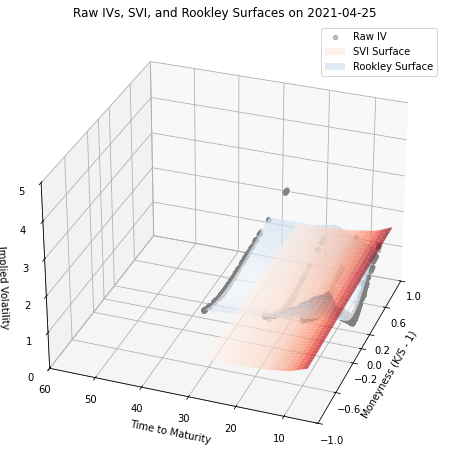

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


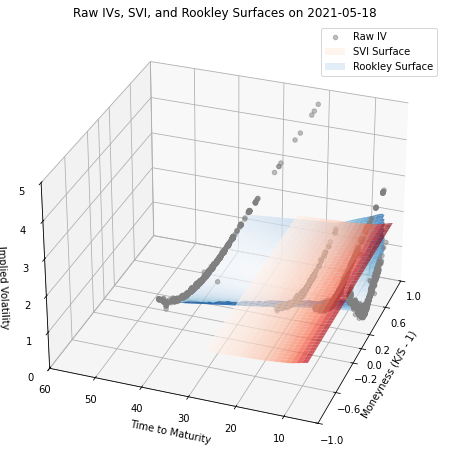

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


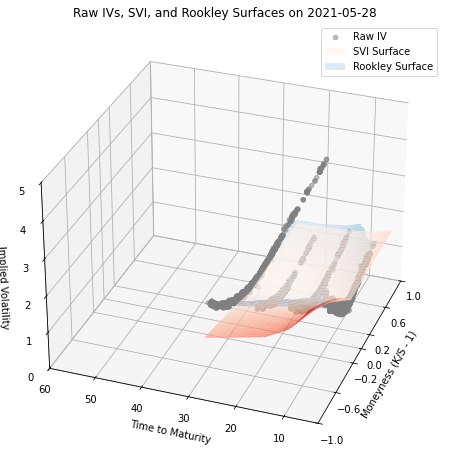

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


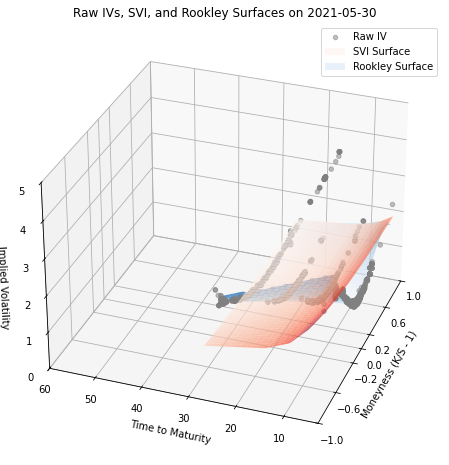

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


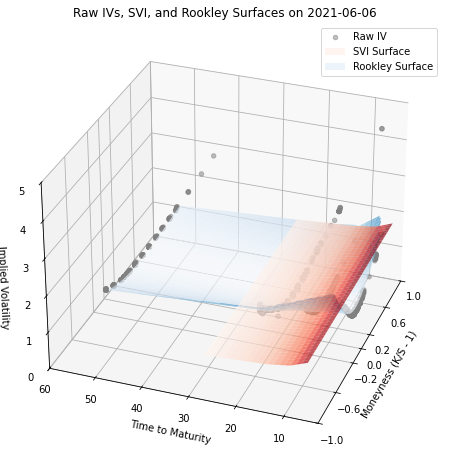

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


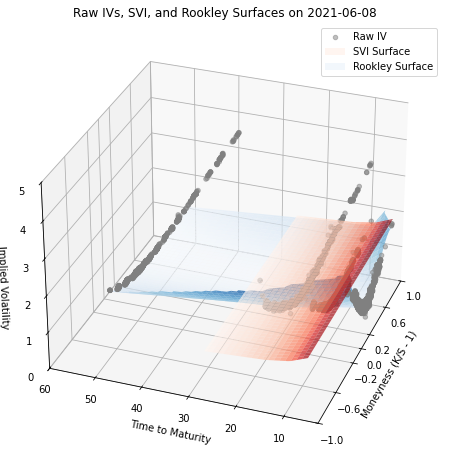

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


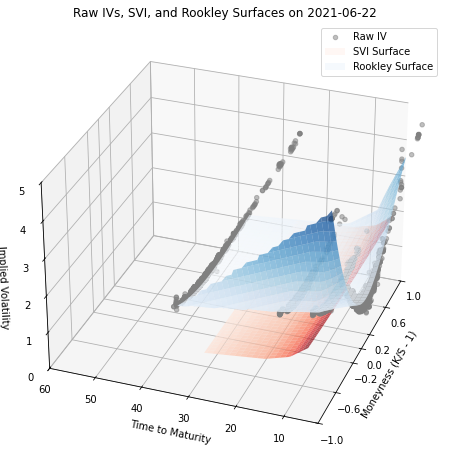

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


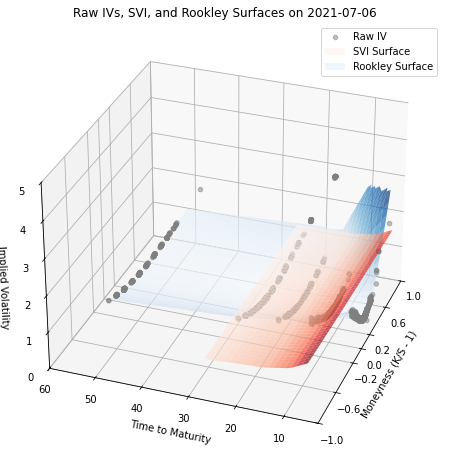

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


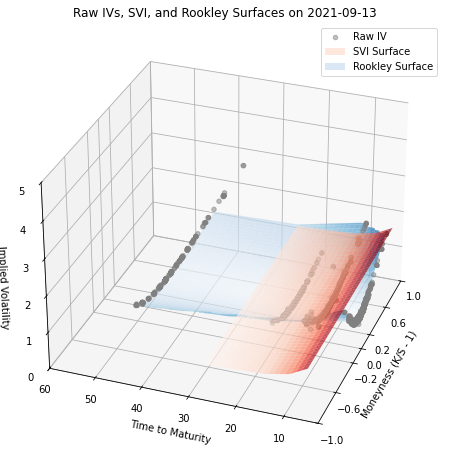

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


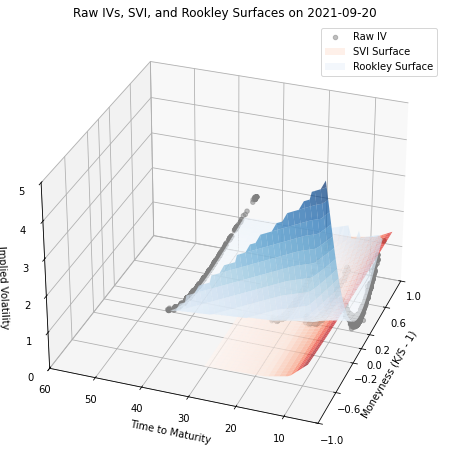

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


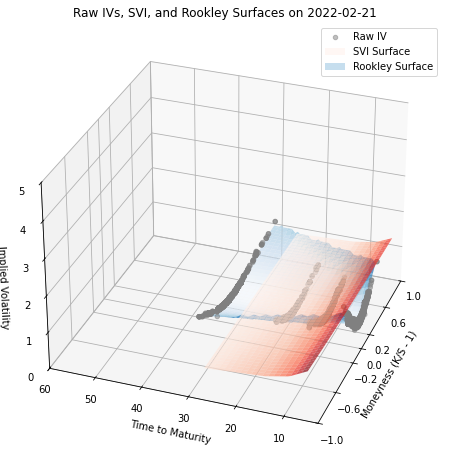

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


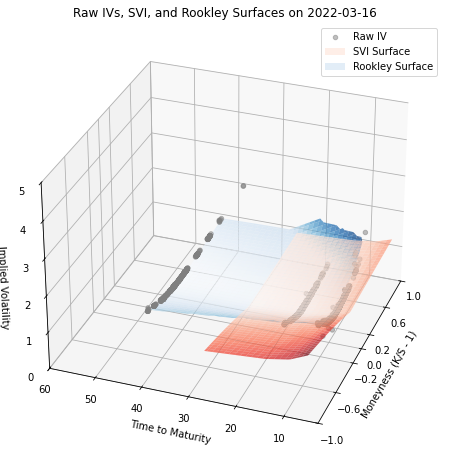

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


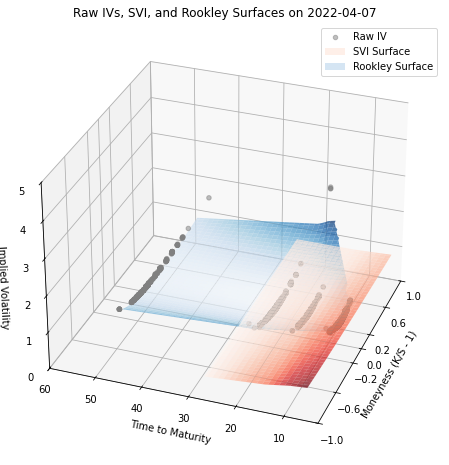

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


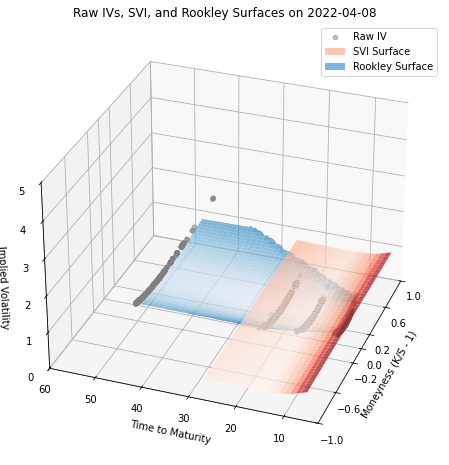

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


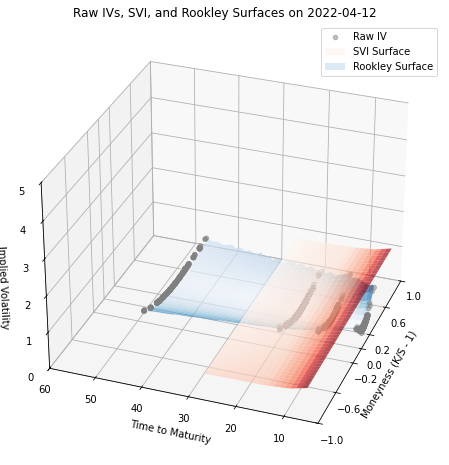

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


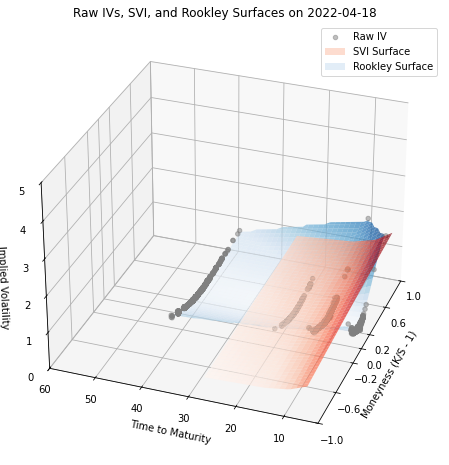

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


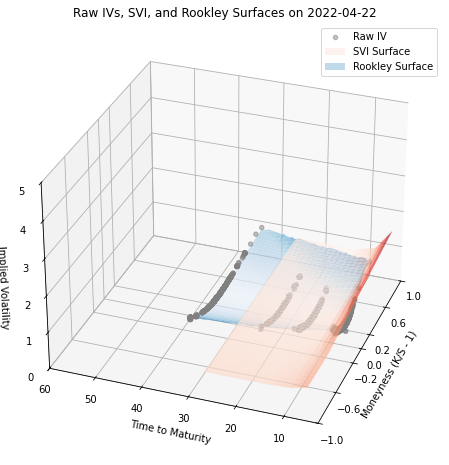

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


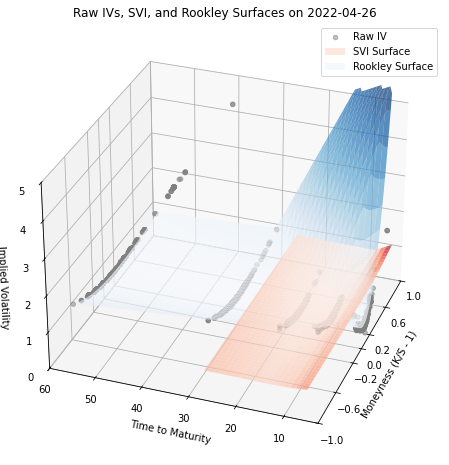

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


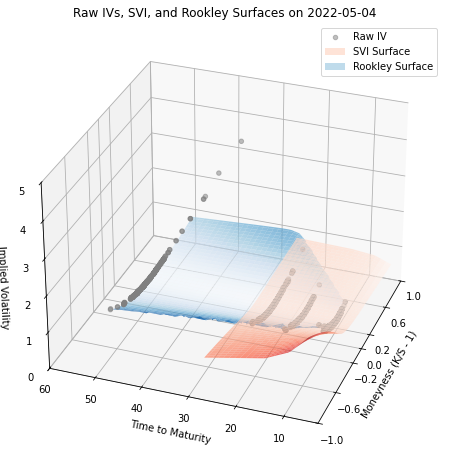

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


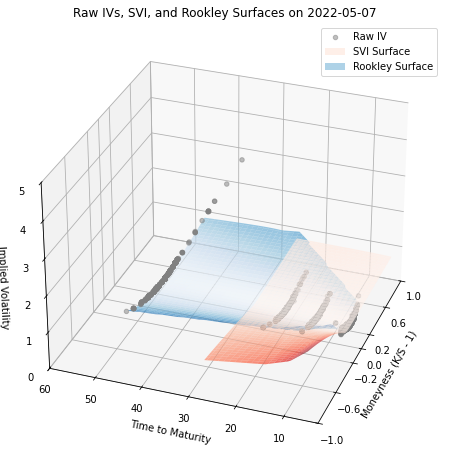

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


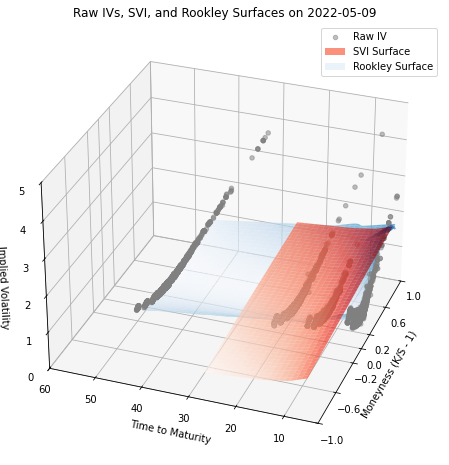

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


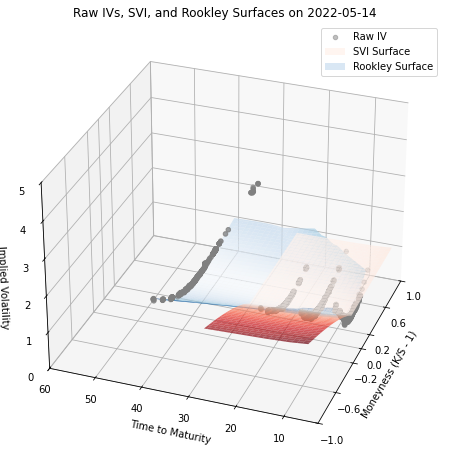

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


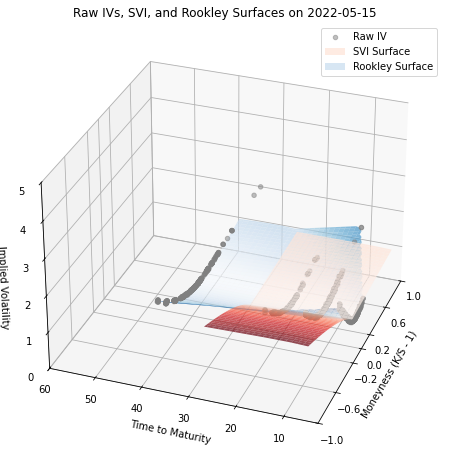

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


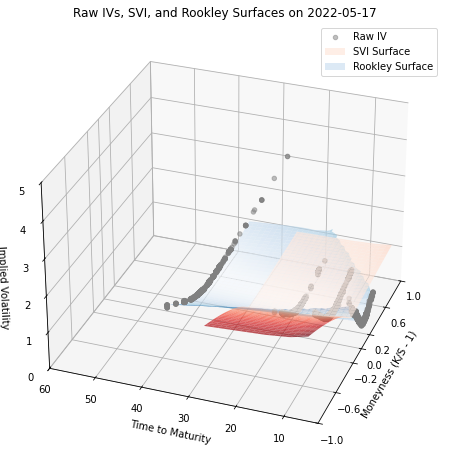

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


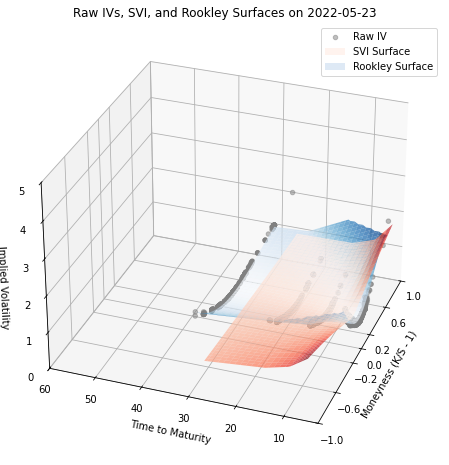

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


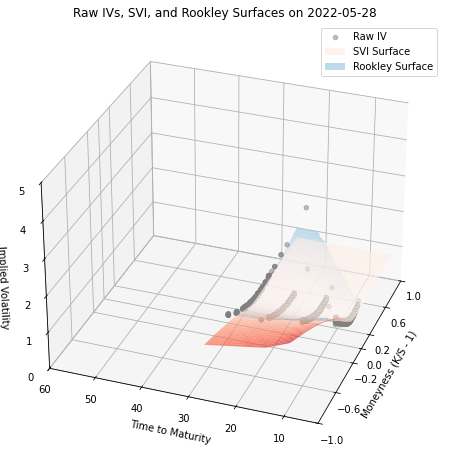

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


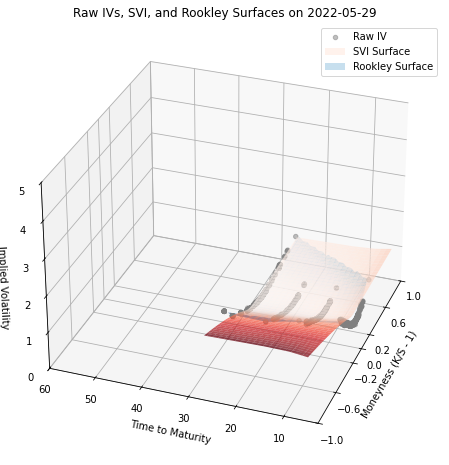

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


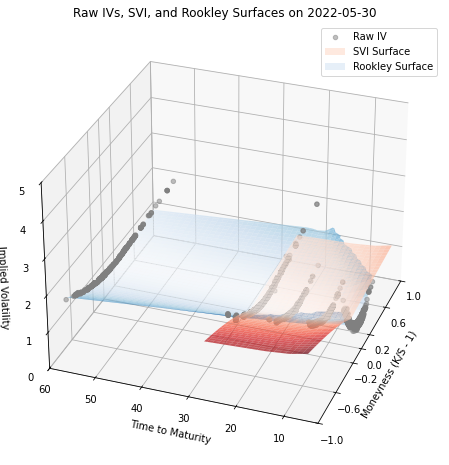

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


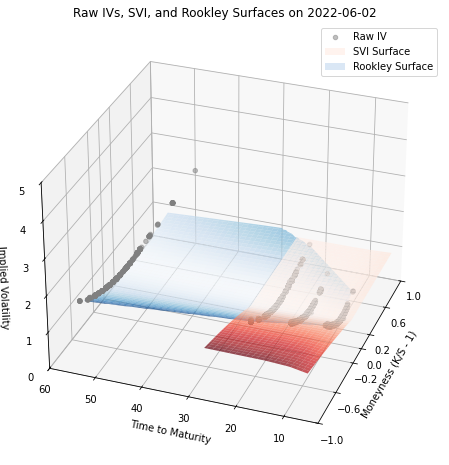

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


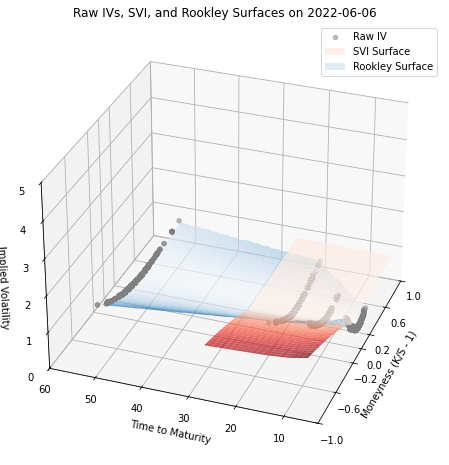

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


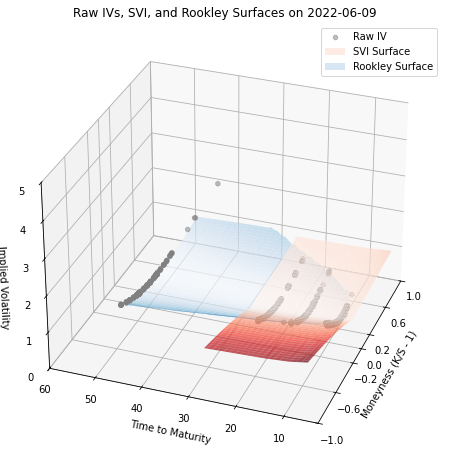

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


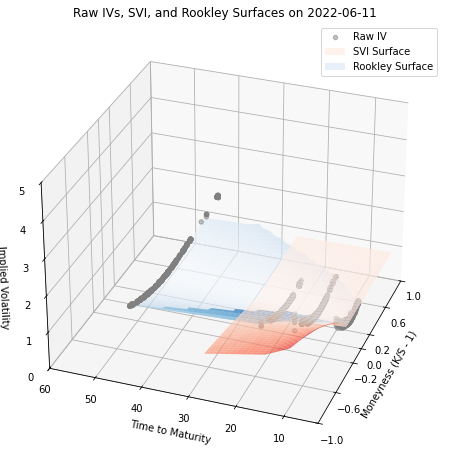

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


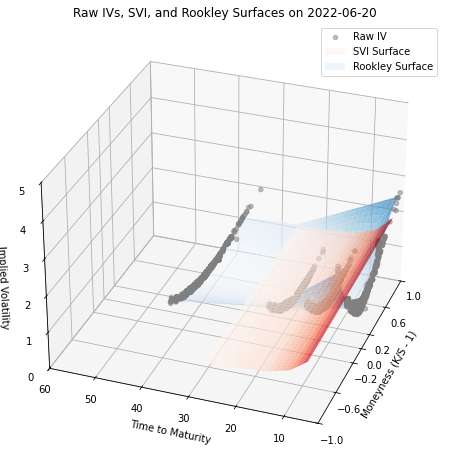

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


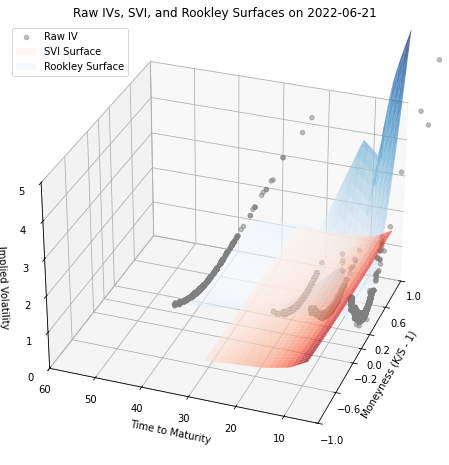

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


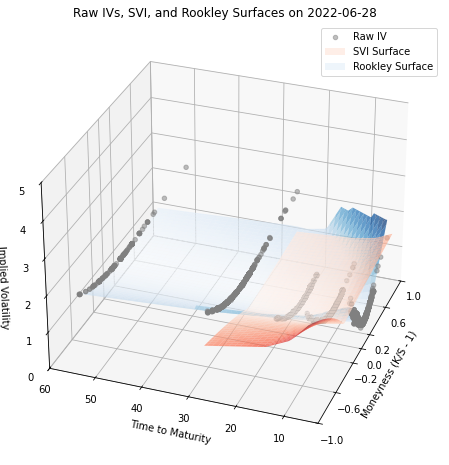

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


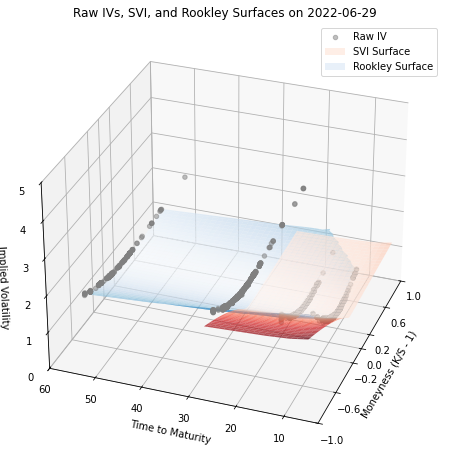

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


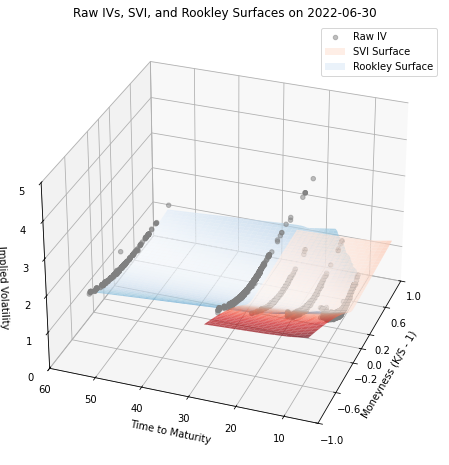

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


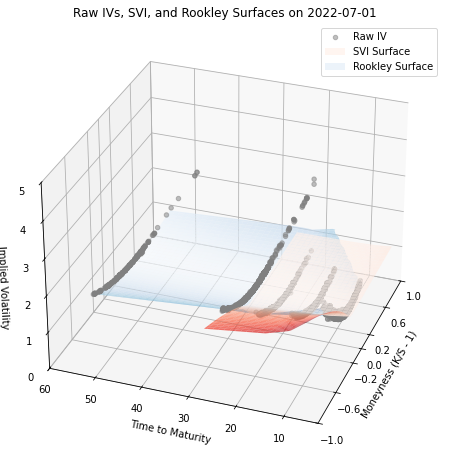

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


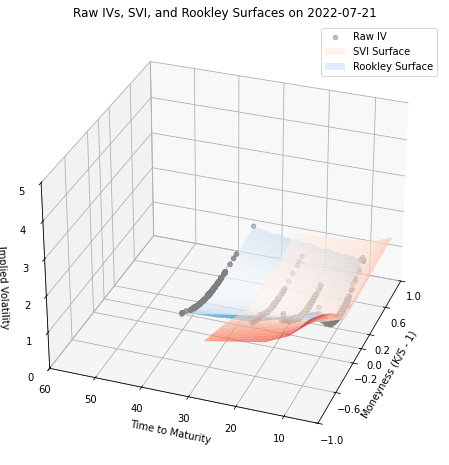

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


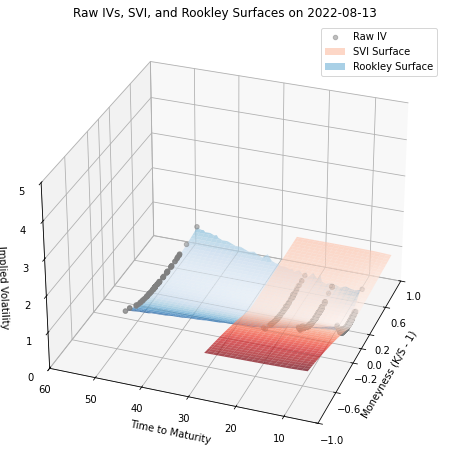

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


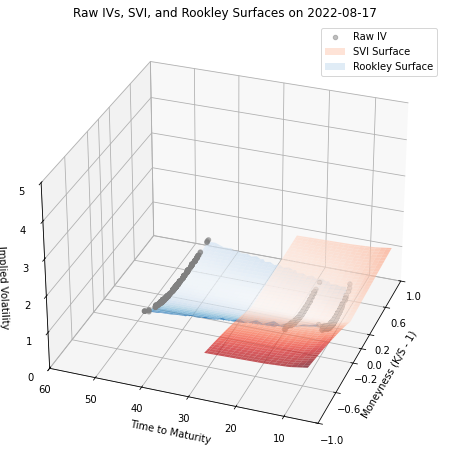

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


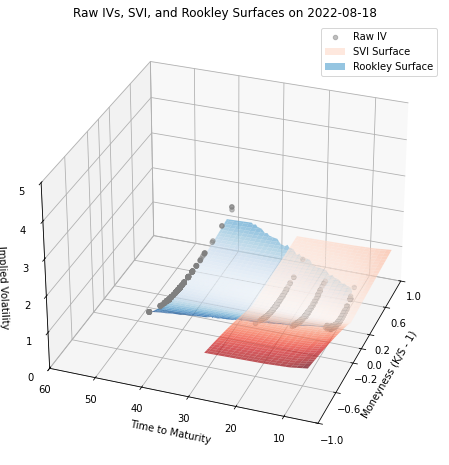

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


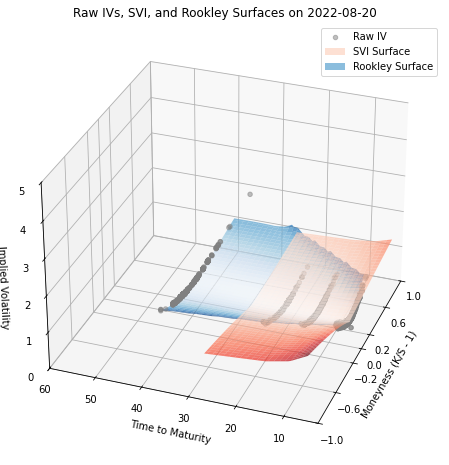

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


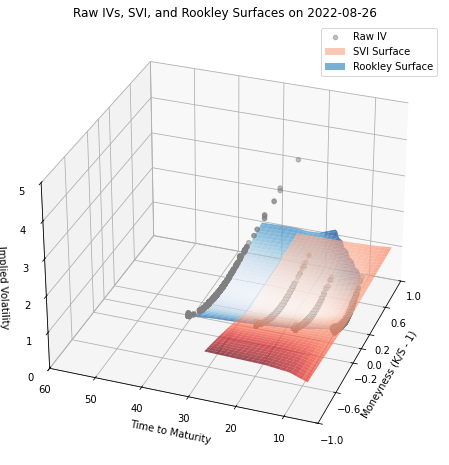

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


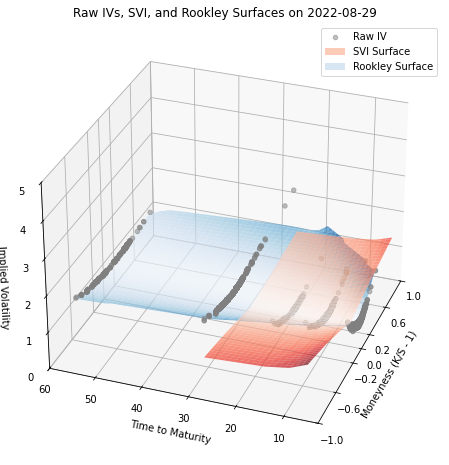

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


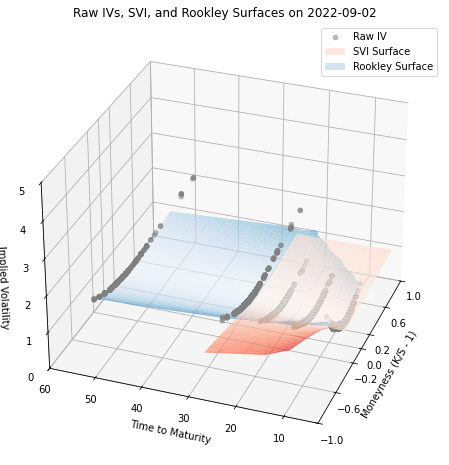

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


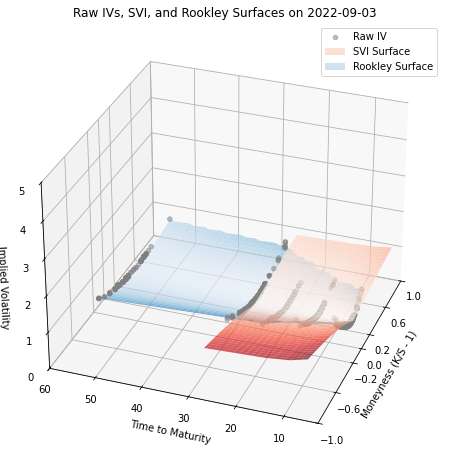

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


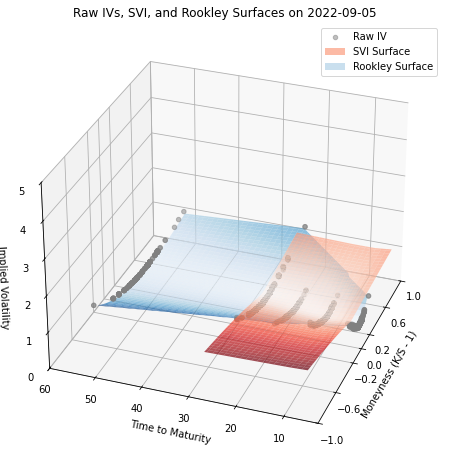

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


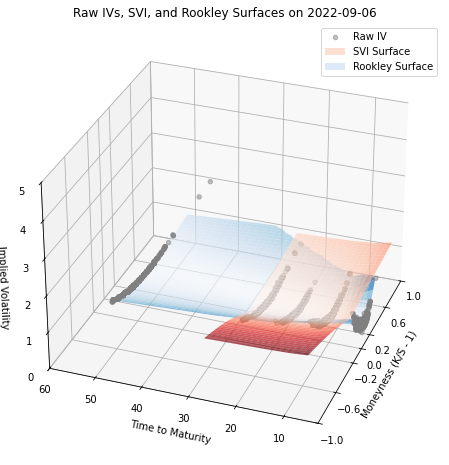

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


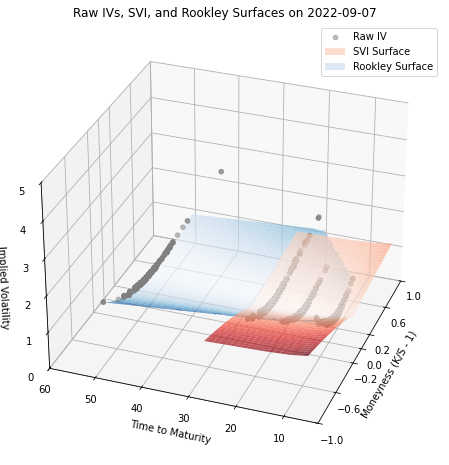

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


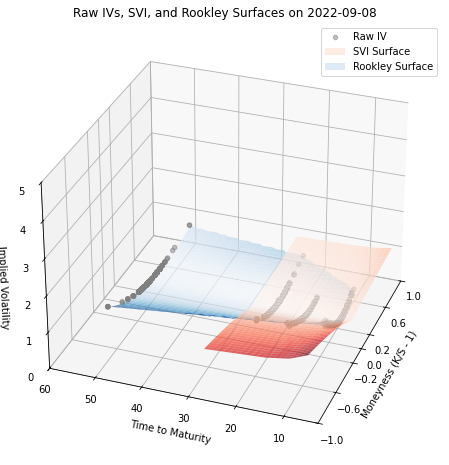

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


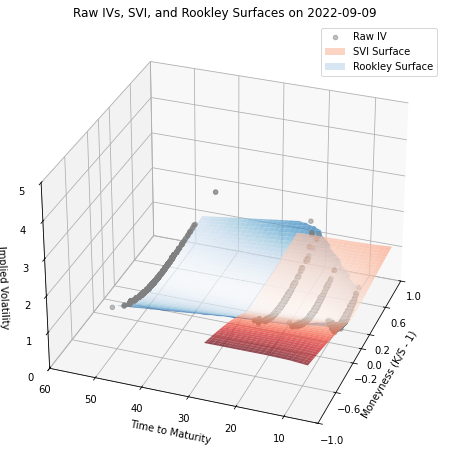

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


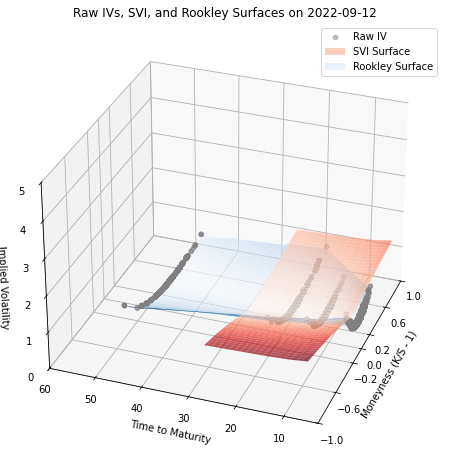

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


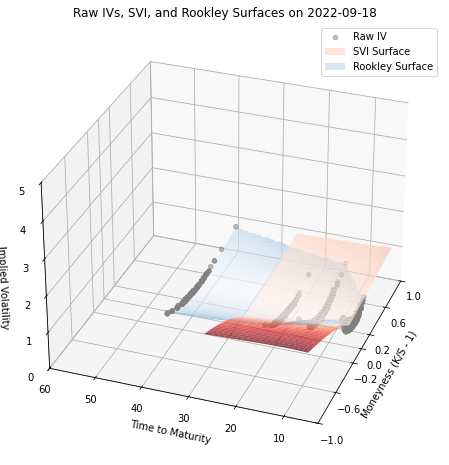

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


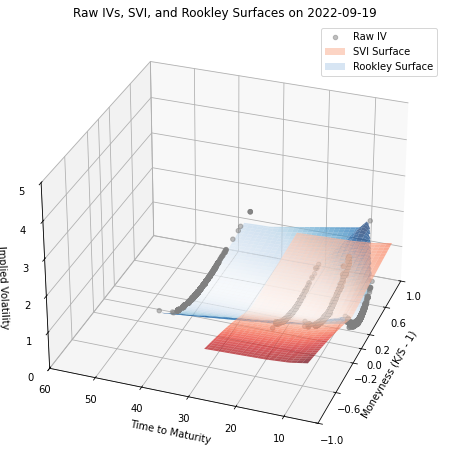

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


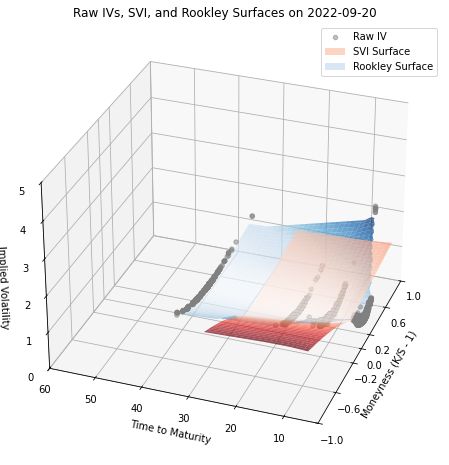

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


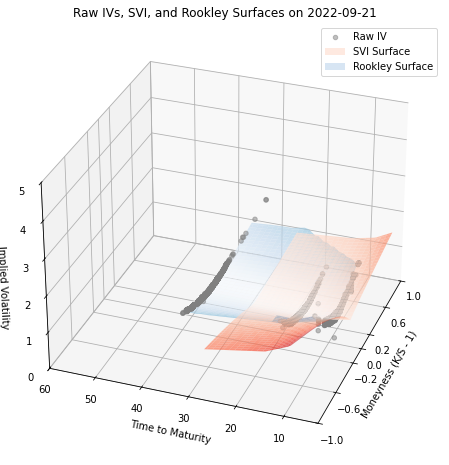

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


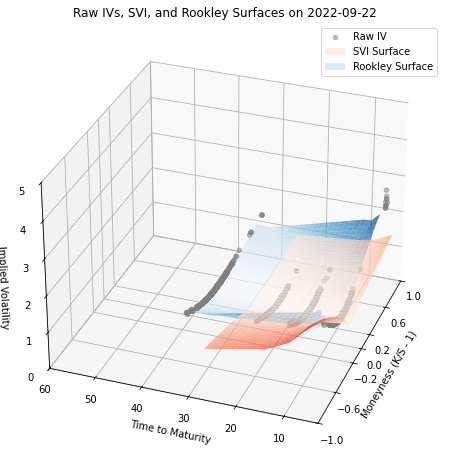

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


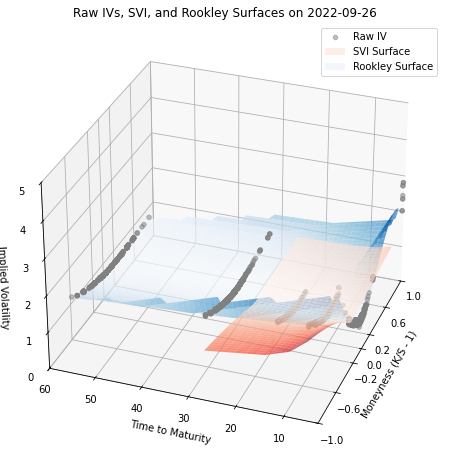

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


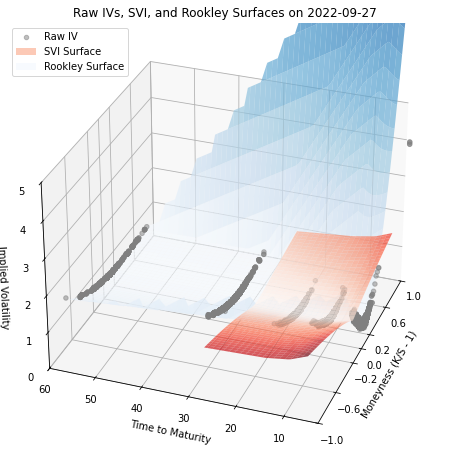

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


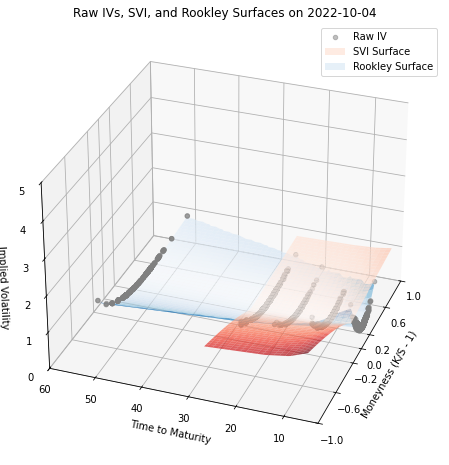

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


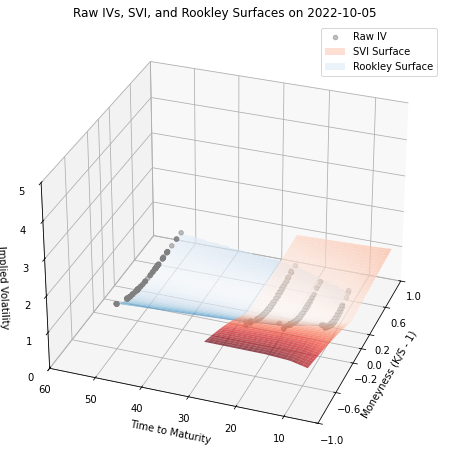

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


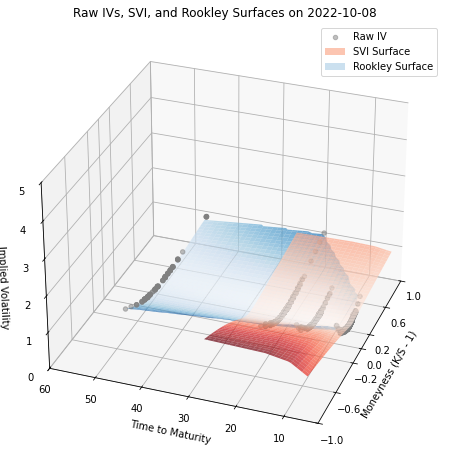

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


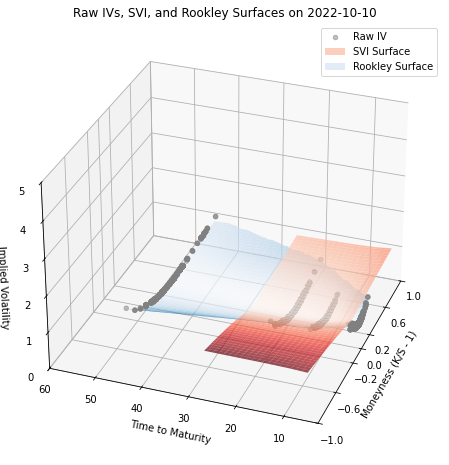

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


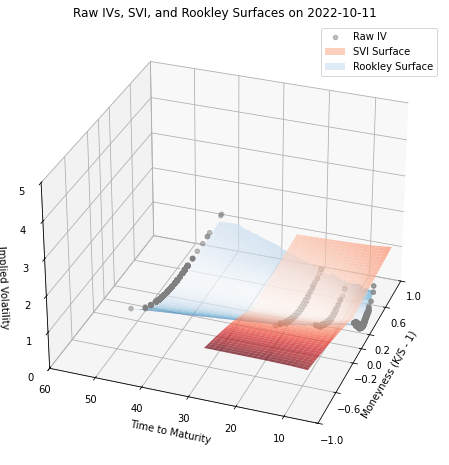

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


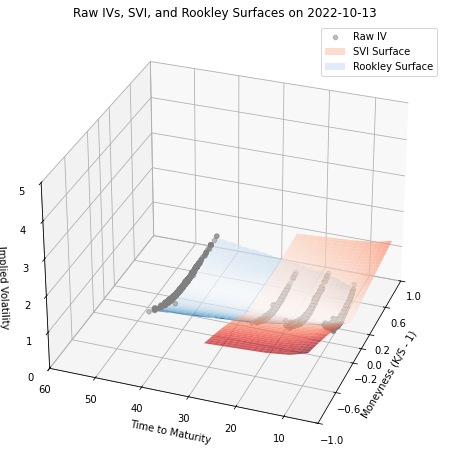

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


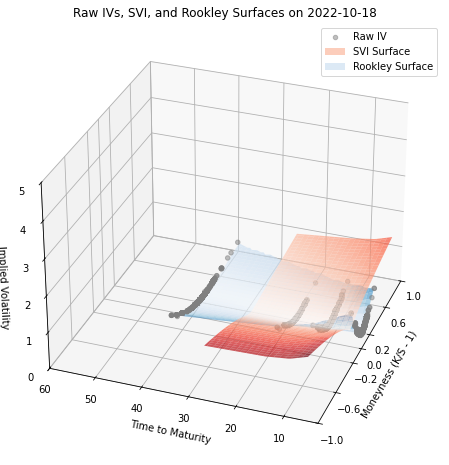

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


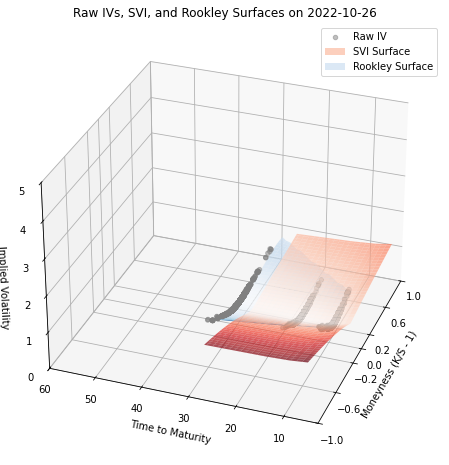

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/547175880.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


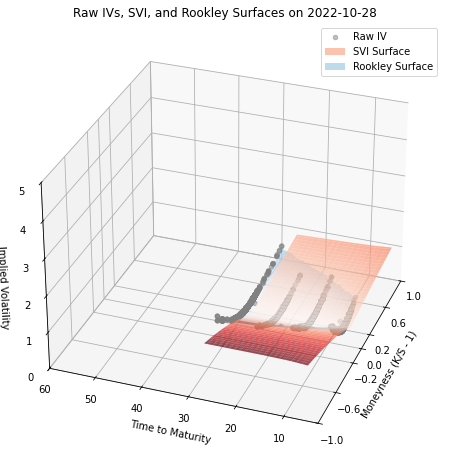

In [60]:
# Read the list of dates
common_dates = pd.read_csv('Clustering/common_dates_cluster_old_and_new.csv')['Date']

# Execute for each date
for date in common_dates:
    date = datetime.datetime.strptime(str(date), '%Y%m%d').strftime('%Y-%m-%d')
    plot_iv_3d_with_surfaces(df, date, svi_files, rookley_base_path="IV_Rookley")


## To plot implied volatilities against dates and moneyness, with time to maturity as input. 

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/2356173665.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['date'] = pd.to_datetime(df_filtered['date'])
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/2356173665.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['IV'] = df_filtered['IV'] / 100  # Convert IV to percentage
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/2356173665.py:76: UserWarning: set_ticklabels() should only be

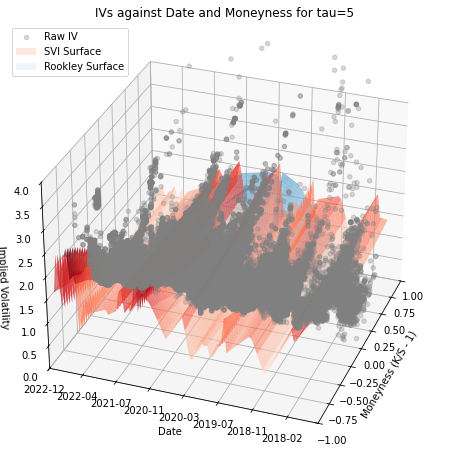

In [63]:
def load_svi_iv(file_path, date):
    df_svi = pd.read_csv(file_path)
    df_svi['Date'] = pd.to_datetime(df_svi['Date'])
    svi_row = df_svi[df_svi['Date'] == pd.to_datetime(date)]
    if svi_row.empty:
        return None
    svi_row = svi_row.drop(columns=['Date']).values.flatten()
    return svi_row

def load_rookley_iv_ttm(base_path, tau, dates):
    rookley_ivs = []
    for date in dates:
        folder = f'Rookley_Q_CB_1722_1_2_5_1_ttm{tau}'
        date = datetime.datetime.strptime(str(date), '%Y%m%d').strftime('%Y-%m-%d')
        file_path = os.path.join(base_path, folder, f'btc_pk_{date}_bw_0.3.csv')
        if os.path.exists(file_path):
            df_rookley = pd.read_csv(file_path)
            df_rookley['moneyness'] = df_rookley['m'] - 1
            df_rookley['IV'] = df_rookley['volatility']
            df_rookley['tau'] = tau
            df_rookley['date'] = pd.to_datetime(date).toordinal()
            df_rookley = df_rookley[['moneyness', 'IV', 'tau', 'date']]
            rookley_ivs.append((folder, df_rookley))
    return rookley_ivs

def plot_iv_against_date_and_moneyness(df, tau, svi_files, rookley_base_path):
    # Filter data for the specified time to maturity
    df_filtered = df[(df['tau'] == tau) & (df['tau'] >= 3) & (df['tau'] <= 60)]
    df_filtered['date'] = pd.to_datetime(df_filtered['date'])
    df_filtered['IV'] = df_filtered['IV'] / 100  # Convert IV to percentage

    if df_filtered.empty:
        print(f"No data available for tau={tau}.")
        return

    # Plot 3D scatter plot
    fig = plt.figure(figsize=(20, 8))
    ax = fig.add_subplot(111, projection='3d')
    ax.view_init(elev=30, azim=200)
    scatter = ax.scatter(df_filtered['moneyness'], df_filtered['date'].apply(lambda x: x.toordinal()), df_filtered['IV'], color='gray', alpha=0.3, label='Raw IV')

    # Prepare data for SVI surface
    svi_data = []
    # If tau in the keys of svi_files
    if tau in svi_files.keys():
        file = svi_files[tau]
        for date in pd.read_csv('Clustering/common_dates_cluster_old_and_new.csv')['Date']:
            date = datetime.datetime.strptime(str(date), '%Y%m%d')
            svi_iv = load_svi_iv(file, date)
            if svi_iv is not None:
                moneyness = np.arange(-1, 1.01, 0.01)
                svi_data.append(np.array([moneyness, [date.toordinal()]*len(moneyness), svi_iv]).T)
    svi_data = np.vstack(svi_data) 

    # Interpolate SVI surface if data exists
    if svi_data.size > 0:
        date_grid, mon_grid = np.mgrid[min(df_filtered['date']).toordinal():max(df_filtered['date']).toordinal():100j, -1:1:100j]
        svi_grid = griddata(svi_data[:, [1, 0]], svi_data[:, 2], (date_grid, mon_grid), method='linear')
        ax.plot_surface(mon_grid, date_grid, svi_grid, cmap='Reds', alpha=0.6, label='SVI Surface')

    # Prepare data for Rookley surface
    rookley_ivs = load_rookley_iv_ttm(rookley_base_path, tau, dates=pd.read_csv('Clustering/common_dates_cluster_old_and_new.csv')['Date'])
    rookley_data = np.vstack([df.values for _, df in rookley_ivs]) 
    if rookley_data.size > 0:
        rookley_grid = griddata(rookley_data[:, [0, 3]].astype(float), rookley_data[:, 1], (mon_grid, date_grid), method='linear')
        ax.plot_surface(mon_grid, date_grid, rookley_grid, cmap='Blues', alpha=0.6, label='Rookley Surface')

    ax.set_xlabel('Moneyness (K/S - 1)')
    ax.set_ylabel('Date')
    ax.set_zlabel('Implied Volatility', rotation=180)
    ax.set_title(f'IVs against Date and Moneyness for tau={tau}')
    ax.legend()
    ax.set_xlim(-1, 1)
    ax.set_ylim(min(df_filtered['date']).toordinal(), max(df_filtered['date']).toordinal())
    ax.set_zlim(0,4)
    ax.set_yticklabels([datetime.datetime.fromordinal(int(x)).strftime('%Y-%m') for x in ax.get_yticks()])

    # Save and show plot
    save_dir = 'IV_comparison/moneyness/IV_raw_svi_rookley/IV_surfaces_by_tau'
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    path_to_save = os.path.join(save_dir, f'IV_surface_tau_{tau}.png')
    plt.savefig(path_to_save)
    plt.show()

plot_iv_against_date_and_moneyness(df, 5, svi_files, rookley_base_path="IV_Rookley")

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/2465721465.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['date'] = pd.to_datetime(df_filtered['date'])
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/2465721465.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage


rookley_data is: [[-5.03976288e-01  1.63172934e+00  2.70000000e+01  7.37512000e+05]
 [-4.83613030e-01  1.59352844e+00  2.70000000e+01  7.37512000e+05]
 [-4.63249772e-01  1.55667316e+00  2.70000000e+01  7.37512000e+05]
 ...
 [ 7.54257623e-01  9.04366296e-01  2.70000000e+01  7.38401000e+05]
 [ 7.60595069e-01  9.09392751e-01  2.70000000e+01  7.38401000e+05]
 [ 7.66932514e-01  9.14430732e-01  2.70000000e+01  7.38401000e+05]]


/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/2465721465.py:96: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([datetime.datetime.fromordinal(int(x)).strftime('%Y-%m') for x in ax.get_yticks()])
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/2465721465.py:96: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([datetime.datetime.fromordinal(int(x)).strftime('%Y-%m') for x in ax.get_yticks()])


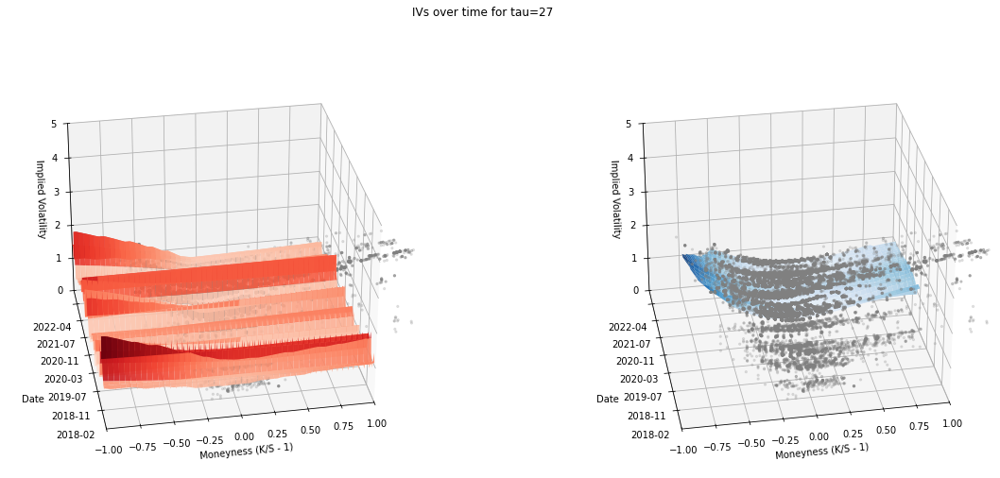

In [83]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import numpy as np
import os
import datetime
from scipy.interpolate import griddata


def load_svi_iv(file_path, date):
    df_svi = pd.read_csv(file_path)
    df_svi['Date'] = pd.to_datetime(df_svi['Date'])
    svi_row = df_svi[df_svi['Date'] == pd.to_datetime(date)]
    if svi_row.empty:
        return None
    svi_row = svi_row.drop(columns=['Date']).values.flatten()
    return svi_row


def load_rookley_iv_ttm(base_path, tau, dates):
    rookley_ivs = []
    for date in dates:
        folder = f'Rookley_Q_CB_1722_1_2_5_1_ttm{tau}'
        date = datetime.datetime.strptime(str(date), '%Y%m%d').strftime('%Y-%m-%d')
        file_path = os.path.join(base_path, folder, f'btc_pk_{date}_bw_0.3.csv')
        if os.path.exists(file_path):
            df_rookley = pd.read_csv(file_path)
            df_rookley['moneyness'] = df_rookley['m'] - 1
            df_rookley['IV'] = df_rookley['volatility']
            df_rookley['tau'] = tau
            df_rookley['date'] = pd.to_datetime(date).toordinal()
            df_rookley = df_rookley[['moneyness', 'IV', 'tau', 'date']]
            rookley_ivs.append((folder, df_rookley))
    return rookley_ivs


def plot_iv_against_date_and_moneyness(df, tau, svi_files, rookley_base_path):
    # Filter data for the specified time to maturity
    df_filtered = df[(df['tau'] == tau) & (df['tau'] >= 3) & (df['tau'] <= 60)]
    df_filtered['date'] = pd.to_datetime(df_filtered['date'])
    df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage

    if df_filtered.empty:
        print(f"No data available for tau={tau}.")
        return

    # Plot 3D scatter plot
    fig, axs = plt.subplots(1, 2, figsize=(20, 8), subplot_kw={'projection': '3d'})
    fig.suptitle(f'IVs over time for tau={tau}')
    for ax, title, cmap in zip(axs, ['SVI Surface', 'Rookley Surface'], ['Reds', 'Blues']):
        ax.view_init(elev=30, azim=260)
        ax.scatter(df_filtered['moneyness'], df_filtered['date'].apply(lambda x: x.toordinal()), df_filtered['IV'], color='gray', s=5, alpha=0.2, label='Raw IV')

    # Prepare data for SVI surface
    svi_data = []
    if tau in svi_files.keys():
        file = svi_files[tau]
        for date in pd.read_csv('Clustering/common_dates_cluster.csv')['Date']:
            date = datetime.datetime.strptime(str(date), '%Y%m%d')
            svi_iv = load_svi_iv(file, date)
            if svi_iv is not None:
                moneyness = np.arange(-1, 1.01, 0.01)
                svi_data.append(np.array([moneyness, [date.toordinal()]*len(moneyness), svi_iv]).T)
    svi_data = np.vstack(svi_data) 

    # Check for negative IVs in SVI data
    if np.any(svi_data[:, 2] < 0):
        print(f"Warning: Negative IVs detected in SVI data for tau={tau}")

    # Interpolate SVI surface if data exists
    if svi_data.size > 0:
        date_grid, mon_grid = np.mgrid[min(df_filtered['date']).toordinal():max(df_filtered['date']).toordinal():100j, -1:1:100j]
        svi_grid = griddata(svi_data[:, [1, 0]], svi_data[:, 2], (date_grid, mon_grid), method='linear')
        axs[0].plot_surface(mon_grid, date_grid, svi_grid, cmap='Reds', alpha=0.9, label='SVI Surface')

    # Prepare data for Rookley surface
    rookley_ivs = load_rookley_iv_ttm(rookley_base_path, tau, dates=pd.read_csv('Clustering/common_dates_cluster_old.csv')['Date'])
    rookley_data = np.vstack([df.values for _, df in rookley_ivs]) if rookley_ivs else np.empty((0, 4))

    # Check for negative IVs in Rookley data
    if np.any(rookley_data[:, 1] < 0):
        print(f"Warning: Negative IVs detected in Rookley data for tau={tau}")

    print("rookley_data is:", rookley_data)
    if rookley_data.size > 0:
        rookley_grid = griddata(rookley_data[:, [0, 3]].astype(float), rookley_data[:, 1], (mon_grid, date_grid), method='linear')
        axs[1].plot_surface(mon_grid, date_grid, rookley_grid, cmap='Blues', alpha=0.9, label='Rookley Surface')

    for ax in axs:
        ax.set_xlabel('Moneyness (K/S - 1)')
        ax.set_ylabel('Date', labelpad=30)
        ax.set_zlabel('Implied Volatility', rotation=180)
        ax.set_xlim(-1, 1)
        ax.set_ylim(min(df_filtered['date']).toordinal(), max(df_filtered['date']).toordinal())
        ax.set_zlim(0, 5)
        ax.set_yticklabels([datetime.datetime.fromordinal(int(x)).strftime('%Y-%m') for x in ax.get_yticks()])
        ax.tick_params(axis='y', pad=15)

    # Save and show plot
    save_dir = 'IV_comparison/moneyness/IV_raw_svi_rookley/IV_surfaces_by_tau'
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    path_to_save = os.path.join(save_dir, f'IV_surface_subbplot_tau_{tau}.png')
    plt.savefig(path_to_save)
    plt.show()

plot_iv_against_date_and_moneyness(df, 27, svi_files, rookley_base_path="IV_Rookley")

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['date'] = pd.to_datetime(df_filtered['date'])
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:94: UserWarning: set_ticklabels() should only be used 

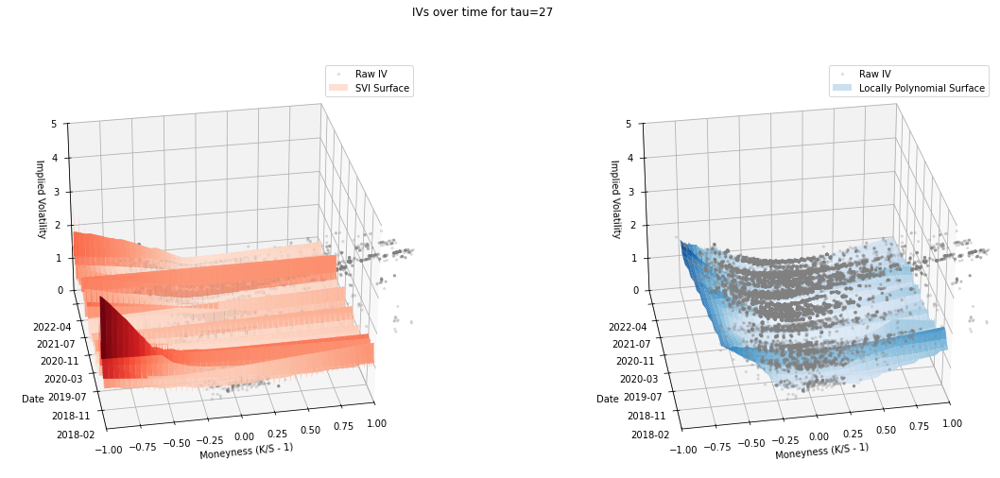

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import numpy as np
import os
import datetime
from scipy.interpolate import griddata


def load_svi_iv_ttm(file_path):
    svi_data = []
    df_svi = pd.read_csv(file_path)
    df_svi['Date'] = pd.to_datetime(df_svi['Date'])
    for date in df_svi['Date']:
        date = datetime.datetime.strptime(str(date), '%Y-%m-%d %H:%M:%S')
        svi_row = df_svi[df_svi['Date'] == pd.to_datetime(date)]
        svi_row = svi_row.drop(columns=['Date']).values.flatten()
        if svi_row is not None:
            moneyness = np.arange(-1, 1.01, 0.01)
            svi_data.append(np.array([moneyness, [date.toordinal()]*len(moneyness), svi_row]).T)
    return svi_data


def load_rookley_iv_ttm(base_path, tau):
    rookley_ivs = []
    folder = f'Rookley_Q_CB_1722_1_2_5_1_ttm{tau}'
    for file in os.listdir(os.path.join(base_path, folder)):
        if file.startswith('btc_pk_') and file.endswith('_bw_0.3.csv'):
            date = file.split('_')[2]
            file_path = os.path.join(base_path, folder, file)
            if os.path.exists(file_path):
                df_rookley = pd.read_csv(file_path)
                df_rookley['moneyness'] = df_rookley['m'] - 1
                df_rookley['IV'] = df_rookley['volatility']
                df_rookley['tau'] = tau
                df_rookley['date'] = pd.to_datetime(date).toordinal()
                df_rookley = df_rookley[['moneyness', 'IV', 'tau', 'date']]
                rookley_ivs.append((folder, df_rookley))
    return rookley_ivs

def plot_iv_against_date_and_moneyness(df, tau, svi_files, rookley_base_path):
    # Filter data for the specified time to maturity
    df_filtered = df[(df['tau'] == tau) & (df['tau'] >= 3) & (df['tau'] <= 60)]
    df_filtered['date'] = pd.to_datetime(df_filtered['date'])
    df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage

    if df_filtered.empty:
        print(f"No data available for tau={tau}.")
        return

    # Plot 3D scatter plot
    fig, axs = plt.subplots(1, 2, figsize=(20, 8), subplot_kw={'projection': '3d'})
    fig.suptitle(f'IVs over time for tau={tau}')
    for ax, title, cmap in zip(axs, ['SVI Surface', 'Rookley Surface'], ['Reds', 'Blues']):
        ax.view_init(elev=30, azim=260)
        ax.scatter(df_filtered['moneyness'], df_filtered['date'].apply(lambda x: x.toordinal()), df_filtered['IV'], color='gray', s=5, alpha=0.2, label='Raw IV')

    # Prepare data for SVI surface
    svi_data = []
    if tau in svi_files.keys():
        file = svi_files[tau]
        svi_data = load_svi_iv_ttm(file)
    svi_data = np.vstack(svi_data) 

    # Check for negative IVs in SVI data
    if np.any(svi_data[:, 2] < 0):
        print(f"Warning: Negative IVs detected in SVI data for tau={tau}")

    # Interpolate SVI surface if data exists
    if svi_data.size > 0:
        date_grid, mon_grid = np.mgrid[min(df_filtered['date']).toordinal():max(df_filtered['date']).toordinal():100j, -1:1:100j]
        svi_grid = griddata(svi_data[:, [1, 0]], svi_data[:, 2], (date_grid, mon_grid), method='linear')
        axs[0].plot_surface(mon_grid, date_grid, svi_grid, cmap='Reds', alpha=0.9, label='SVI Surface')

    # Prepare data for Rookley surface
    rookley_ivs = load_rookley_iv_ttm(rookley_base_path, tau)
    rookley_data = np.vstack([df.values for _, df in rookley_ivs]) if rookley_ivs else np.empty((0, 4))

    # Check for negative IVs in Rookley data
    if np.any(rookley_data[:, 1] < 0):
        print(f"Warning: Negative IVs detected in Rookley data for tau={tau}")

    if rookley_data.size > 0:
        rookley_grid = griddata(rookley_data[:, [0, 3]].astype(float), rookley_data[:, 1], (mon_grid, date_grid), method='linear')
        axs[1].plot_surface(mon_grid, date_grid, rookley_grid, cmap='Blues', alpha=0.9, label='Locally Polynomial Surface')

    for ax in axs:
        ax.set_xlabel('Moneyness (K/S - 1)')
        ax.set_ylabel('Date', labelpad=30)
        ax.set_zlabel('Implied Volatility', rotation=180)
        ax.set_xlim(-1, 1)
        ax.set_ylim(min(df_filtered['date']).toordinal(), max(df_filtered['date']).toordinal())
        ax.set_zlim(0, 5)
        ax.set_yticklabels([datetime.datetime.fromordinal(int(x)).strftime('%Y-%m') for x in ax.get_yticks()])
        ax.tick_params(axis='y', pad=15)
        ax.legend()

    # Save and show plot
    save_dir = 'IV_comparison/moneyness/IV_raw_svi_rookley/IV_surfaces_by_tau'
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    path_to_save = os.path.join(save_dir, f'IV_surface_subbplot_tau_{tau}.png')
    plt.savefig(path_to_save)
    plt.show()

plot_iv_against_date_and_moneyness(df, 27, svi_files, rookley_base_path="IV_Rookley")

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['date'] = pd.to_datetime(df_filtered['date'])
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:94: UserWarning: set_ticklabels() should only be used 

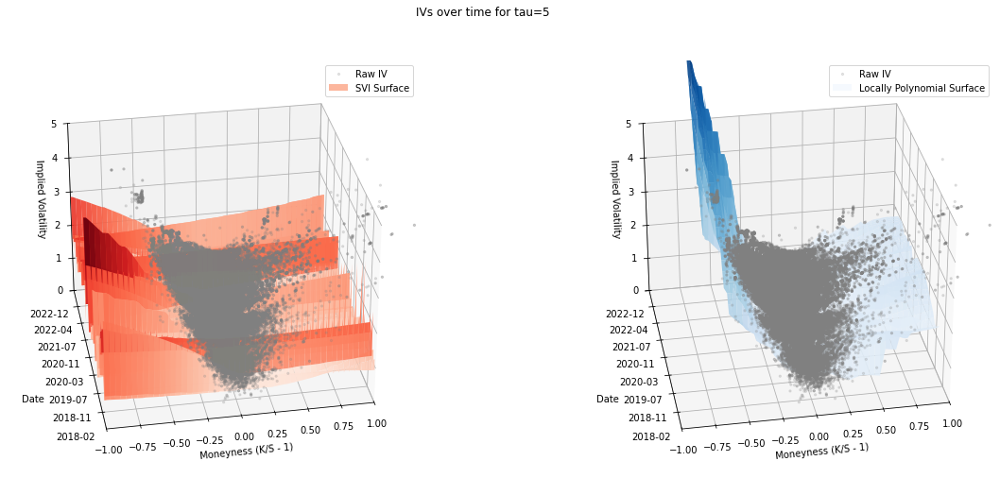

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['date'] = pd.to_datetime(df_filtered['date'])
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:94: UserWarning: set_ticklabels() should only be used 

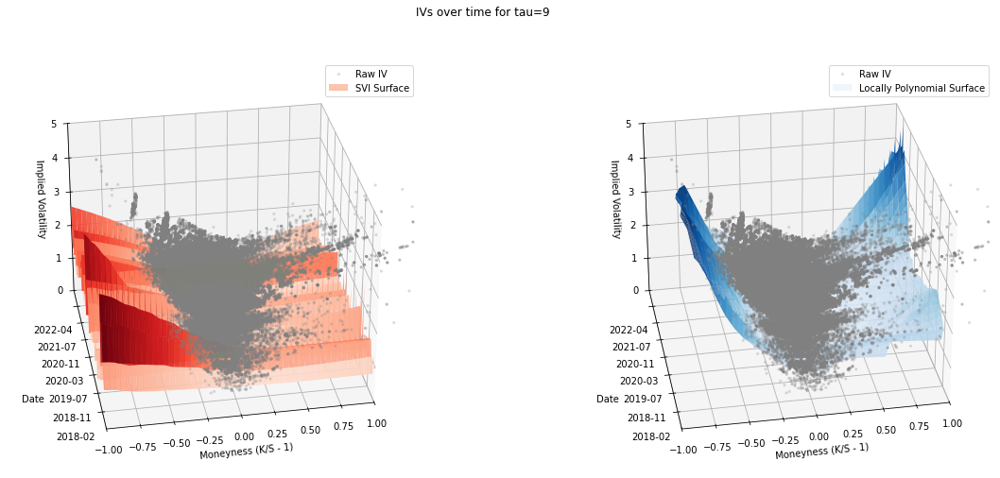

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['date'] = pd.to_datetime(df_filtered['date'])
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:94: UserWarning: set_ticklabels() should only be used 

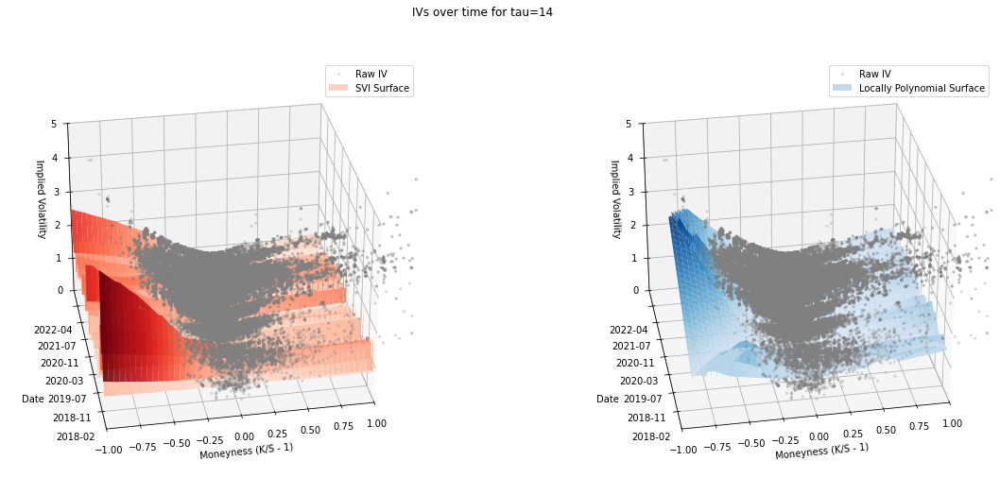

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['date'] = pd.to_datetime(df_filtered['date'])
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.IV = df_filtered.IV / 100  # Convert IV to percentage
/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/4162276264.py:94: UserWarning: set_ticklabels() should only be used 

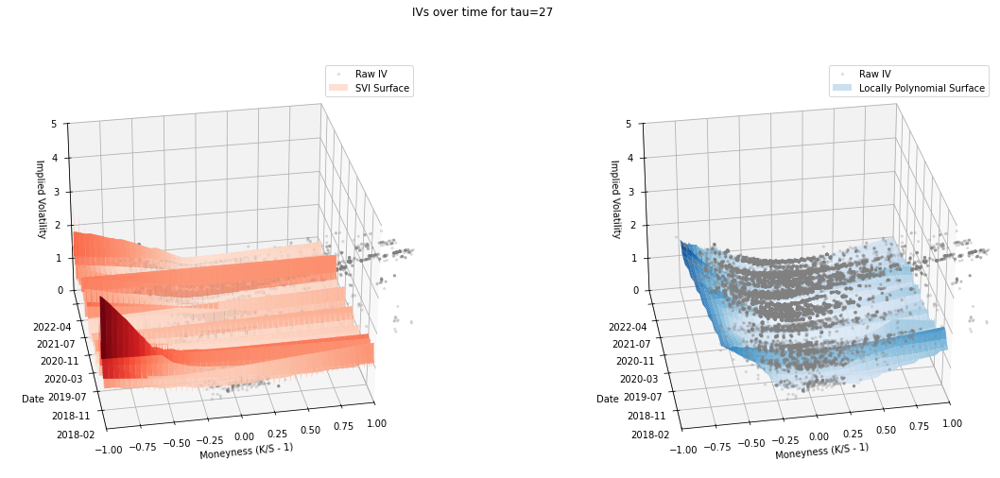

In [93]:
# SVI files list
svi_files = {
    5: "/Users/irtg/同步空间/Pricing_Kernel/EPK/matlab_code_for_BTC/SVI/IR0/moneyness/Interpolated_IV5_060.csv",
    9: "/Users/irtg/同步空间/Pricing_Kernel/EPK/matlab_code_for_BTC/SVI/IR0/moneyness/Interpolated_IV9_060.csv",
    14: "/Users/irtg/同步空间/Pricing_Kernel/EPK/matlab_code_for_BTC/SVI/IR0/moneyness/Interpolated_IV14_060.csv",
    27: "/Users/irtg/同步空间/Pricing_Kernel/EPK/matlab_code_for_BTC/SVI/IR0/moneyness/Interpolated_IV27_060.csv"
}

# Execute for each ttm
for tau in [5, 9, 14, 27]:
    plot_iv_against_date_and_moneyness(df, tau, svi_files, rookley_base_path="IV_Rookley")

In [114]:
import plotly.graph_objects as go
import pandas as pd
import numpy as np
import datetime
from scipy.interpolate import griddata
import os


def plot_iv_interactive(df, tau, svi_files, rookley_base_path):
    df_filtered = df[(df['tau'] == tau) & (df['tau'] >= 3) & (df['tau'] <= 60)]
    df_filtered['date'] = pd.to_datetime(df_filtered['date'])
    df_filtered['IV'] = df_filtered['IV'] / 100  # Convert IV to percentage

    if df_filtered.empty:
        print(f"No data available for tau={tau}.")
        return

    fig = go.Figure()

    # Add raw IV scatter points
    fig.add_trace(
        go.Scatter3d(
            x=df_filtered['moneyness'],
            y=df_filtered['date'].apply(lambda x: x.toordinal()),
            z=df_filtered['IV'],
            mode='markers',
            marker=dict(size=2, color='gray', opacity=0.5),
            name='Raw IV'
        )
    )

    # Prepare and add SVI surface
    svi_data = []
    if tau in svi_files.keys():
        file = svi_files[tau]
        svi_data = load_svi_iv_ttm(file)
    svi_data = np.vstack(svi_data) 

    if svi_data.size > 0:
        date_grid, mon_grid = np.mgrid[min(df_filtered['date']).toordinal():max(df_filtered['date']).toordinal():100j, -1:1:50j]
        svi_grid = griddata(svi_data[:, [1, 0]], svi_data[:, 2], (date_grid, mon_grid), method='linear')

        fig.add_trace(
            go.Surface(
                x=mon_grid,
                y=date_grid,
                z=svi_grid,
                colorscale='Reds',
                opacity=0.7,
                name='SVI Surface'
            )
        )

    print(f"df_filtered date max: {df_filtered['date'].apply(lambda x: x.toordinal()).max()}, min: {df_filtered['date'].apply(lambda x: x.toordinal()).min()}")
    print(f"date_grid max: {date_grid.max()}, min: {date_grid.min()}")
    # Prepare data for Rookley surface
    rookley_ivs = load_rookley_iv_ttm(rookley_base_path, tau)
    rookley_data = np.vstack([df.values for _, df in rookley_ivs]) if rookley_ivs else np.empty((0, 4))

    if rookley_data.size > 0:
        rookley_grid = griddata(rookley_data[:, [0, 3]], rookley_data[:, 1], (mon_grid, date_grid), method='linear')

        fig.add_trace(
            go.Surface(
                x=mon_grid,
                y=date_grid,
                z=rookley_grid,
                colorscale='Blues',
                opacity=0.7,
                name='Rookley Surface'
            )
        )

    # Update layout for better interactivity
    y_range = [df_filtered['date'].apply(lambda x: x.toordinal()).min(), 
               df_filtered['date'].apply(lambda x: x.toordinal()).max()]
    # Generate 10 evenly spaced tick values
    y_tickvals = np.floor(np.linspace(y_range[0], y_range[1], 10)).astype(int)  # 10 evenly spaced integers values between y_range[0] and y_range[end]
    # Convert the tickvals back to datetime for display as ticktext
    y_ticktext = [datetime.datetime.fromordinal(int(t)).strftime('%Y-%m') for t in y_tickvals]

    fig.update_layout(
        title=f'IVs over time for tau={tau}',
        margin=dict(l=0, r=0, b=0, t=40),
        scene=dict(
            xaxis=dict(title='Moneyness (K/S - 1)',
                        range=[-1, 1]),
            zaxis=dict(title='Implied Volatility',
                        range=[0, 5]),
            yaxis=dict(
                title='Date',
                tickvals=y_tickvals,
                ticktext=y_ticktext
            )
        )
    )

    # Save the figure as an HTML file
    save_dir = 'IV_comparison/moneyness/IV_raw_svi_rookley/html_plots'
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    path_to_save = os.path.join(save_dir, f'IV_surface_tau_{tau}.html')
    fig.write_html(path_to_save)
    print(f"Plot saved to {path_to_save}")


# Execute for each tau 
for tau in [5, 9, 14, 27]:
    plot_iv_interactive(df, tau, svi_files, rookley_base_path="IV_Rookley")


/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/1227527826.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/1227527826.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



df_filtered date max: 738500, min: 736533
date_grid max: 738500.0, min: 736533.0
Plot saved to IV_comparison/moneyness/IV_raw_svi_rookley/html_plots/IV_surface_tau_5.html


/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/1227527826.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/1227527826.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



df_filtered date max: 738496, min: 736529
date_grid max: 738496.0, min: 736529.0
Plot saved to IV_comparison/moneyness/IV_raw_svi_rookley/html_plots/IV_surface_tau_9.html


/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/1227527826.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/1227527826.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



df_filtered date max: 738491, min: 736524
date_grid max: 738491.0, min: 736524.0
Plot saved to IV_comparison/moneyness/IV_raw_svi_rookley/html_plots/IV_surface_tau_14.html


/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/1227527826.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/_7/3860x3293tn4h2dlrp5_t7_h0000gn/T/ipykernel_5997/1227527826.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



df_filtered date max: 738457, min: 736511
date_grid max: 738457.0, min: 736511.0
Plot saved to IV_comparison/moneyness/IV_raw_svi_rookley/html_plots/IV_surface_tau_27.html
